In [8]:
from bayes_opt import BayesianOptimization
from bayes_opt.util import UtilityFunction
import numpy as np

import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib import mlab
from matplotlib import gridspec
%matplotlib inline

In [9]:
#challenge import
from netsapi.challenge import *
 
from sys import exit, exc_info, argv
from multiprocessing import Pool, current_process
import random as rand
import json
import requests
import numpy as np
import pandas as pd


import statistics
from IPython.display import clear_output

from contextlib import contextmanager
import sys, os
@contextmanager
def suppress_stdout():
    with open(os.devnull, "w") as devnull:
        old_stdout = sys.stdout
        sys.stdout = devnull
        try:  
            yield
        finally:
            sys.stdout = old_stdout

import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline
print("done")

done


In [10]:
envSeqDec = ChallengeSeqDecEnvironment()
x_start = 0.0
x_end = 1.0

VAL_Max = 1.2 # fel heat map

def target1_y1(x, y):
    x = np.asscalar(x)
    y = np.asscalar(y)
    envSeqDec.reset()
    action = [x , y]
    print("action",action)
    s,r,d,_ = envSeqDec.evaluateAction(action)
    return r/90.0   

def target1_y2(x, y):
    x = np.asscalar(x)
    y = np.asscalar(y)
    envSeqDec.reset()
    action = [x , y]
    print("action",action)
    s,r,d,_ = envSeqDec.evaluateAction(action)
    return r/90.0    

def target(x,y,target1):
    if type(x) is np.ndarray:
        result = []
        for a,b in zip(x,y):
            reward = target1(a,b)
            result.append( reward )
            #print((len(result) % 30 ) )
            #if ((len(result) % 30 ) > 25) : 
            #    global envSeqDec
            #    envSeqDec = ChallengeSeqDecEnvironment()
        return result
    else:
        return target1(x,y)
    
    
def target_y1(x,y):
    target(x,y,target1_y1)
def target_y2(x,y):
    target(x,y,target1_y2)
    
    

In [11]:
# for the training
n = 1e5
x = y = np.linspace(x_start, x_end, 300)# was 300
X, Y = np.meshgrid(x, y)
x = X.ravel()
y = Y.ravel()
X = np.vstack([x, y]).T[:, [1, 0]]

In [12]:
def posterior(bo, X):
    #ur = unique_rows(bo.X)
    x_obs = np.array([[res["params"]["x"], res["params"]["y"]] for res in bo.res])
    y_obs = np.array([res["target"] for res in bo.res])
    #print("x_obs",x_obs)
    #print("y_obs",y_obs)
    
    bo._gp.fit(x_obs, y_obs)
    #print(bo._gp)
    
    mu, sigma = bo._gp.predict(X, return_std=True)
    #mu, sigma2 = bo._gp.predict(X[:2,:])
    #print("X[:2,:]",X[:2,:])
    #print("x_obs",x_obs)
    #mu, sigma2 = bo._gp.predict(x_obs)
    #print("mu",mu)
    #print("sigma2",sigma2)
    ##mu, sigma2 = bo._gp.predict(X) # eval_MSE=True
    
    #uf = UtilityFunction(kind='ucb', kappa=10, xi=1.0) # xi=1.0 zetha ena w 3andha 7ata ma3na
    
    #print("sqrt",np.sqrt(sigma2))
    
    #return mu, np.sqrt(sigma2), uf.utility(X, bo._gp, y_obs.max())
    return mu, sigma

def plot_2d(name=None):

    #mu, s, ut = posterior(bo, X)
    mu, s = posterior(bo, X)

    fig, ax = plt.subplots(2, 2, figsize=(14, 10))
    gridsize=150

    # fig.suptitle('Bayesian Optimization in Action', fontdict={'size':30})
    x_obs = np.array([[res["params"]["x"], res["params"]["y"]] for res in bo.res])
    # GP regression output
    ax[0][0].set_title('Gausian Process Predicted Mean', fontdict={'size':15})
    im00 = ax[0][0].hexbin(x, y, C=mu, gridsize=gridsize, cmap=cm.jet, bins=None, vmin=-VAL_Max, vmax=VAL_Max)
    ax[0][0].axis([x.min(), x.max(), y.min(), y.max()])
    #ax[0][0].plot(bo.X[:, 1], bo.X[:, 0], 'D', markersize=4, color='k', label='Observations')
    ax[0][0].plot(x_obs[:, 1], x_obs[:, 0], 'D', markersize=4, color='k', label='Observations')

    ax[0][1].set_title('Target Function', fontdict={'size':15})
    """
    im10 = ax[0][1].hexbin(x, y, C=z, gridsize=gridsize, cmap=cm.jet, bins=None, vmin=-VAL_Max, vmax=VAL_Max)
    ax[0][1].axis([x.min(), x.max(), y.min(), y.max()])
    #ax[0][1].plot(bo.X[:, 1], bo.X[:, 0], 'D', markersize=4, color='k')
    ax[0][1].plot(x_obs[:, 1], x_obs[:, 0], 'D', markersize=4, color='k')
    """

    ax[1][0].set_title('Gausian Process Variance', fontdict={'size':15})
    im01 = ax[1][0].hexbin(x, y, C=s, gridsize=gridsize, cmap=cm.jet, bins=None, vmin=0, vmax=1)
    ax[1][0].axis([x.min(), x.max(), y.min(), y.max()])

    ax[1][1].set_title('Acquisition Function', fontdict={'size':15})
    # acquisition func
    """
    im11 = ax[1][1].hexbin(x, y, C=ut, gridsize=gridsize, cmap=cm.jet, bins=None, vmin=0, vmax=8)

    np.where(ut.reshape((300, 300)) == ut.max())[0]
    np.where(ut.reshape((300, 300)) == ut.max())[1]

    ax[1][1].plot([np.where(ut.reshape((300, 300)) == ut.max())[1]/50., 
                   np.where(ut.reshape((300, 300)) == ut.max())[1]/50.], 
                  [0, 6], 
                  'k-', lw=2, color='k')

    ax[1][1].plot([0, 6],
                  [np.where(ut.reshape((300, 300)) == ut.max())[0]/50., 
                   np.where(ut.reshape((300, 300)) == ut.max())[0]/50.], 
                  'k-', lw=2, color='k')

    ax[1][1].axis([x.min(), x.max(), y.min(), y.max()])
    """
    for im, axis in zip([im00, im01], ax.flatten()):#, im10, im11
        cb = fig.colorbar(im, ax=axis)
        # cb.set_label('Value')

    if name is None:
        name = '_'

    plt.tight_layout()

    # Save or show figure?
    # fig.savefig('bo_eg_' + name + '.png')
    plt.show()
    plt.close(fig)


|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.4542615359302641, 0.30796562611753886]
105  Evaluations Remaining
|  1        |  0.01503  |  0.4543   |  0.308    |
action [0.4897149053899318, 0.5853977309005819]
104  Evaluations Remaining
|  2        |  0.02087  |  0.4897   |  0.5854   |
action [0.29522565616159613, 0.18319086623906022]
103  Evaluations Remaining
|  3        | -0.9538   |  0.2952   |  0.1832   |
action [0.8357192691528105, 0.43625739487779536]
102  Evaluations Remaining
|  4        |  0.2619   |  0.8357   |  0.4363   |
action [0.6400414484666269, 0.740470554043976]
101  Evaluations Remaining
|  5        |  0.4294   |  0.64     |  0.7405   |


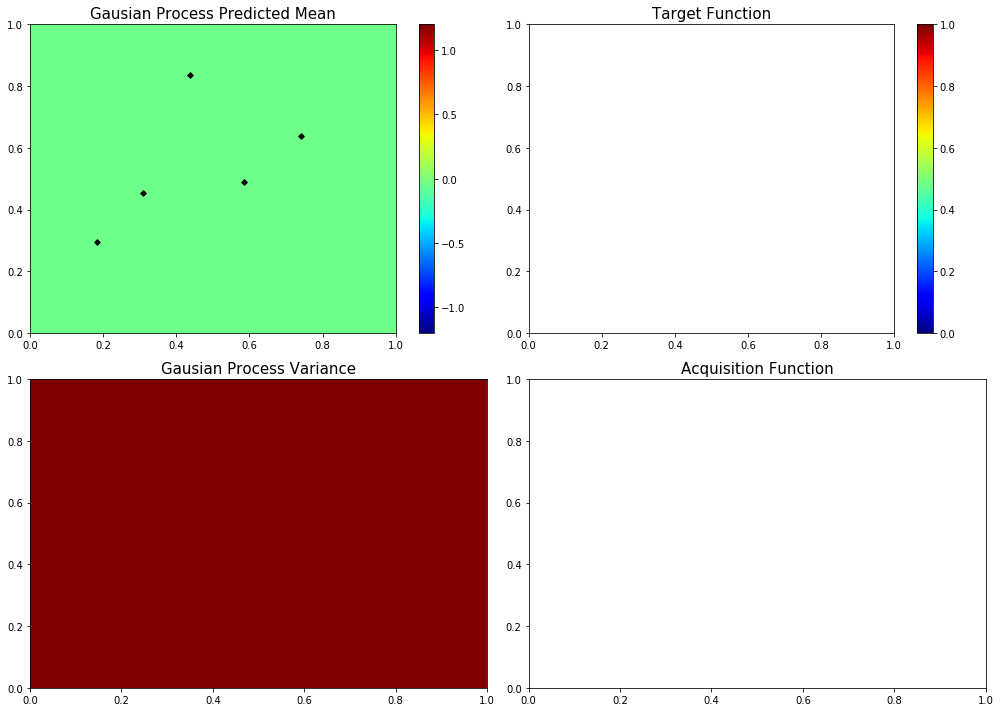

In [13]:
bo = BayesianOptimization(target_y1, {'x': (x_start, x_end), 'y': (x_start, x_end)})

used_kappa = 5

bo.maximize(init_points=5, n_iter=0, acq='ucb', kappa=used_kappa)

plot_2d()

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 1.0]
100  Evaluations Remaining
|  6        |  1.193    |  0.0      |  1.0      |
myplot:  006


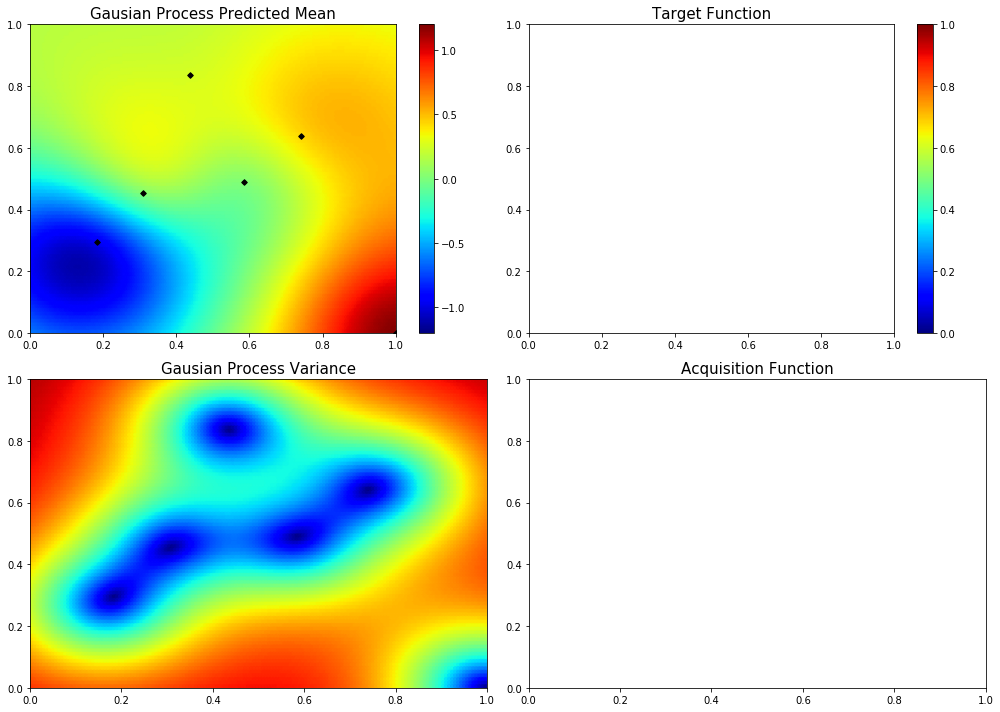

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 1.0]
99  Evaluations Remaining
|  7        |  0.1713   |  1.0      |  1.0      |
myplot:  007


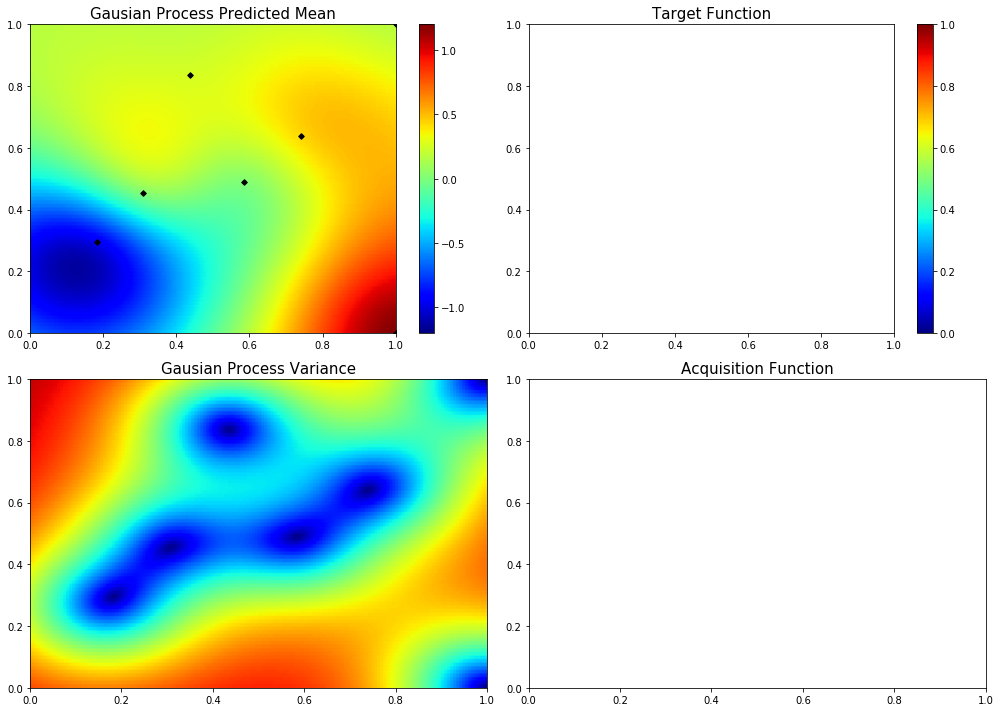

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.0]
98  Evaluations Remaining
|  8        |  1.073    |  1.0      |  0.0      |
myplot:  008


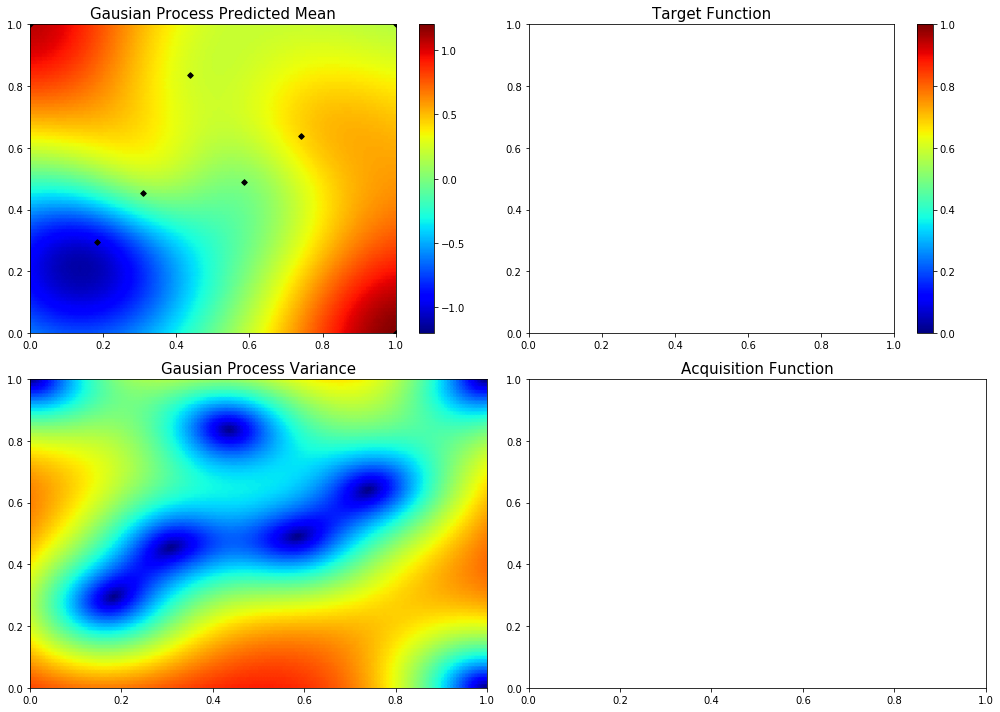

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.370897467461388, 1.0]
97  Evaluations Remaining
|  9        |  0.5953   |  0.3709   |  1.0      |
myplot:  009


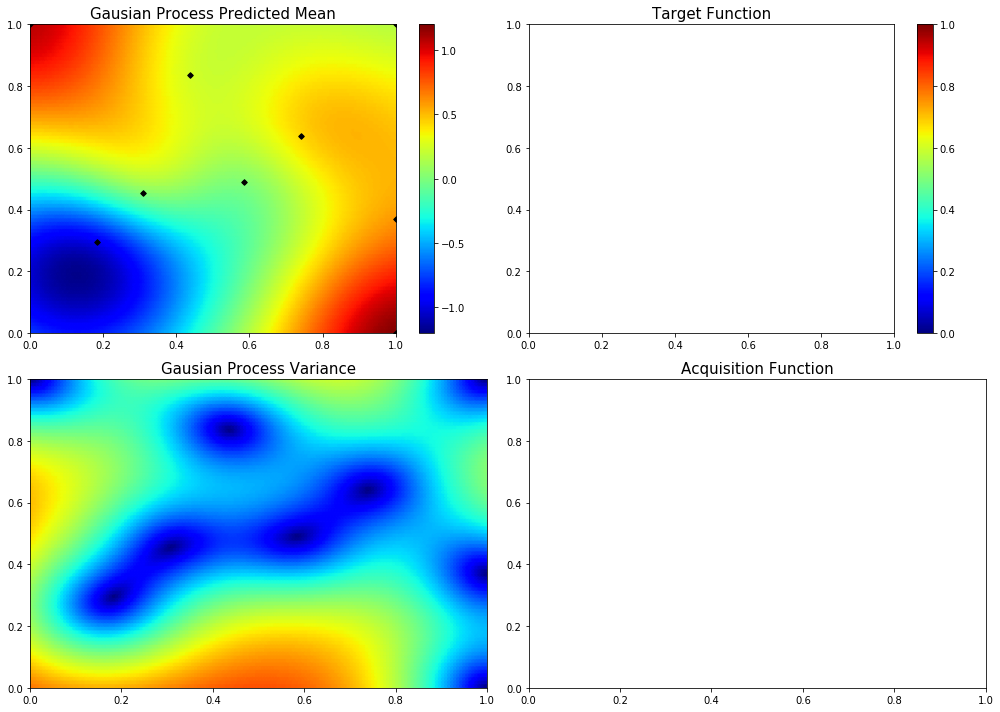

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.6276864073776678]
96  Evaluations Remaining
|  10       |  0.435    |  0.0      |  0.6277   |
myplot:  010


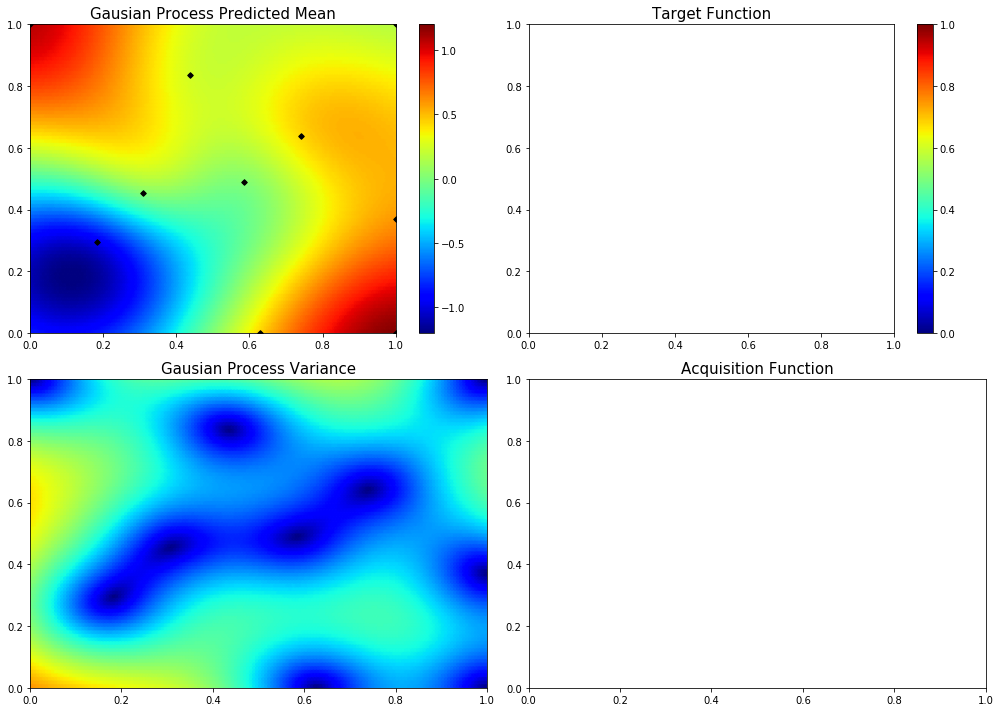

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.682713903579914, 0.0]
95  Evaluations Remaining
|  11       |  0.5115   |  0.6827   |  0.0      |
myplot:  011


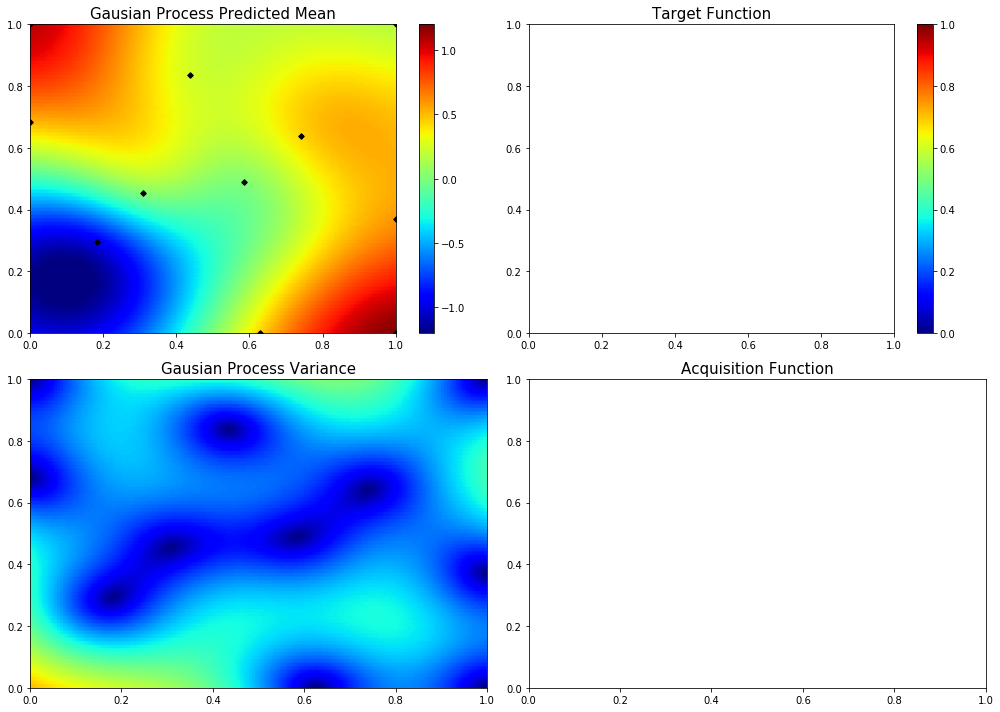

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.6756927305284393]
94  Evaluations Remaining
|  12       | -0.1111   |  1.0      |  0.6757   |
myplot:  012


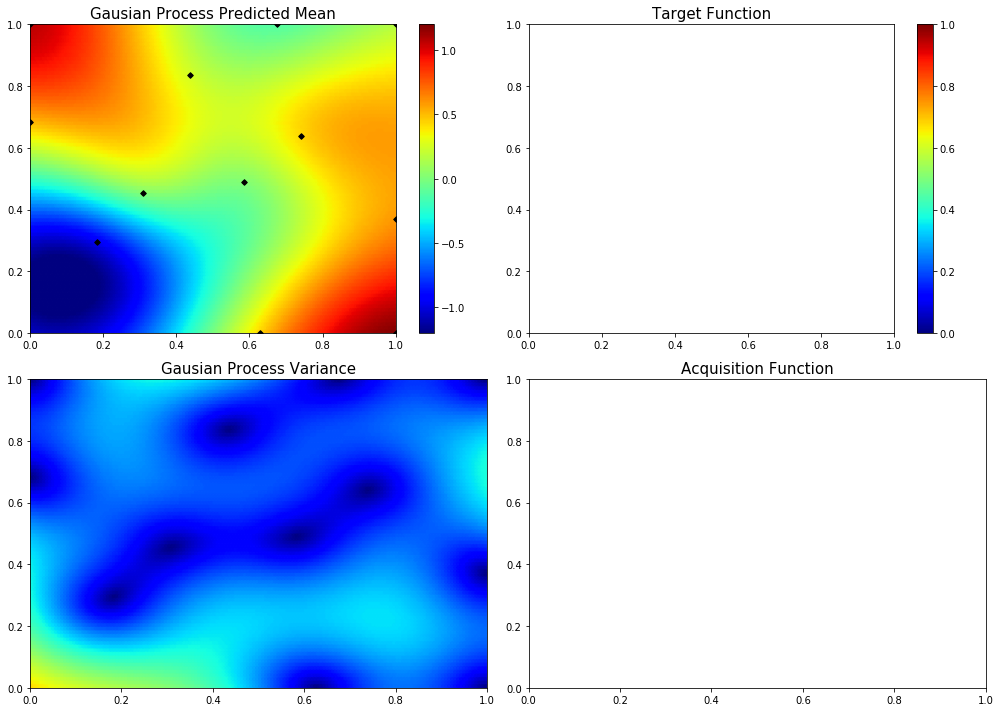

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6876622657546948, 1.0]
93  Evaluations Remaining
|  13       |  0.134    |  0.6877   |  1.0      |
myplot:  013


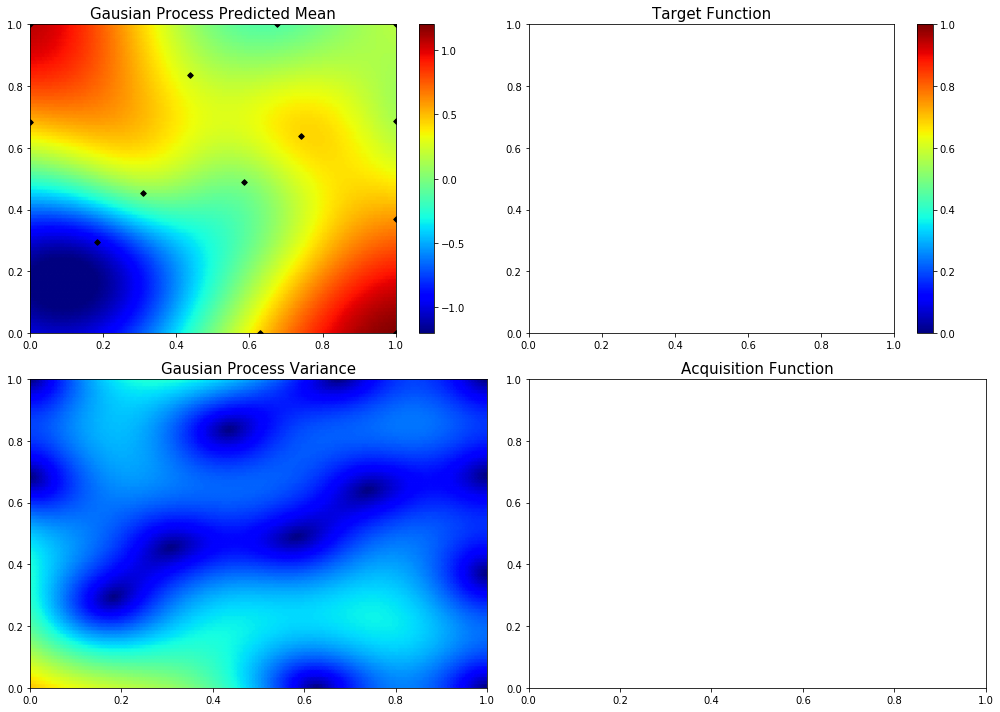

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.2200119250745475]
92  Evaluations Remaining
|  14       |  0.1685   |  1.0      |  0.22     |
myplot:  014


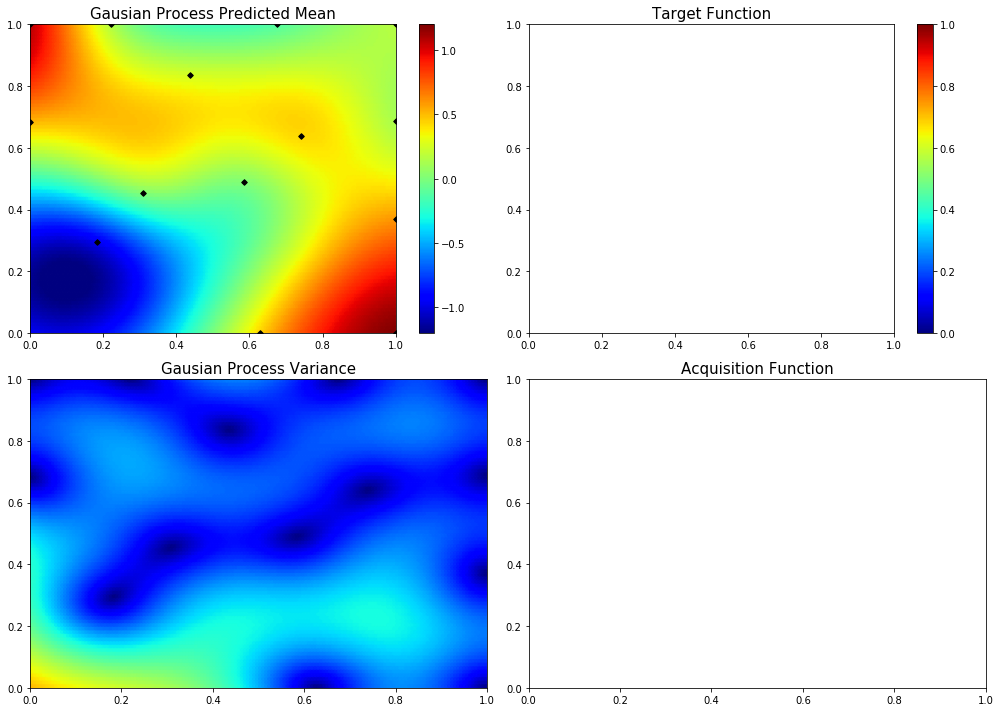

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.0]
91  Evaluations Remaining
|  15       |  0.03216  |  0.0      |  0.0      |
myplot:  015


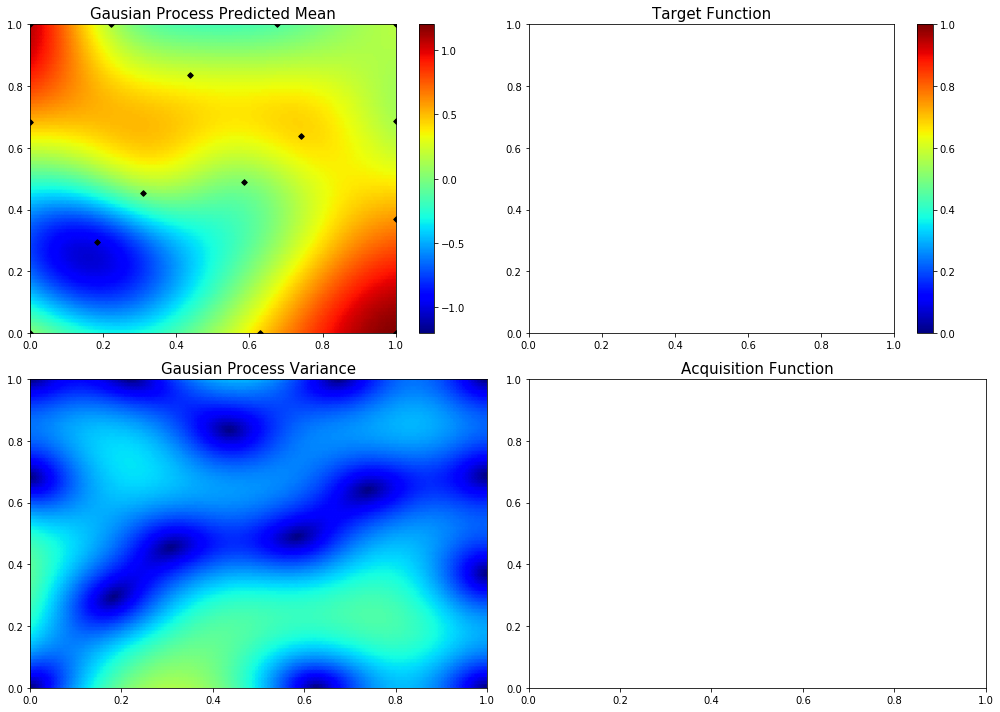

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.16571614730736284, 0.8345847332465539]
90  Evaluations Remaining
|  16       |  0.4604   |  0.1657   |  0.8346   |
myplot:  016


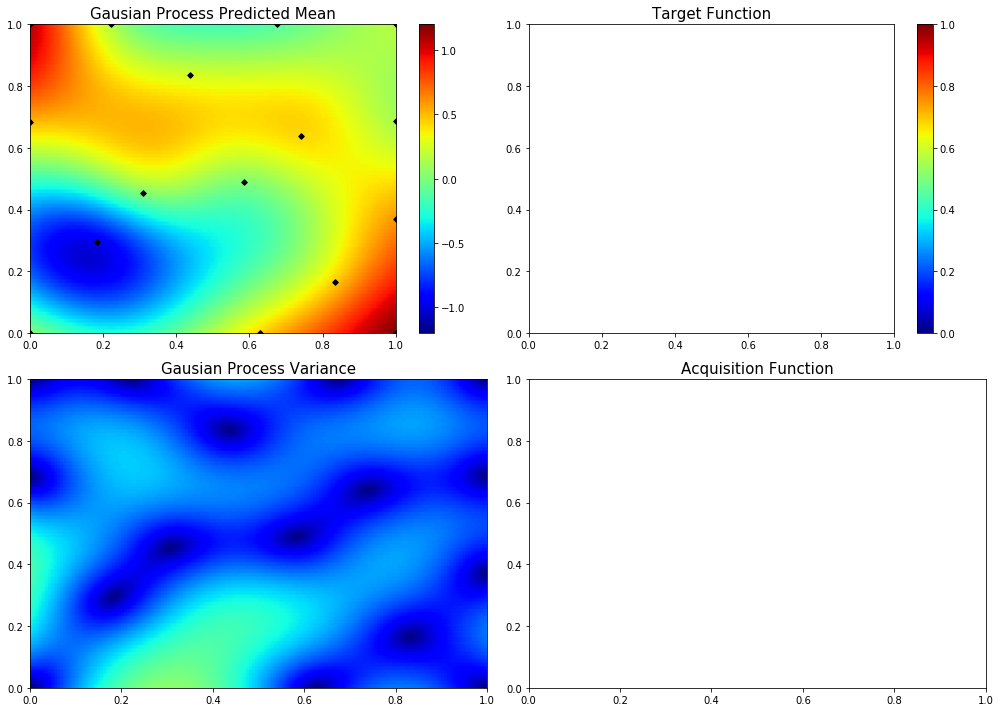

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.33278195051609727]
89  Evaluations Remaining
|  17       |  0.1321   |  0.0      |  0.3328   |
myplot:  017


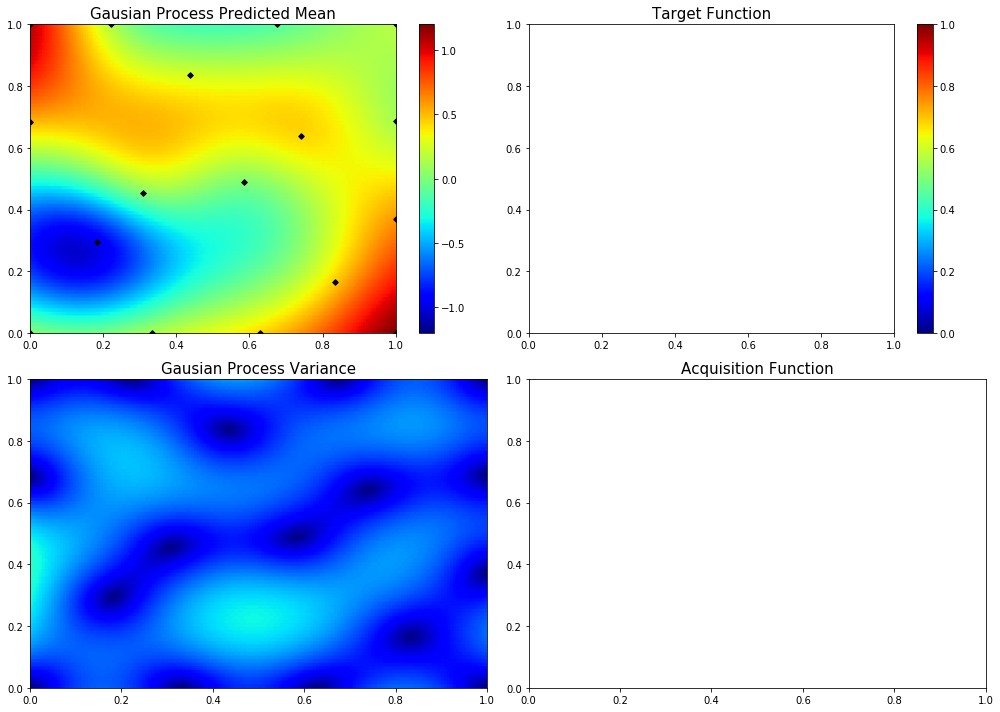

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.733490251985795, 0.20821312599841277]
88  Evaluations Remaining
|  18       |  0.4671   |  0.7335   |  0.2082   |
myplot:  018


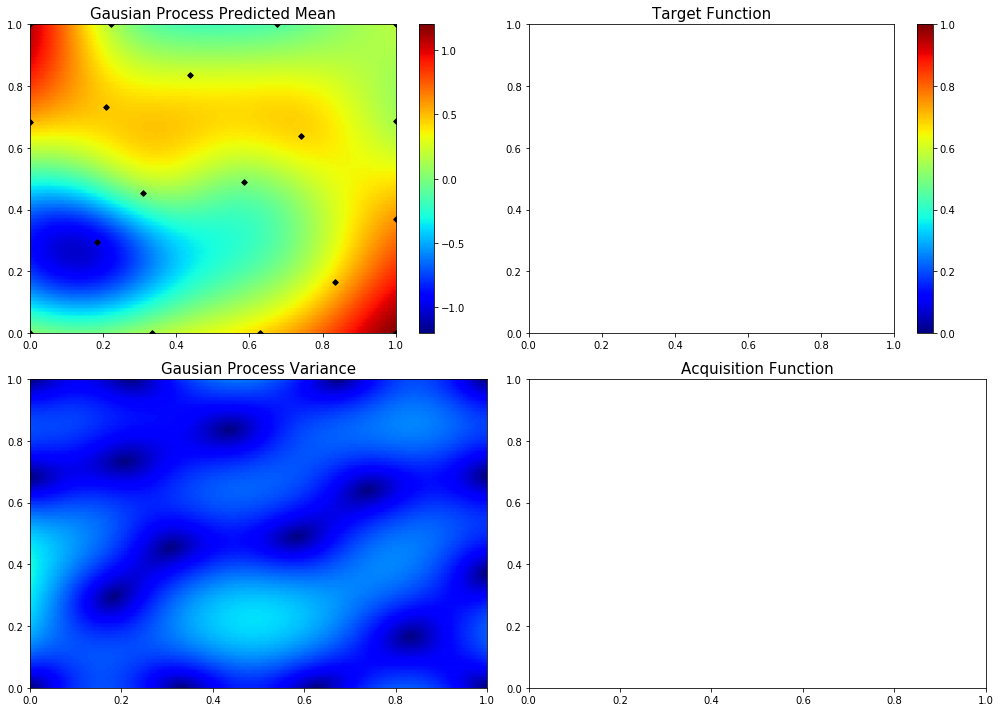

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.15211796824886542, 1.0]
87  Evaluations Remaining
|  19       |  0.7923   |  0.1521   |  1.0      |
myplot:  019


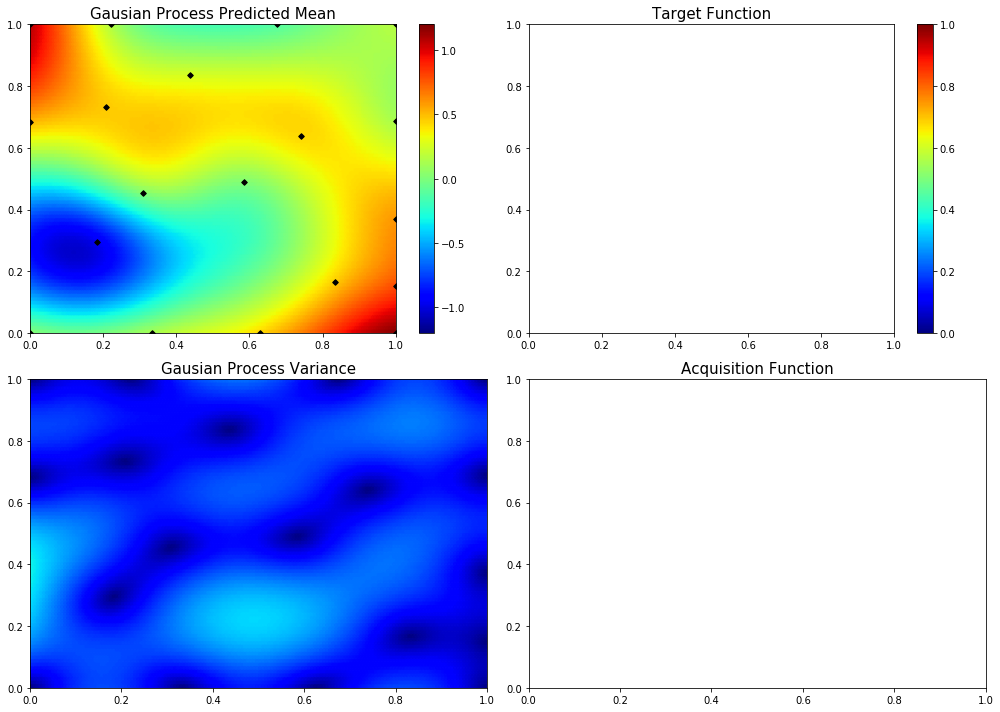

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8639401794933124, 0.0]
86  Evaluations Remaining
|  20       |  0.8558   |  0.8639   |  0.0      |
myplot:  020


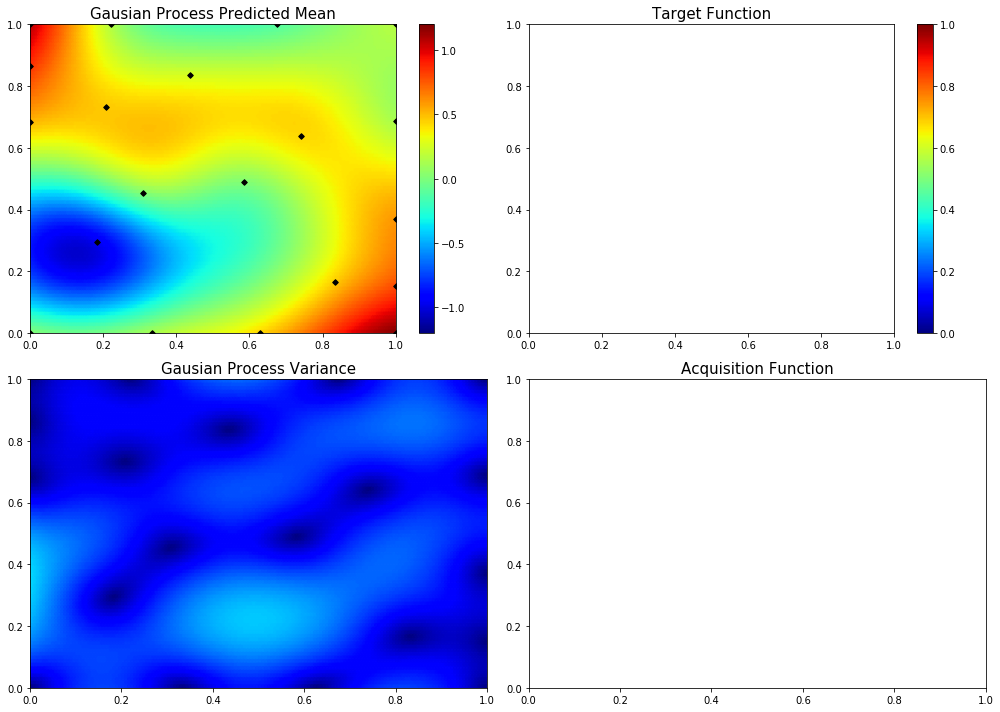

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.8603632407030033]
85  Evaluations Remaining
|  21       |  0.9871   |  0.0      |  0.8604   |
myplot:  021


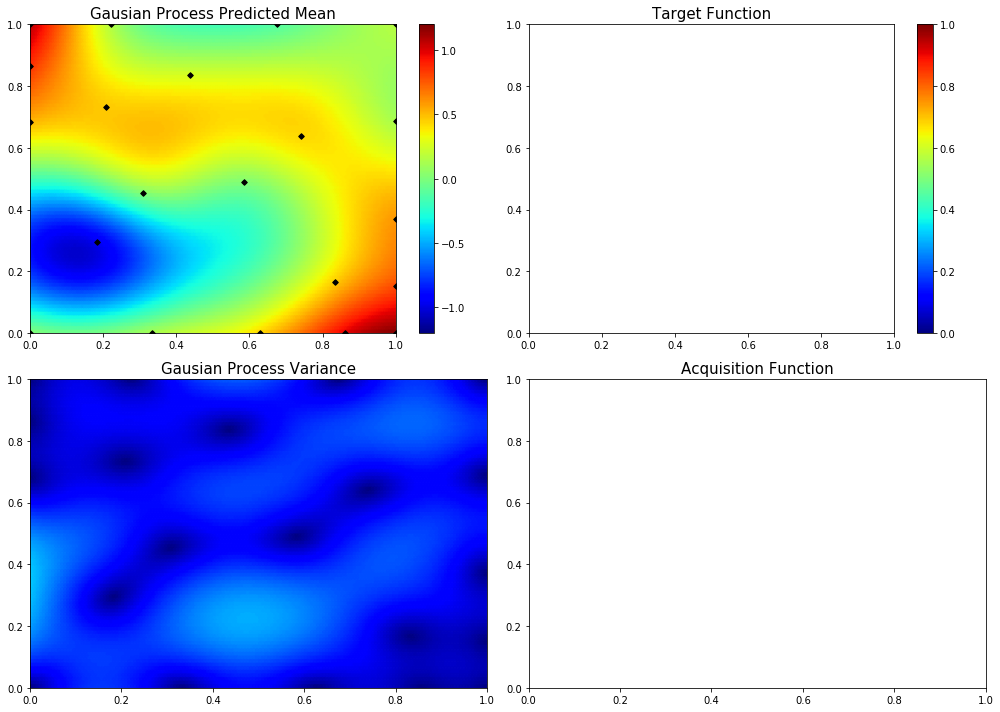

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6479296161481889, 0.4343388152824401]
84  Evaluations Remaining
|  22       |  0.06656  |  0.6479   |  0.4343   |
myplot:  022


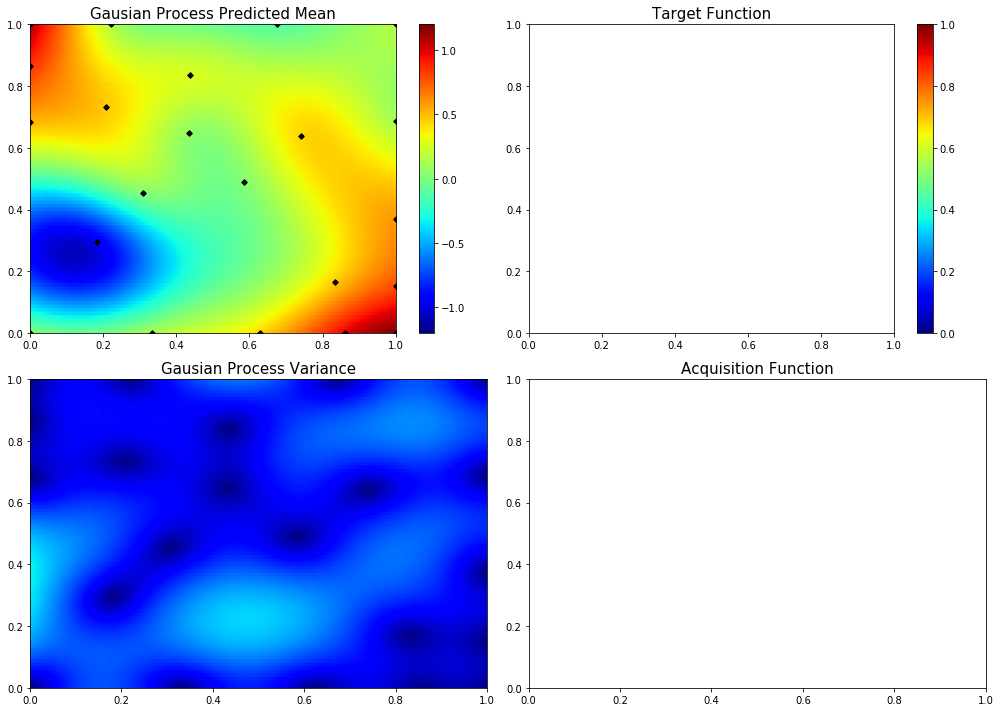

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.4622914822758985, 0.8393803462972943]
83  Evaluations Remaining
|  23       |  0.1007   |  0.4623   |  0.8394   |
myplot:  023


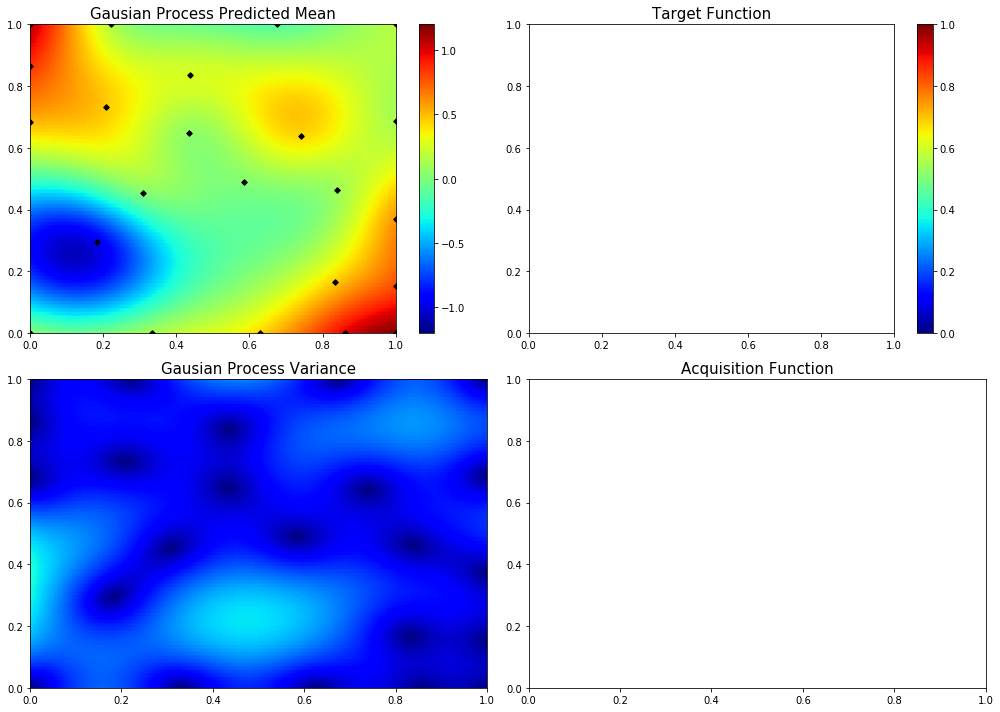

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.2103995140880993, 0.5121289954110079]
82  Evaluations Remaining
|  24       |  0.1781   |  0.2104   |  0.5121   |
myplot:  024


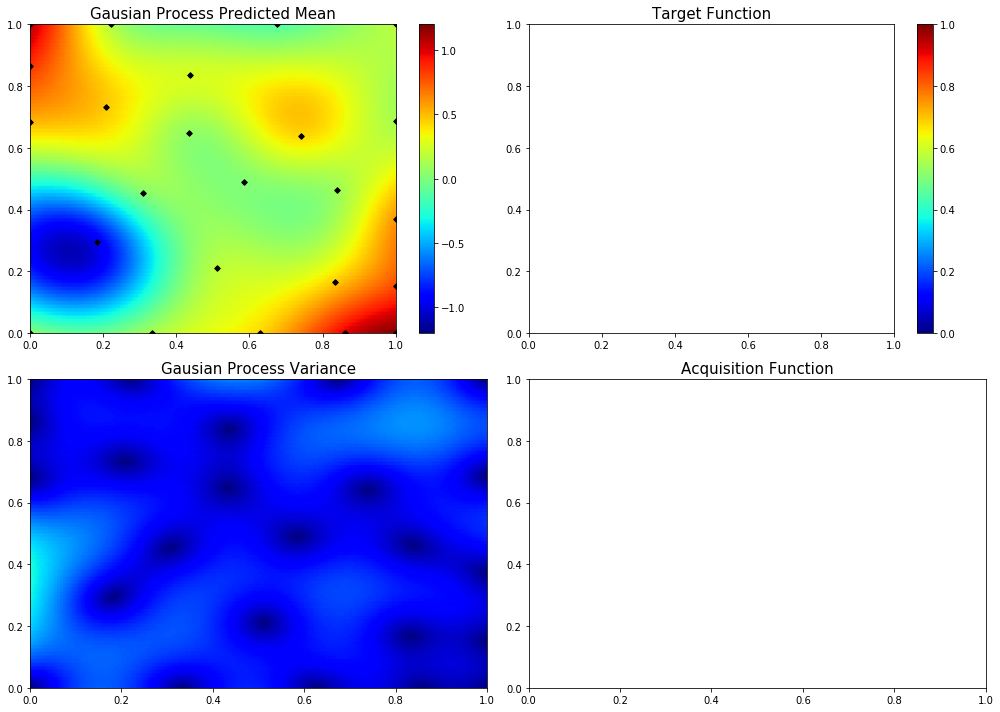

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8323033620258885, 0.8180629548478103]
81  Evaluations Remaining
|  25       | -0.2975   |  0.8323   |  0.8181   |
myplot:  025


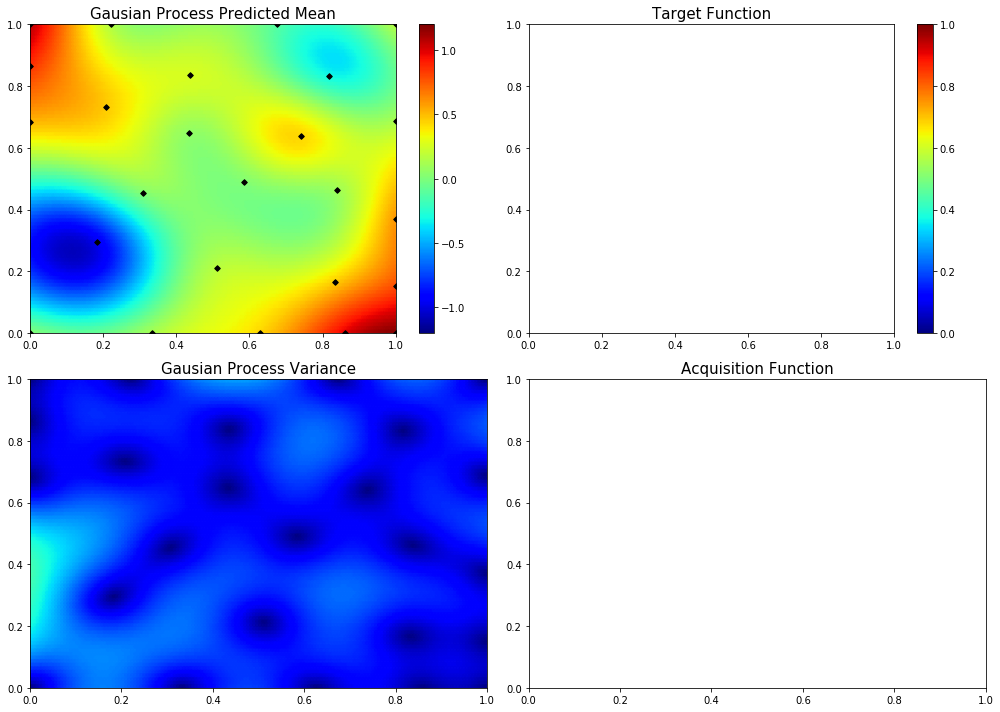

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.46602771431924556, 0.0]
80  Evaluations Remaining
|  26       |  0.2318   |  0.466    |  0.0      |
myplot:  026


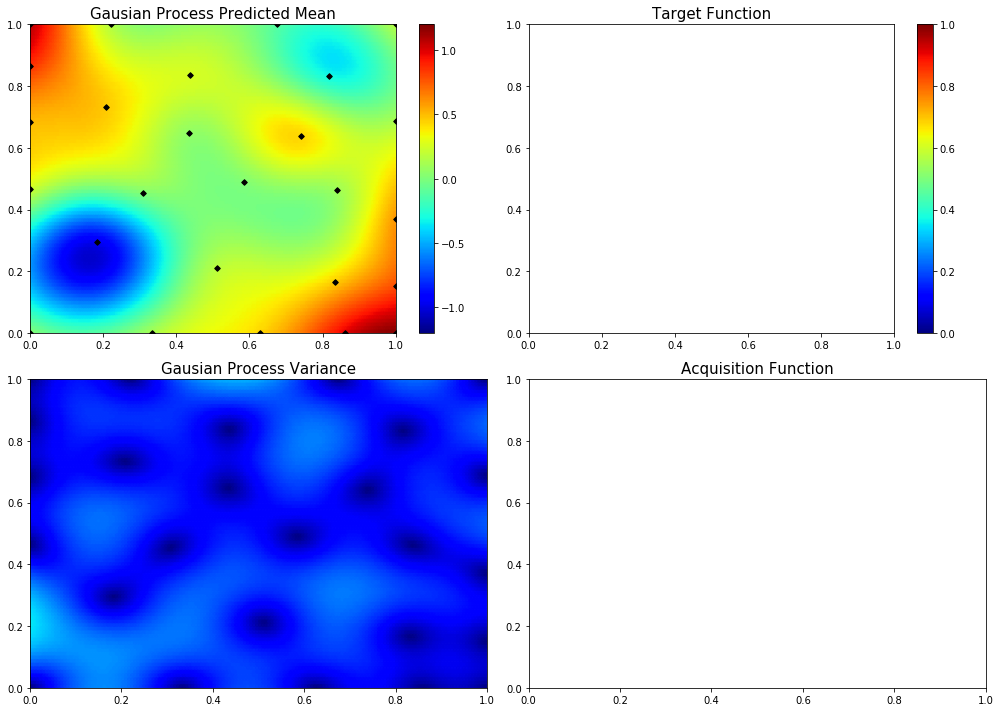

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.454851596401785]
79  Evaluations Remaining
|  27       |  0.6474   |  1.0      |  0.4549   |
myplot:  027


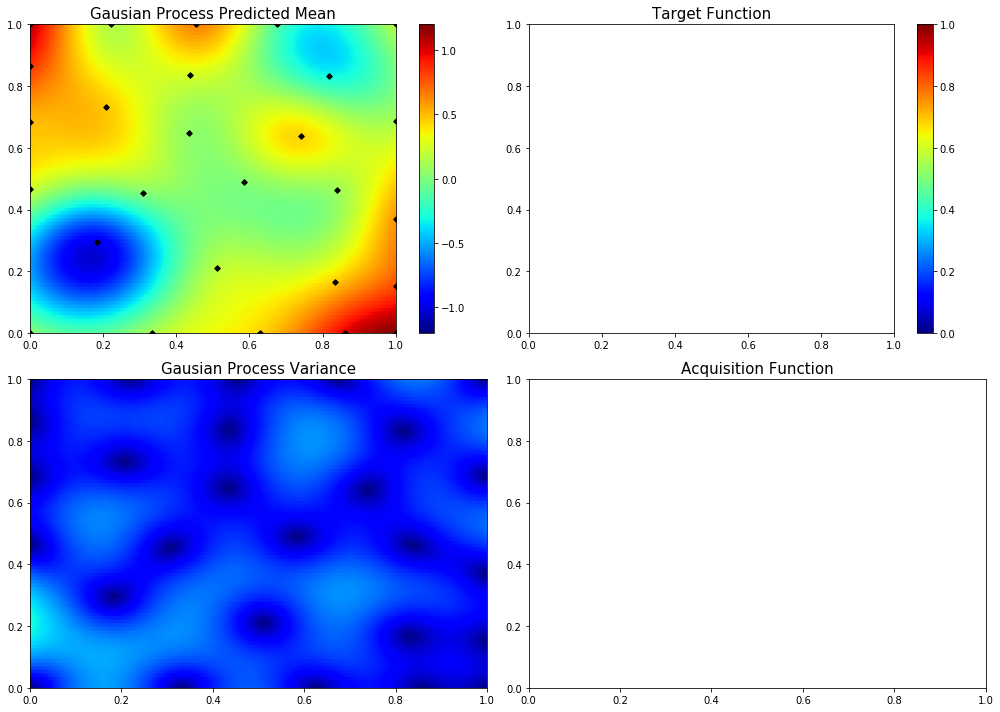

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5754504326230233, 0.14846880937876705]
78  Evaluations Remaining
|  28       |  0.6549   |  0.5755   |  0.1485   |
myplot:  028


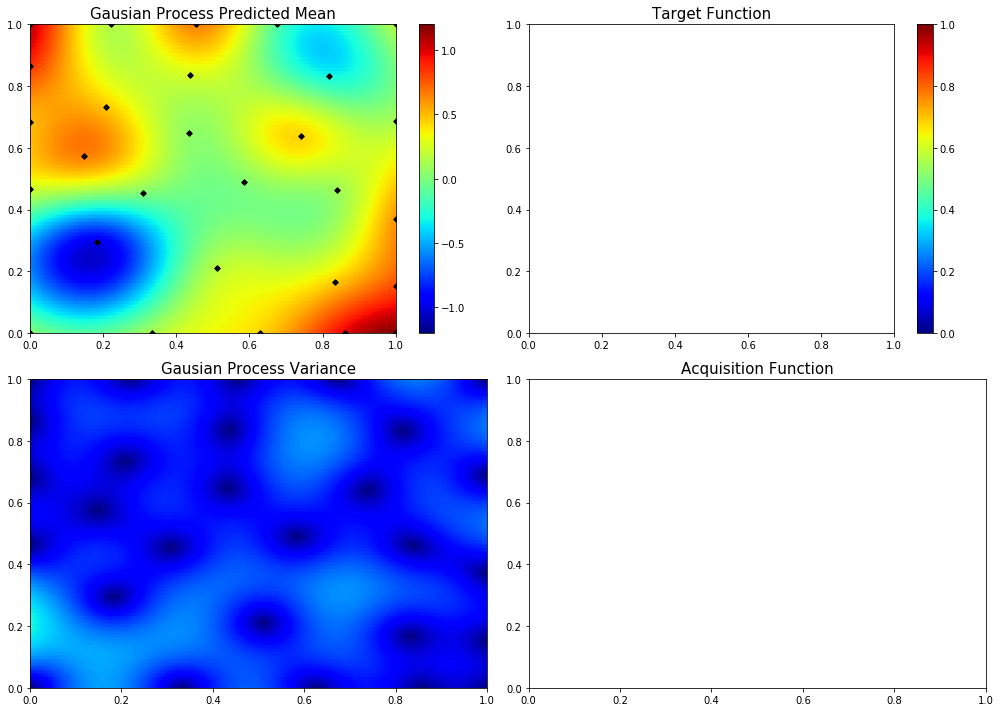

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5204877581939896, 1.0]
77  Evaluations Remaining
|  29       |  0.2877   |  0.5205   |  1.0      |
myplot:  029


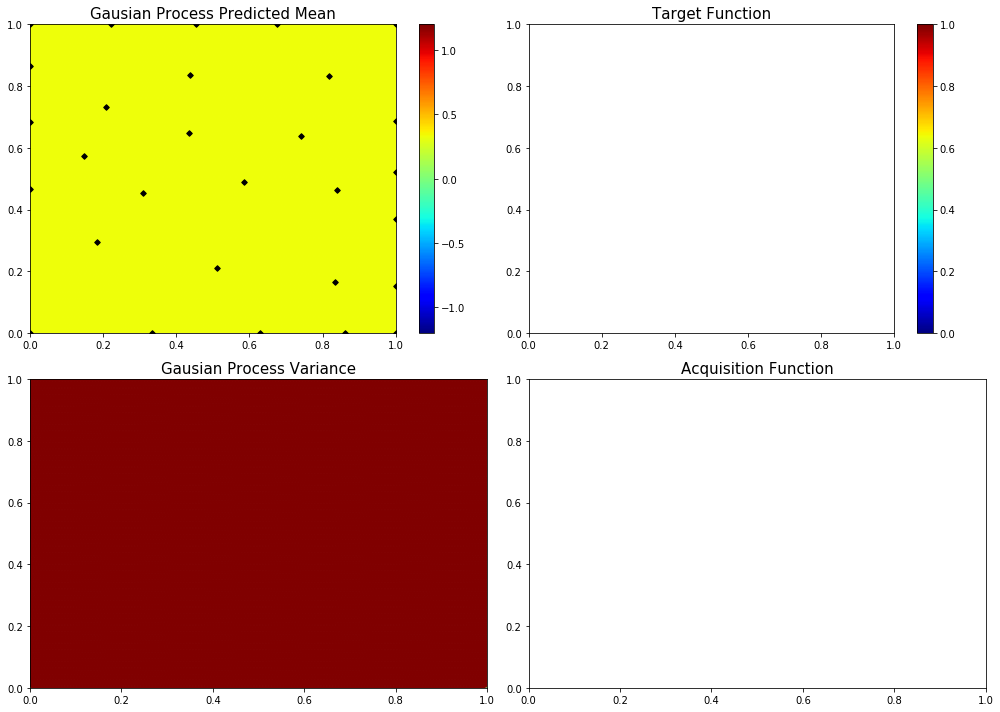

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.04345966138168571, 0.9438216788280016]
76  Evaluations Remaining
|  30       |  1.016    |  0.04346  |  0.9438   |
myplot:  030


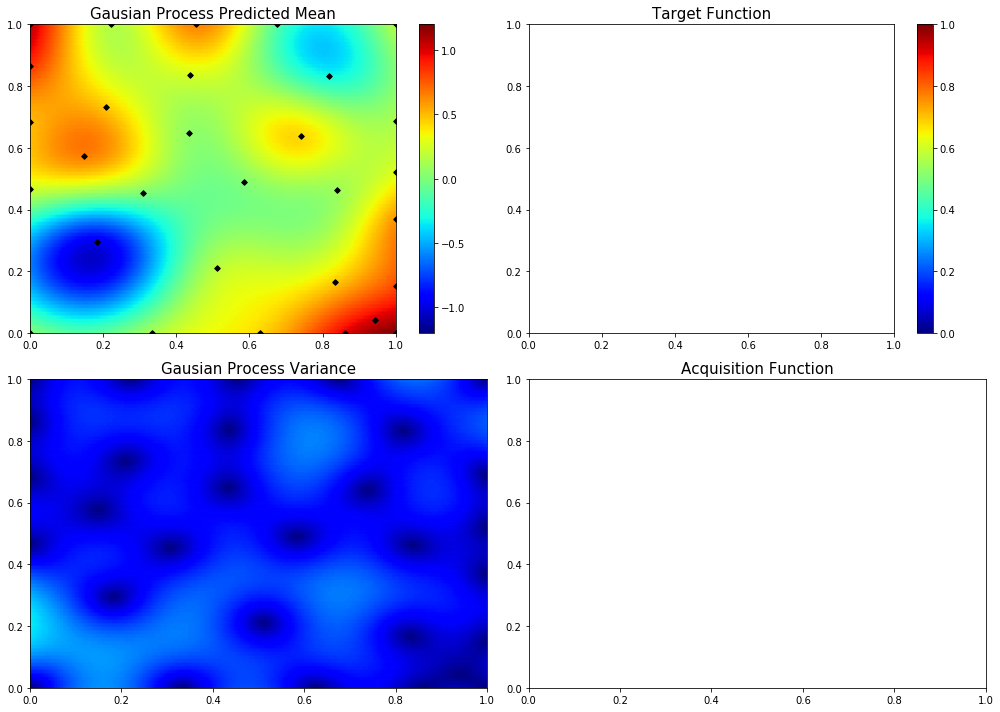

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.01170242573515973, 0.9848564334963721]
75  Evaluations Remaining
|  31       |  1.021    |  0.0117   |  0.9849   |
myplot:  031


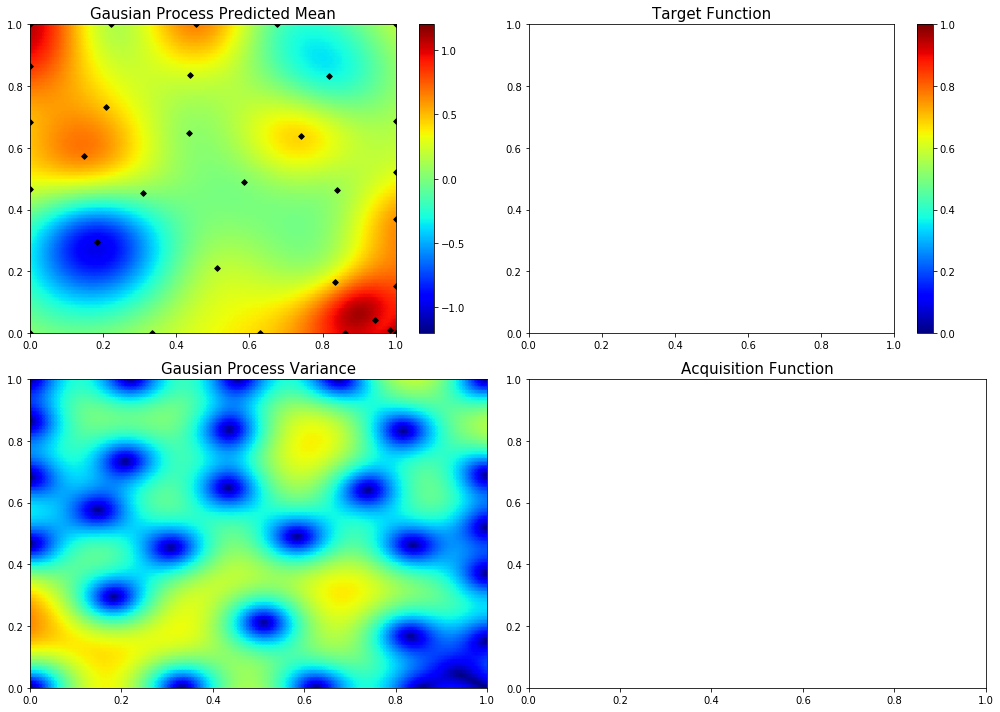

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.2095829738176321, 0.0]
74  Evaluations Remaining
|  32       |  0.03067  |  0.2096   |  0.0      |
myplot:  032


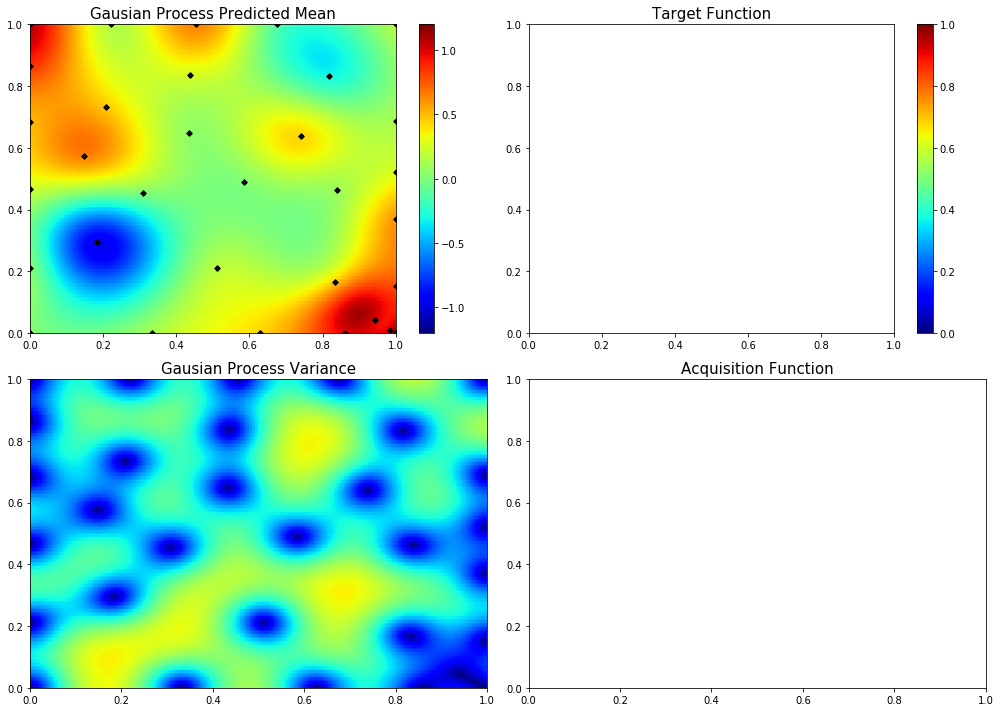

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7762248028374423, 0.6106167785750974]
73  Evaluations Remaining
|  33       |  0.03487  |  0.7762   |  0.6106   |
myplot:  033


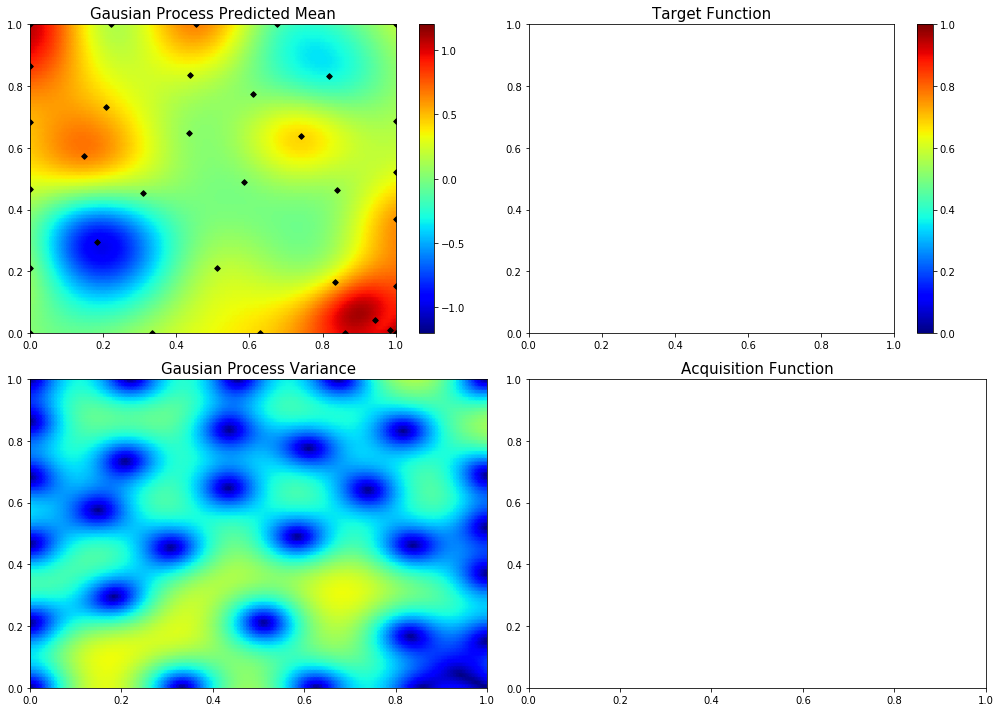

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.30037550405093627, 0.6785556176531178]
72  Evaluations Remaining
|  34       | -0.1996   |  0.3004   |  0.6786   |
myplot:  034


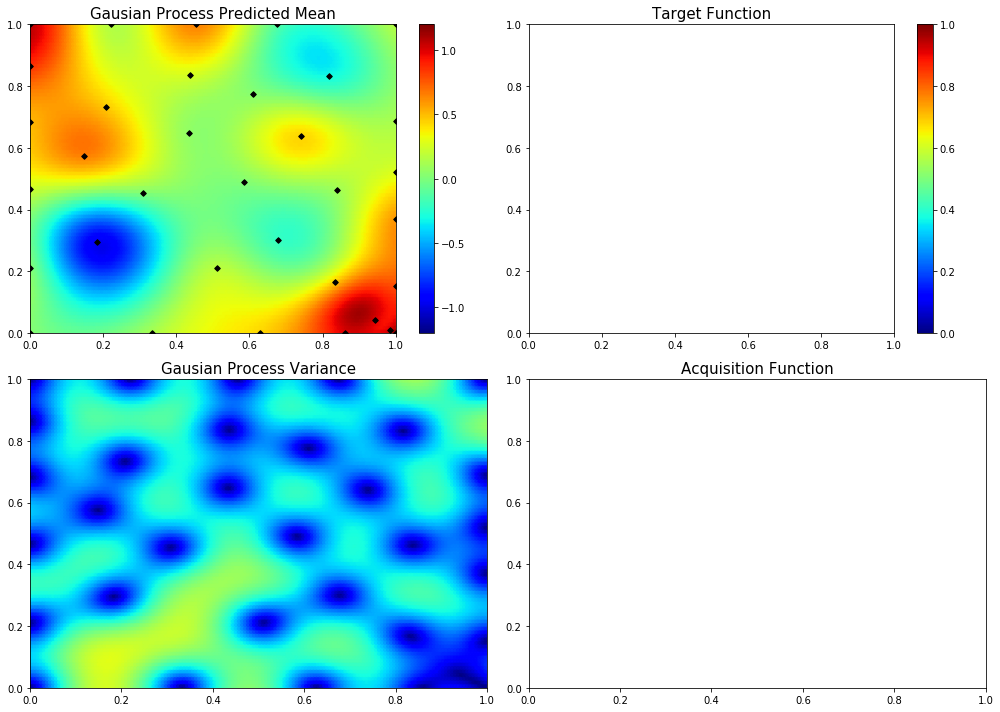

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.1661083600360478]
71  Evaluations Remaining
|  35       |  0.5793   |  0.0      |  0.1661   |
myplot:  035


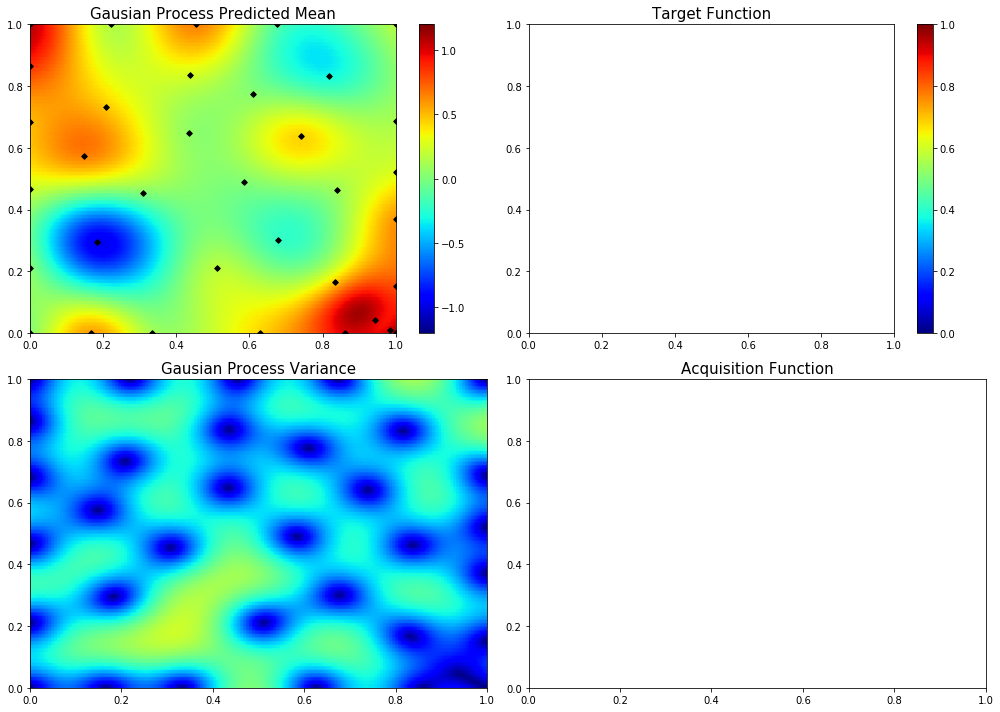

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8795827722324457, 0.12396676970674868]
70  Evaluations Remaining
|  36       | -0.04031  |  0.8796   |  0.124    |
myplot:  036


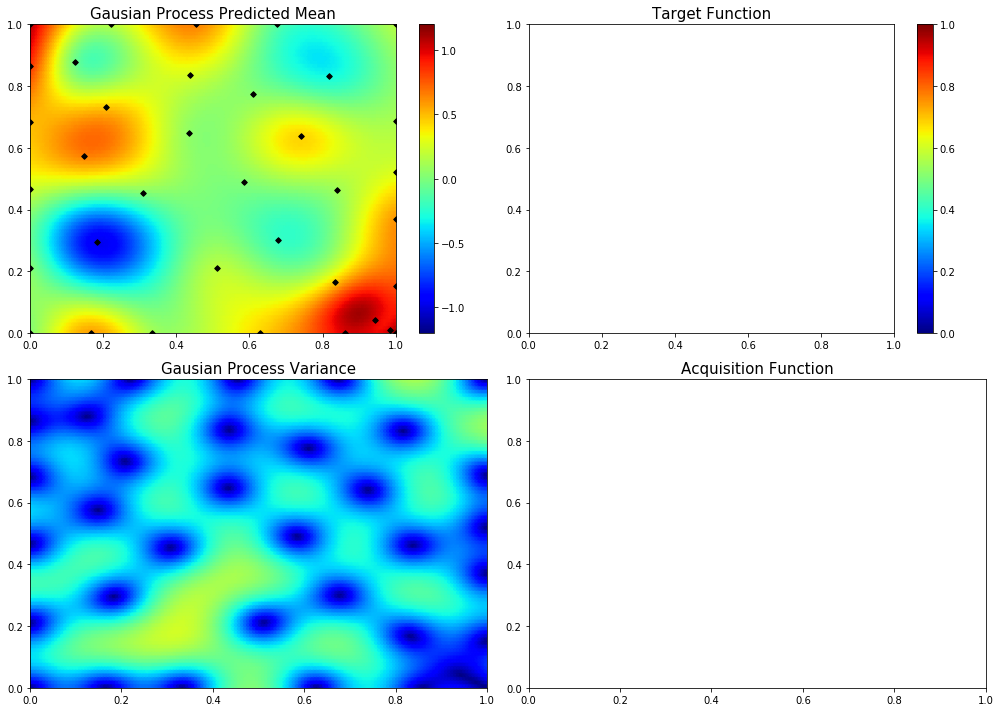

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.16710491450018305, 0.33856534687420525]
69  Evaluations Remaining
|  37       |  0.03697  |  0.1671   |  0.3386   |
myplot:  037


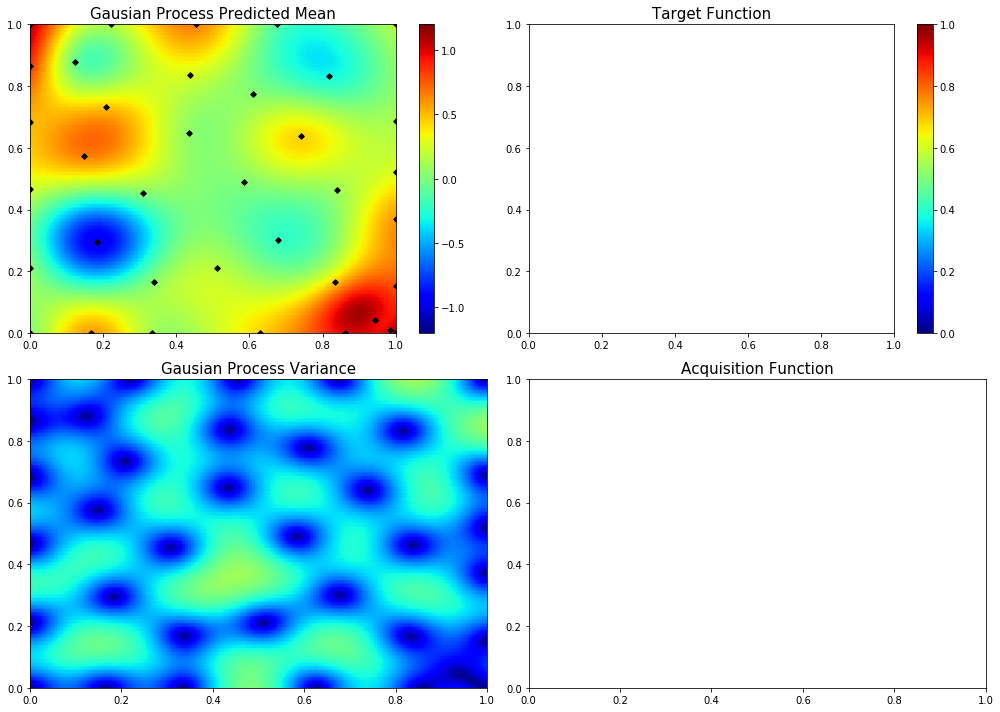

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.36262917008084045, 0.45428902236868596]
68  Evaluations Remaining
|  38       |  0.3892   |  0.3626   |  0.4543   |
myplot:  038


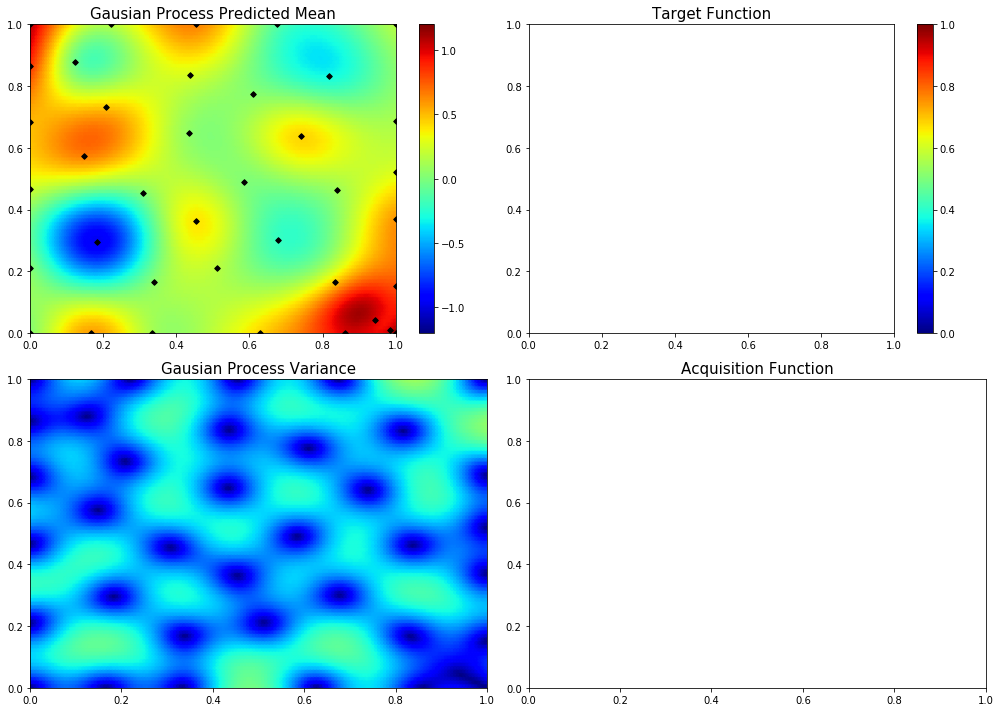

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8500738076456157, 1.0]
67  Evaluations Remaining
|  39       |  0.08776  |  0.8501   |  1.0      |
myplot:  039


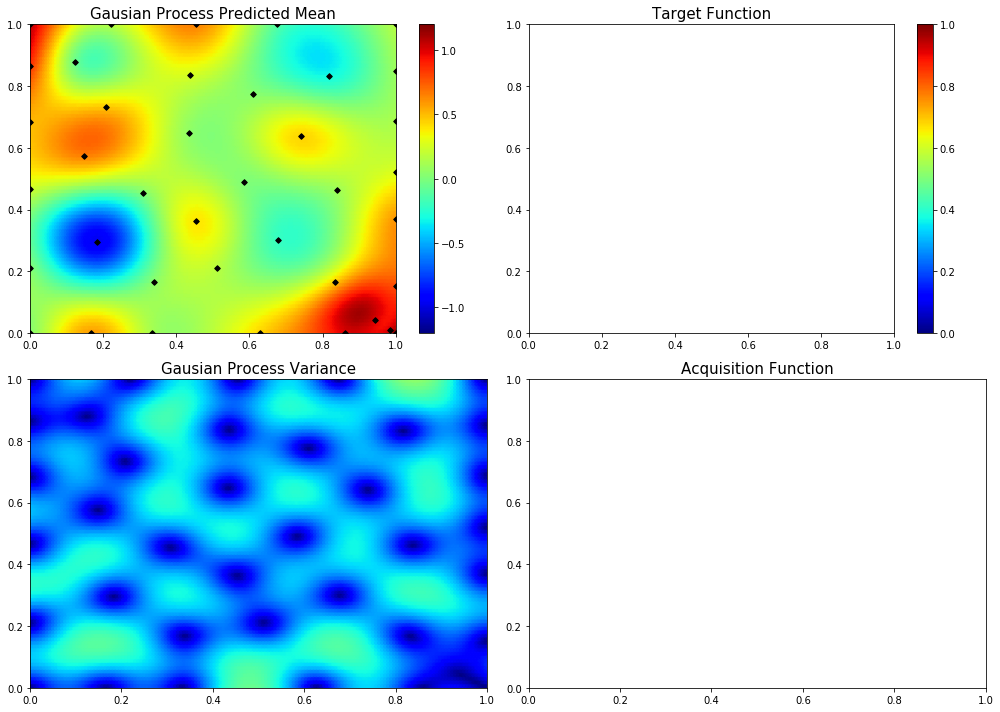

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.4885405584876927]
66  Evaluations Remaining
|  40       |  0.3112   |  0.0      |  0.4885   |
myplot:  040


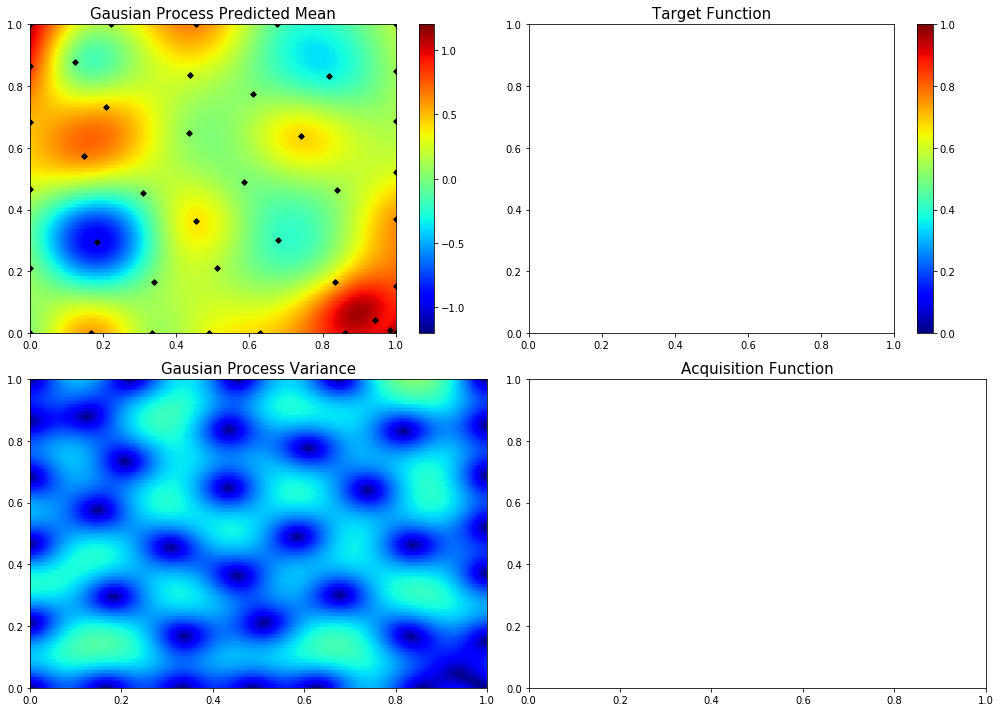

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6167679730180934, 0.28249915421008753]
65  Evaluations Remaining
|  41       |  0.1998   |  0.6168   |  0.2825   |
myplot:  041


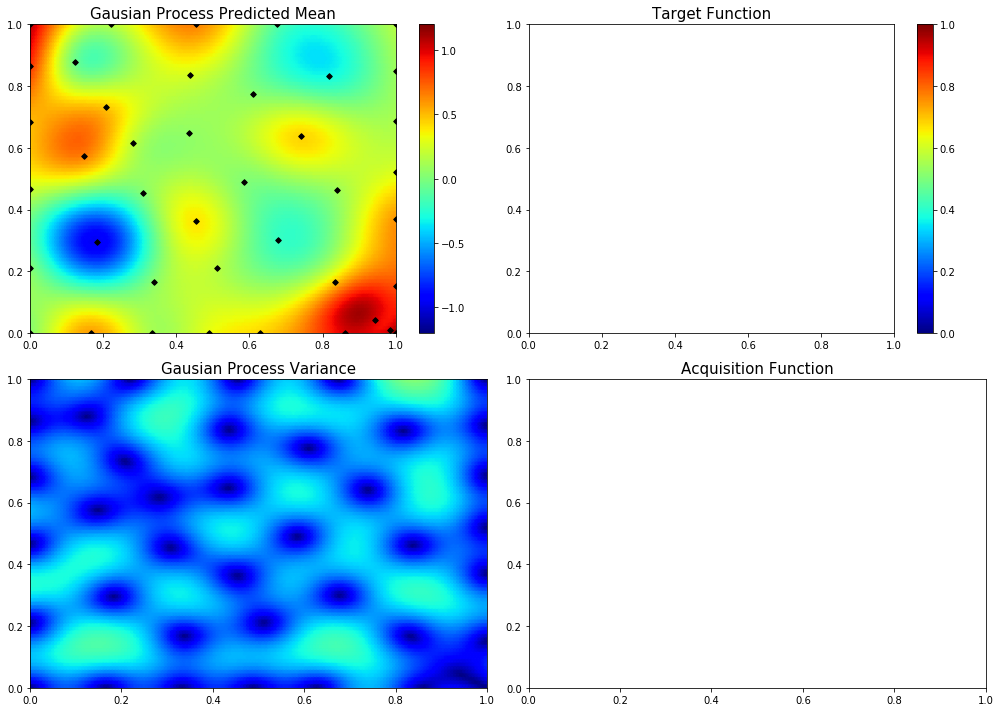

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.8513880054085048]
64  Evaluations Remaining
|  42       | -0.4889   |  1.0      |  0.8514   |
myplot:  042


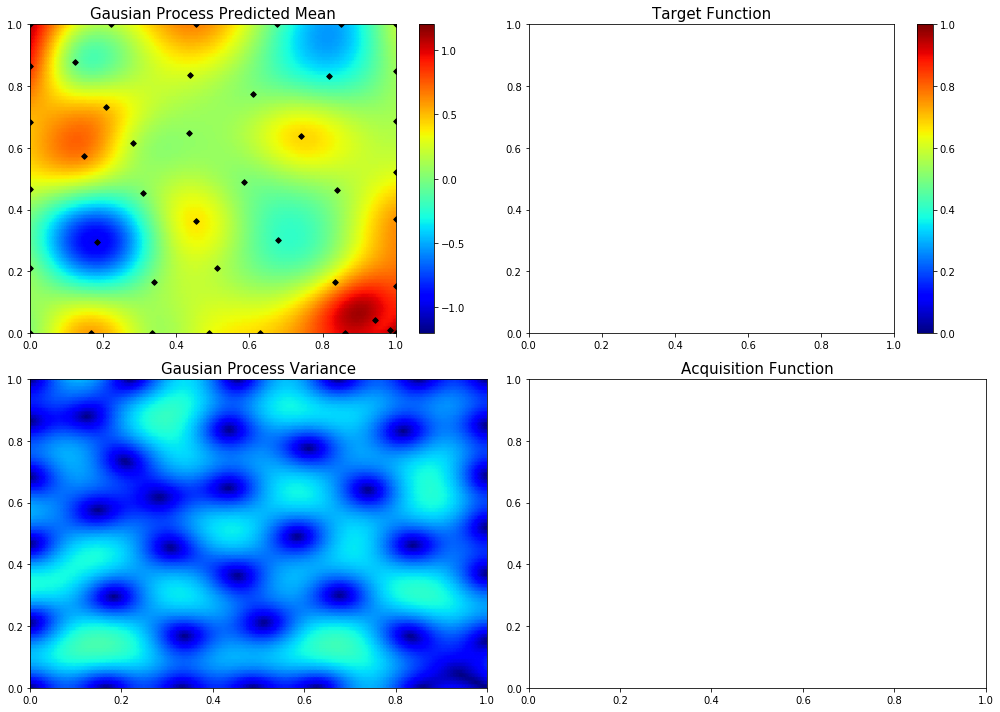

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.07761376628836784, 0.7383550999367455]
63  Evaluations Remaining
|  43       |  0.7847   |  0.07761  |  0.7384   |
myplot:  043


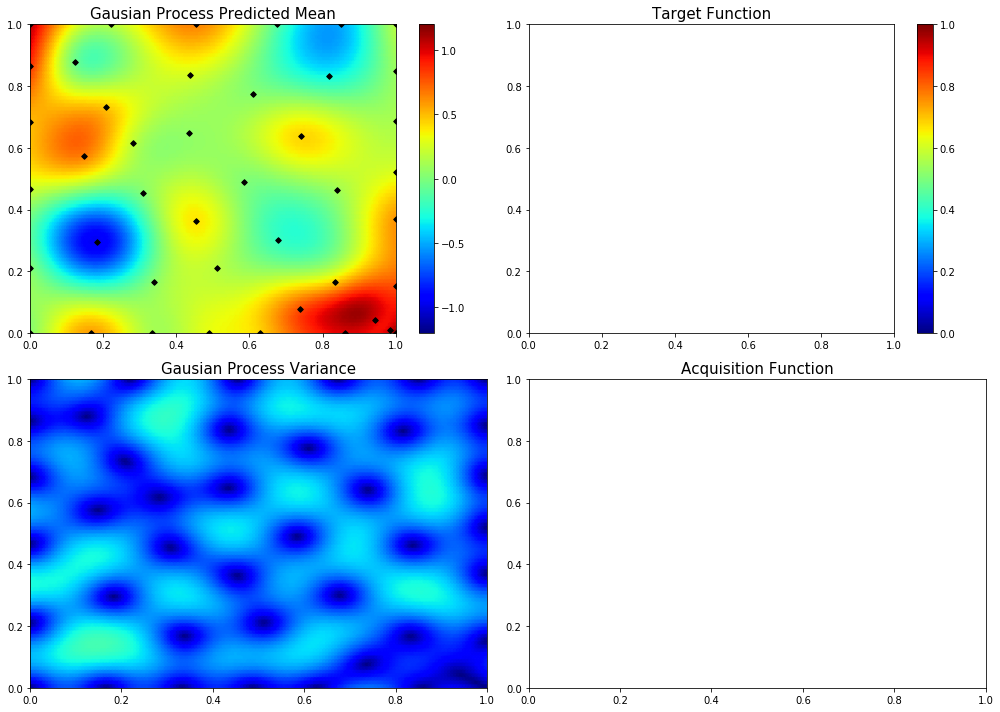

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.9109125943231227, 0.3258612838921504]
62  Evaluations Remaining
|  44       |  0.4435   |  0.9109   |  0.3259   |
myplot:  044


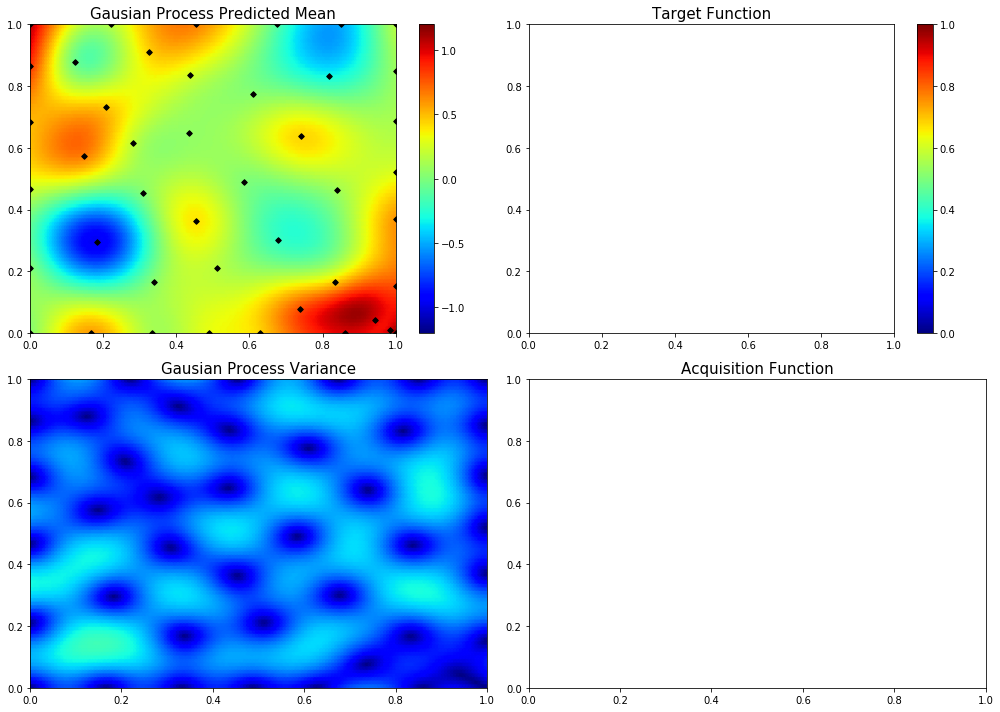

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6297665635969644, 0.8714963561282248]
61  Evaluations Remaining
|  45       |  0.2137   |  0.6298   |  0.8715   |
myplot:  045


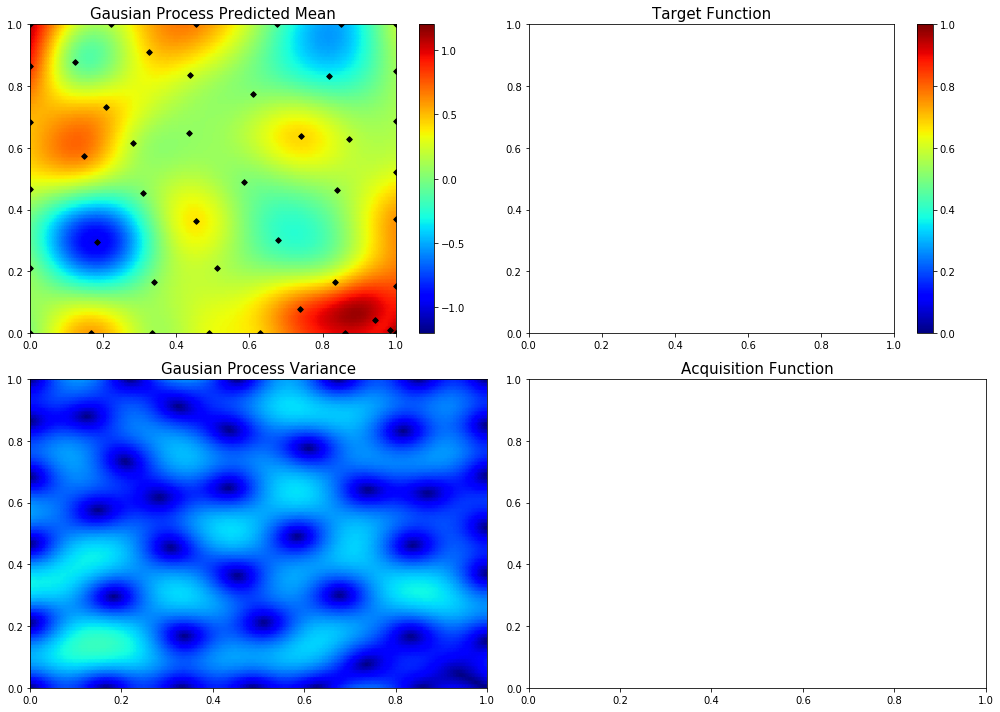

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.10975621716779746, 0.1298921529162313]
60  Evaluations Remaining
|  46       |  0.228    |  0.1098   |  0.1299   |
myplot:  046


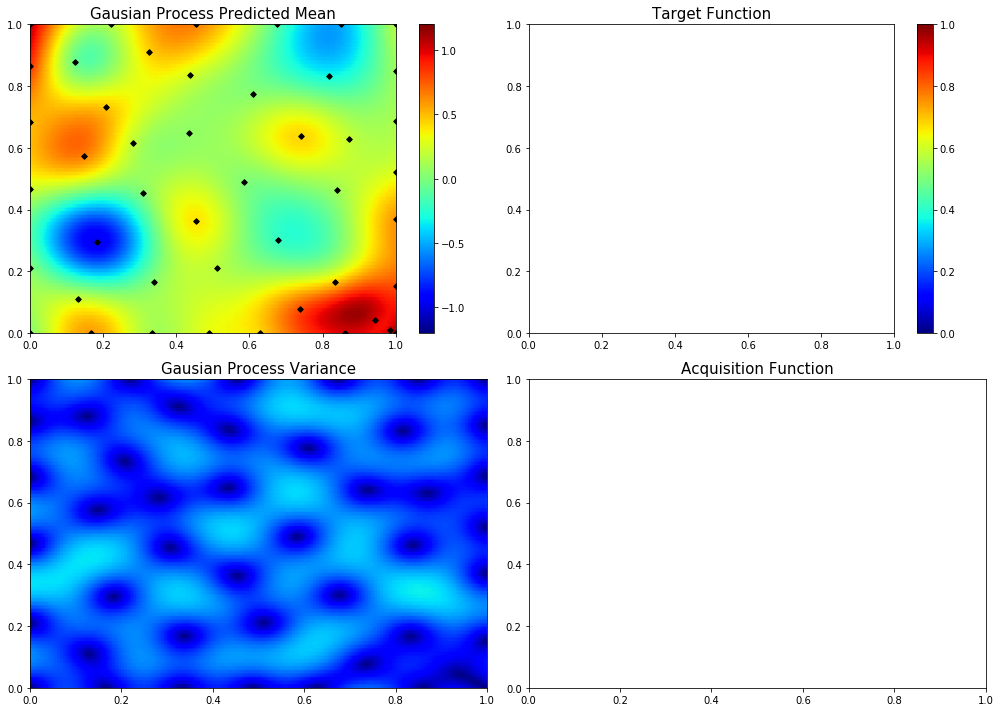

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.2820864264922594, 0.9217358410958904]
59  Evaluations Remaining
|  47       |  0.326    |  0.2821   |  0.9217   |
myplot:  047


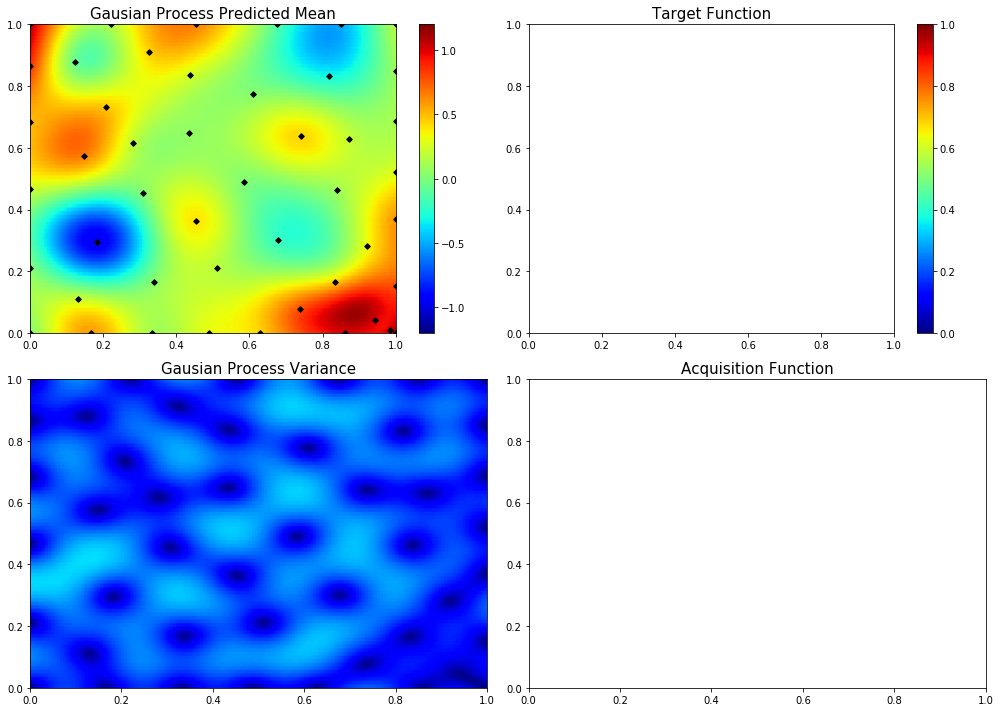

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.7567595397959235]
58  Evaluations Remaining
|  48       |  1.116    |  0.0      |  0.7568   |
myplot:  048


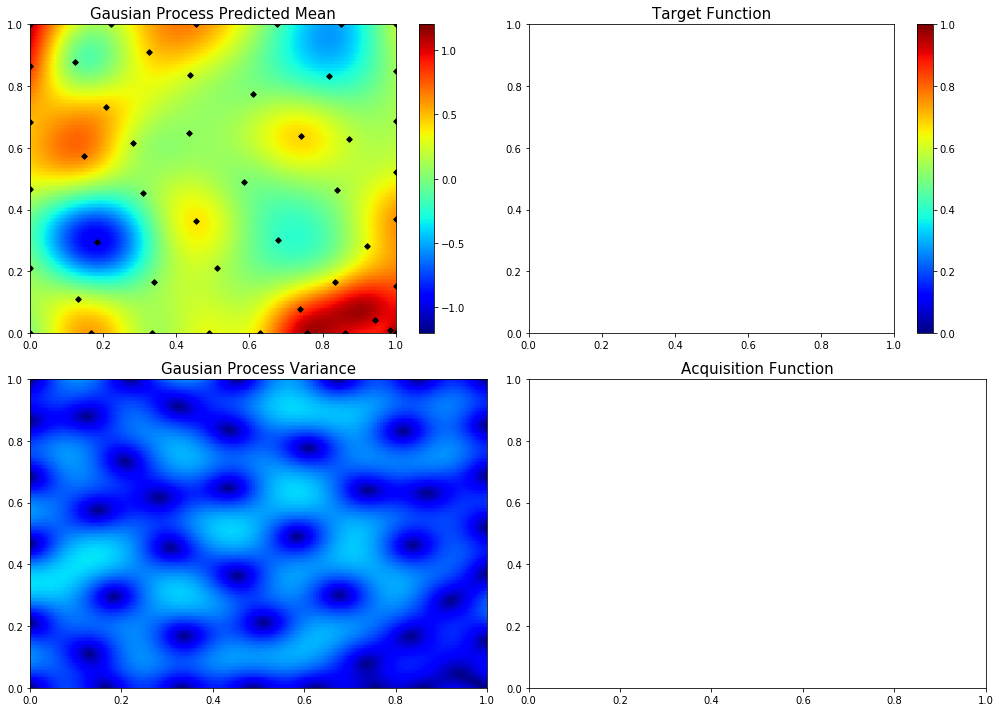

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6885944796068351, 0.1063399605794569]
57  Evaluations Remaining
|  49       |  0.6625   |  0.6886   |  0.1063   |
myplot:  049


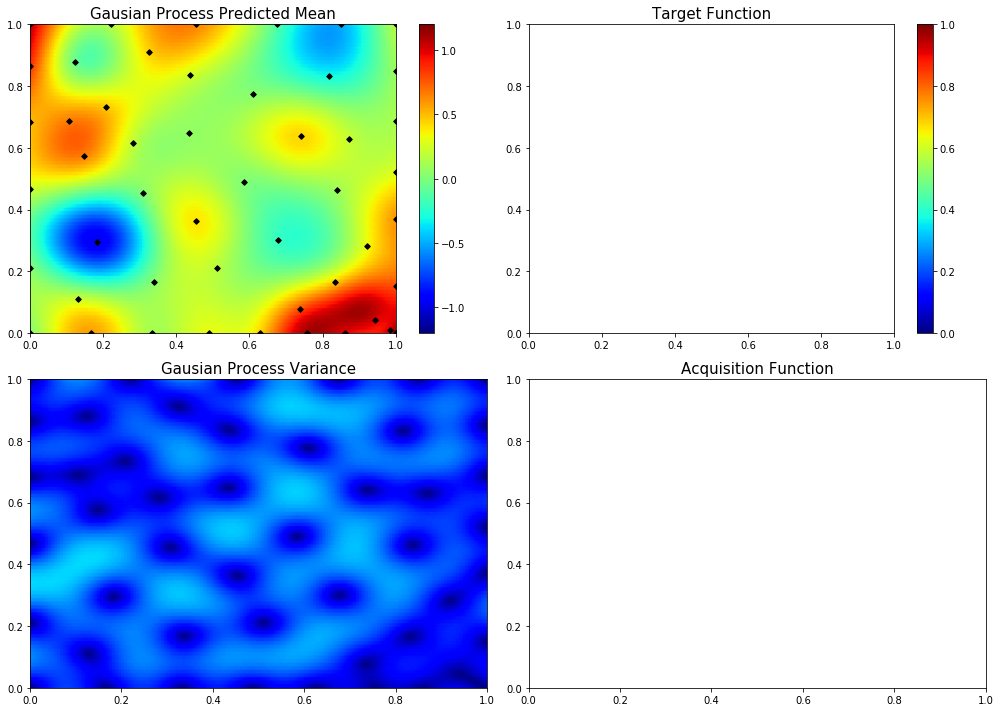

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.3534395630411466]
56  Evaluations Remaining
|  50       |  0.5303   |  1.0      |  0.3534   |
myplot:  050


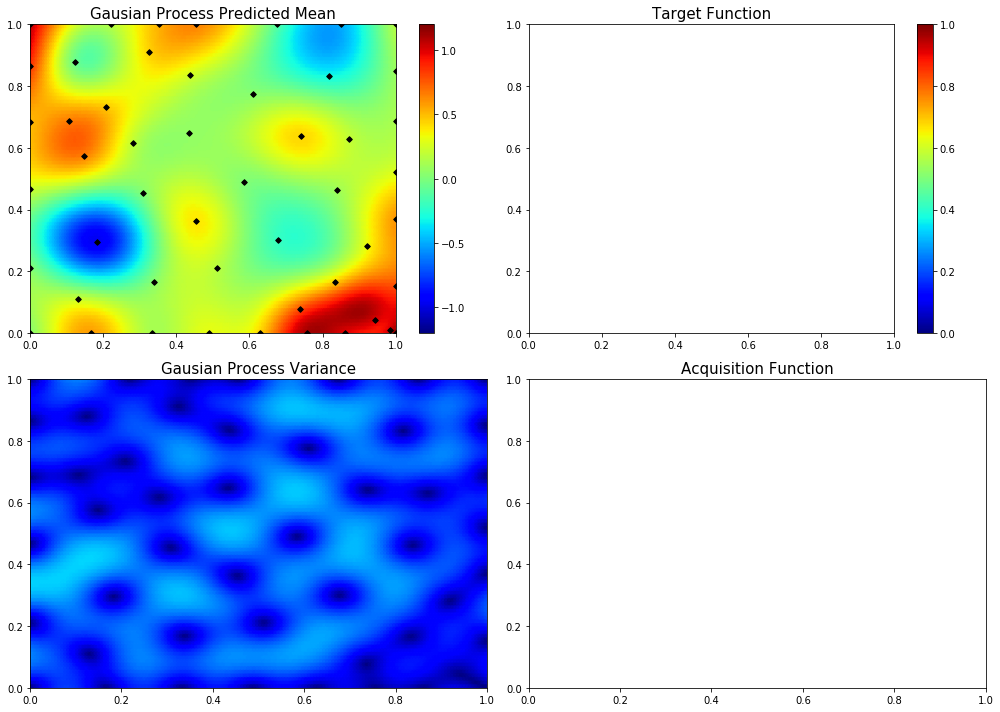

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6349080040799101, 0.5966068265522592]
55  Evaluations Remaining
|  51       |  0.0218   |  0.6349   |  0.5966   |
myplot:  051


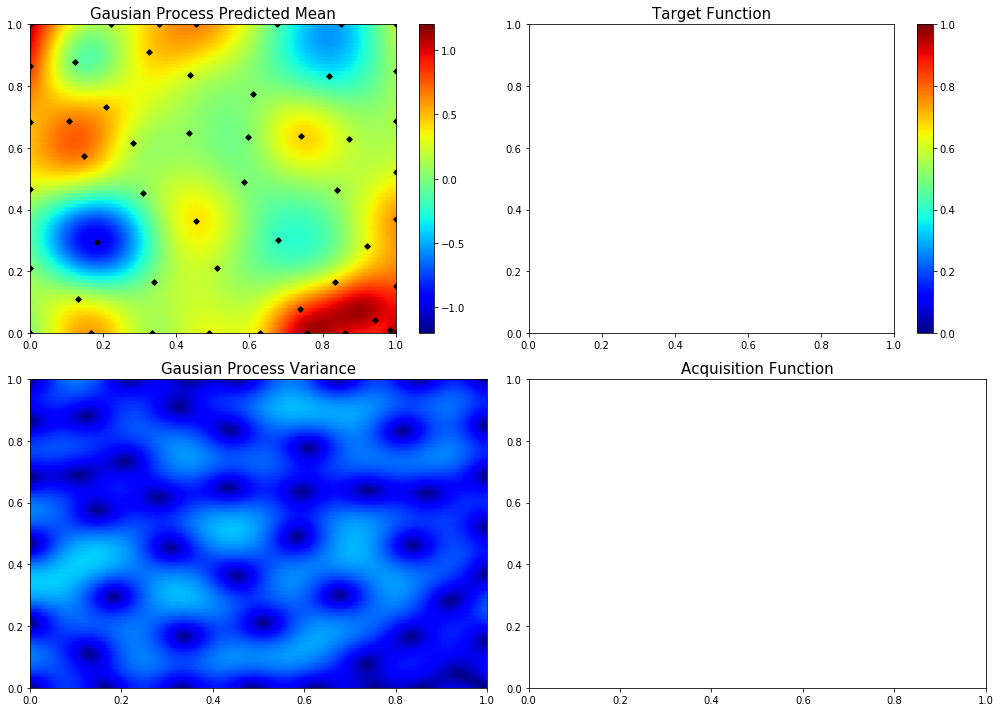

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.06751916758012719, 0.8398359041536253]
54  Evaluations Remaining
|  52       |  0.864    |  0.06752  |  0.8398   |
myplot:  052


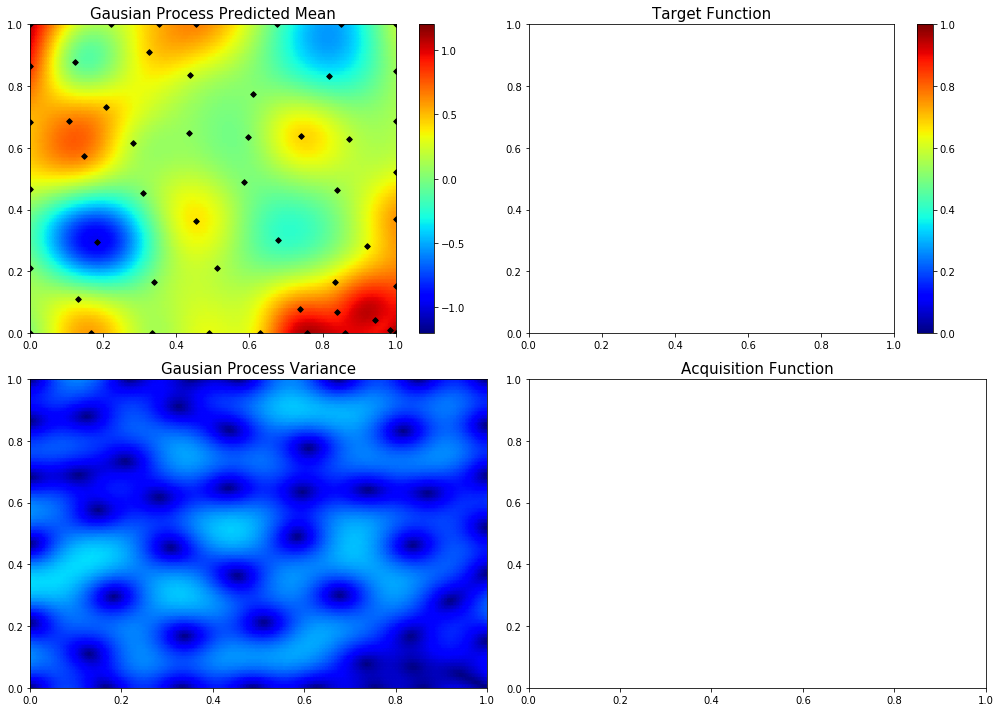

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.49922411915631654, 0.4404859551158533]
53  Evaluations Remaining
|  53       |  0.02373  |  0.4992   |  0.4405   |
myplot:  053


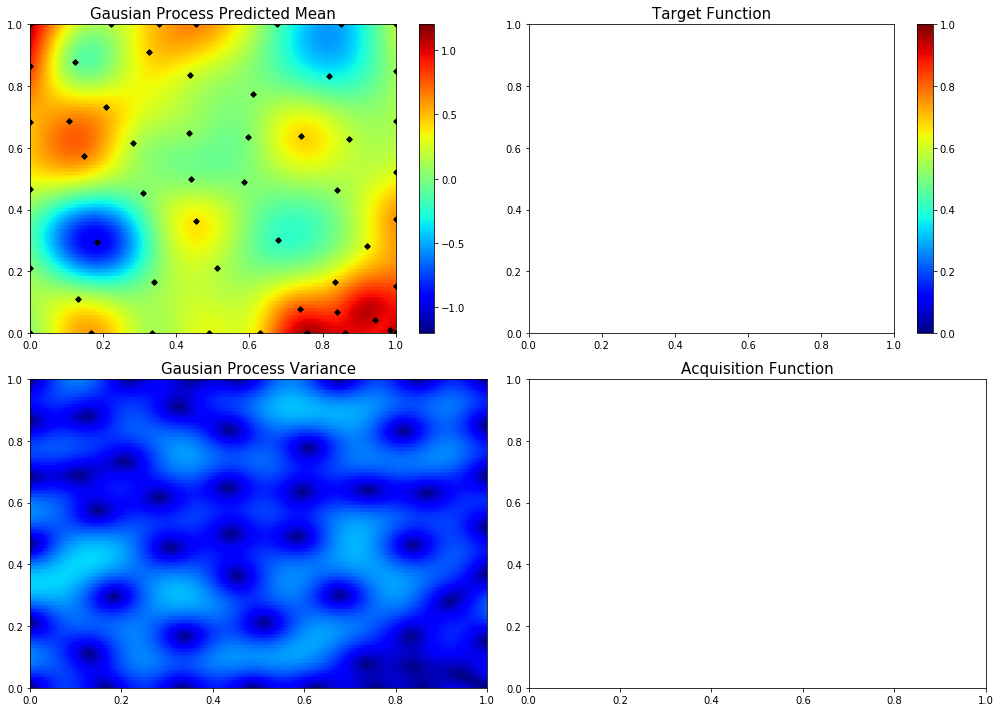

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.9239637775771944, 0.5529537372568962]
52  Evaluations Remaining
|  54       |  0.5362   |  0.924    |  0.553    |
myplot:  054


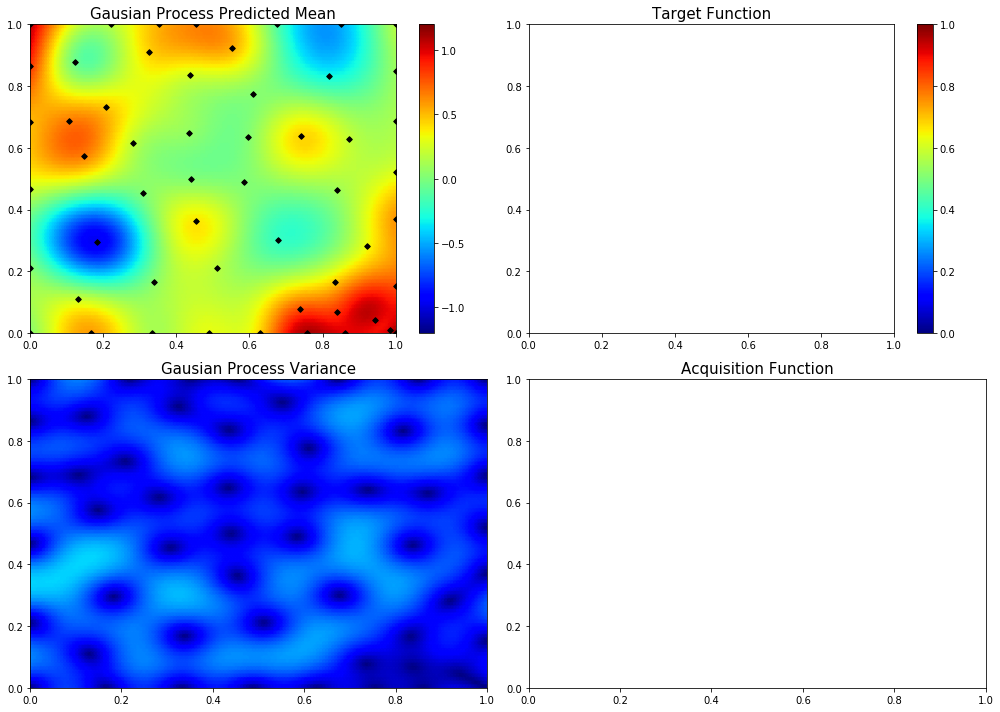

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5758003450163448, 0.0]
51  Evaluations Remaining
|  55       |  0.4221   |  0.5758   |  0.0      |
myplot:  055


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\gaussian_process\gpr.py:480: ConvergenceWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([-2.58456303e-05]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 49, 'nit': 3, 'warnflag': 2}
  ConvergenceWarning)


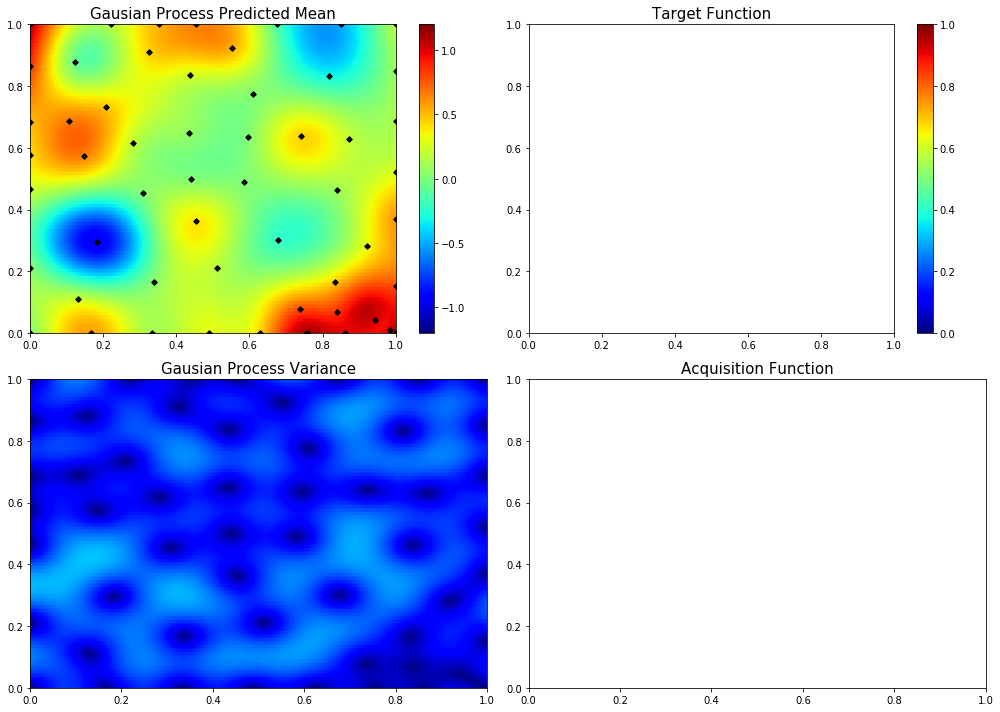

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.0733965578915137]
50  Evaluations Remaining
|  56       |  0.5538   |  1.0      |  0.0734   |
myplot:  056


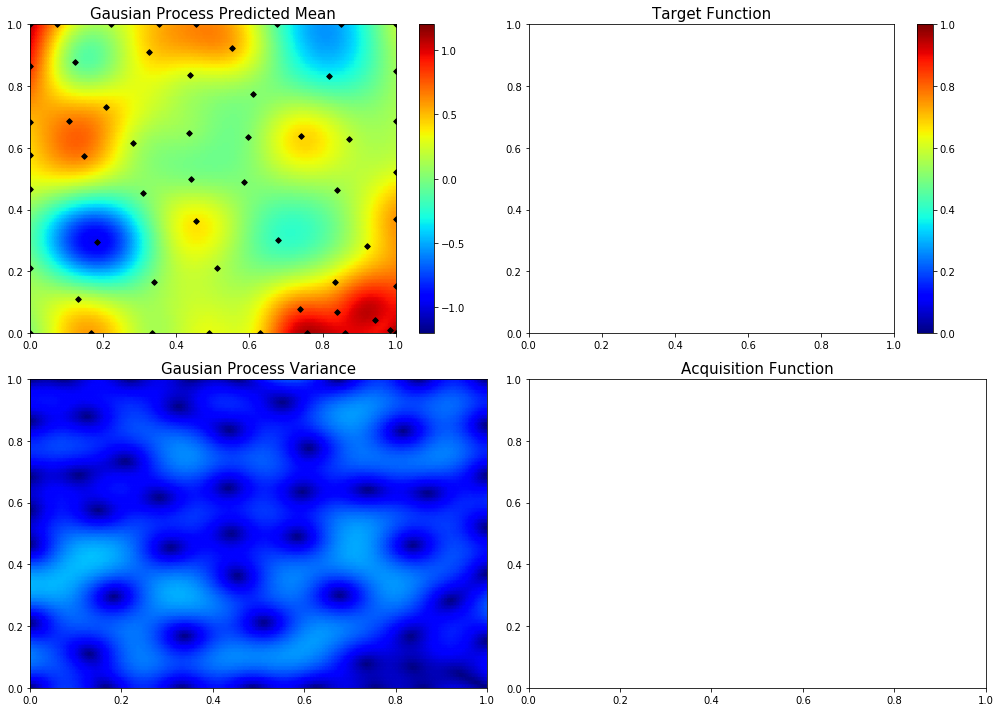

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.9399164662509765, 0.0]
49  Evaluations Remaining
|  57       |  1.033    |  0.9399   |  0.0      |
myplot:  057


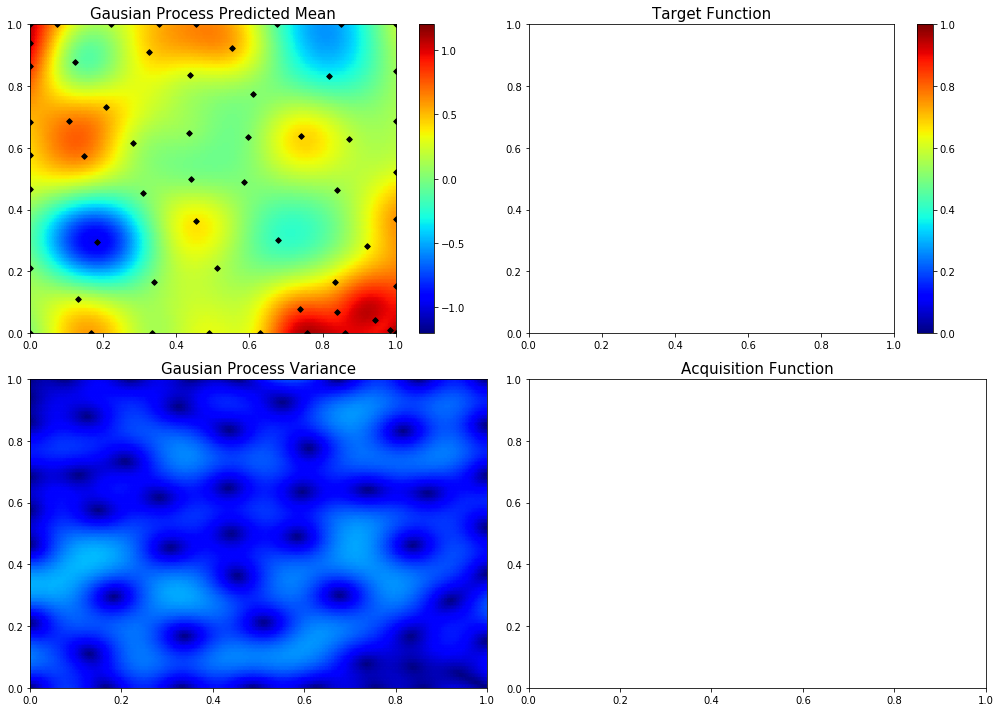

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0018082367843141878, 0.9974147546023598]
48  Evaluations Remaining
|  58       |  1.015    |  0.001808 |  0.9974   |
myplot:  058


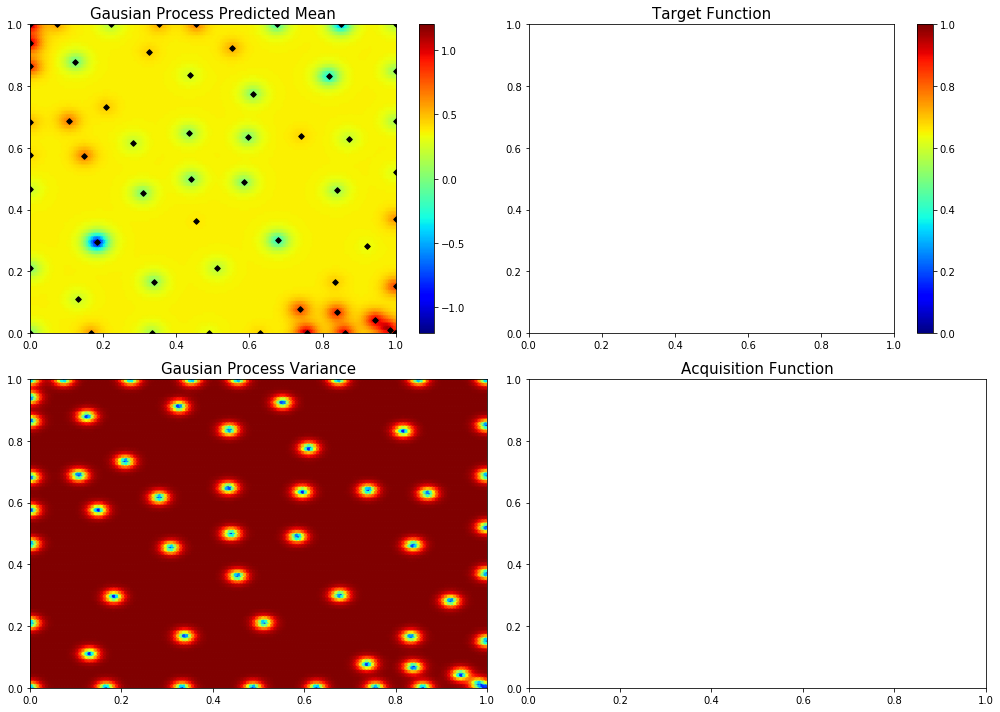

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.054293524869475515, 0.9874254193122918]
47  Evaluations Remaining
|  59       |  1.01     |  0.05429  |  0.9874   |
myplot:  059


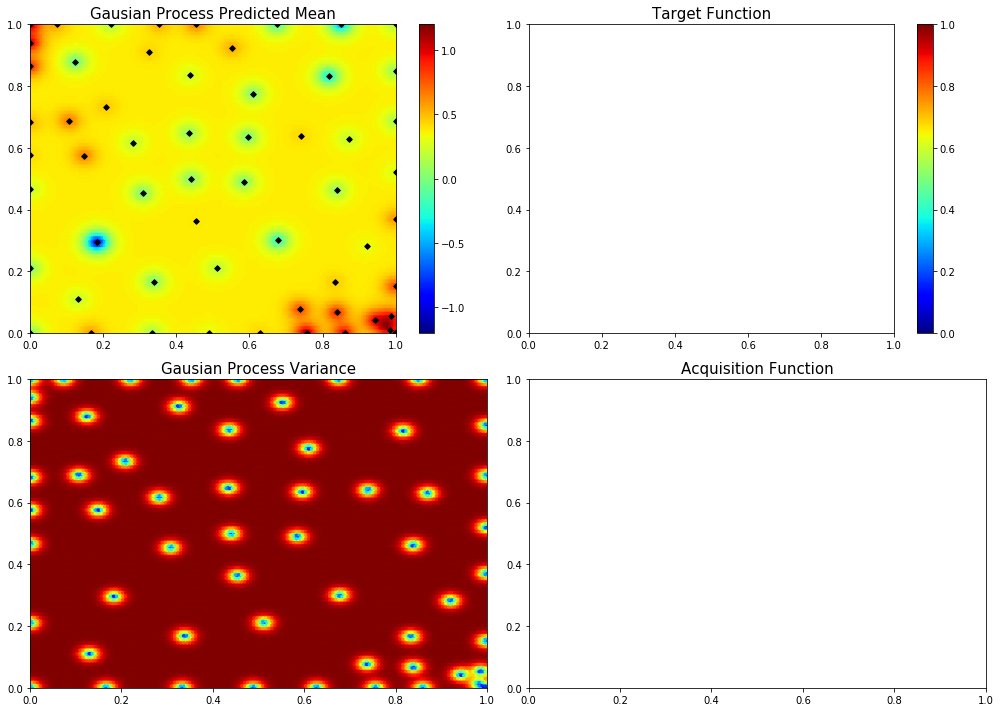

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.01621638656627747, 0.8061971814707575]
46  Evaluations Remaining
|  60       |  1.249    |  0.01622  |  0.8062   |
myplot:  060


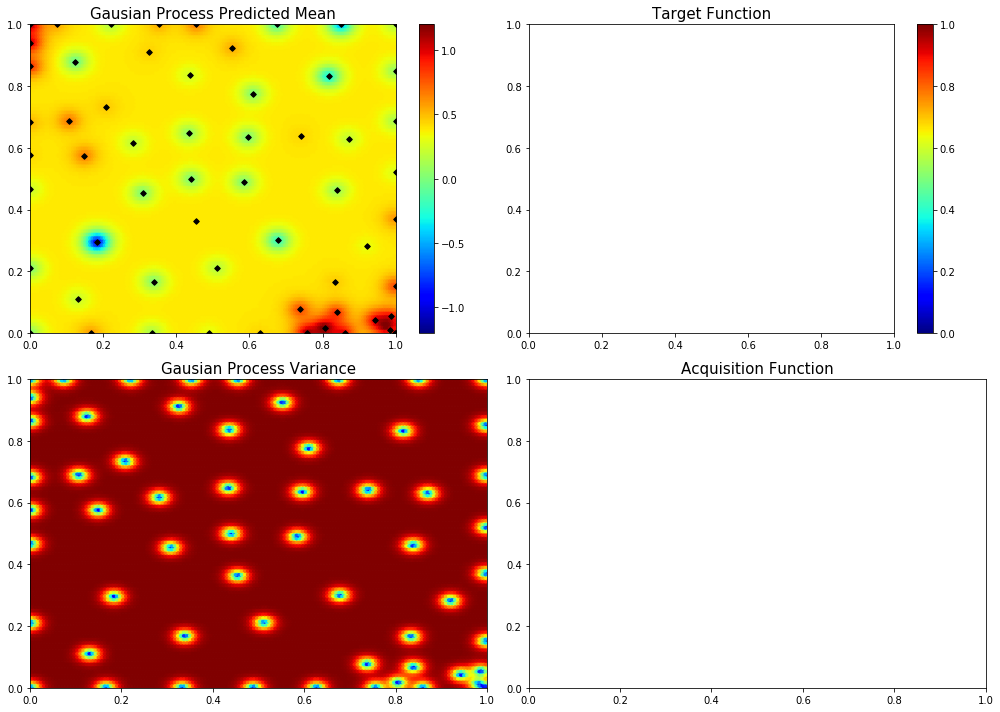

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.054322711429694234, 0.7838283137182668]
45  Evaluations Remaining
|  61       |  1.076    |  0.05432  |  0.7838   |
myplot:  061


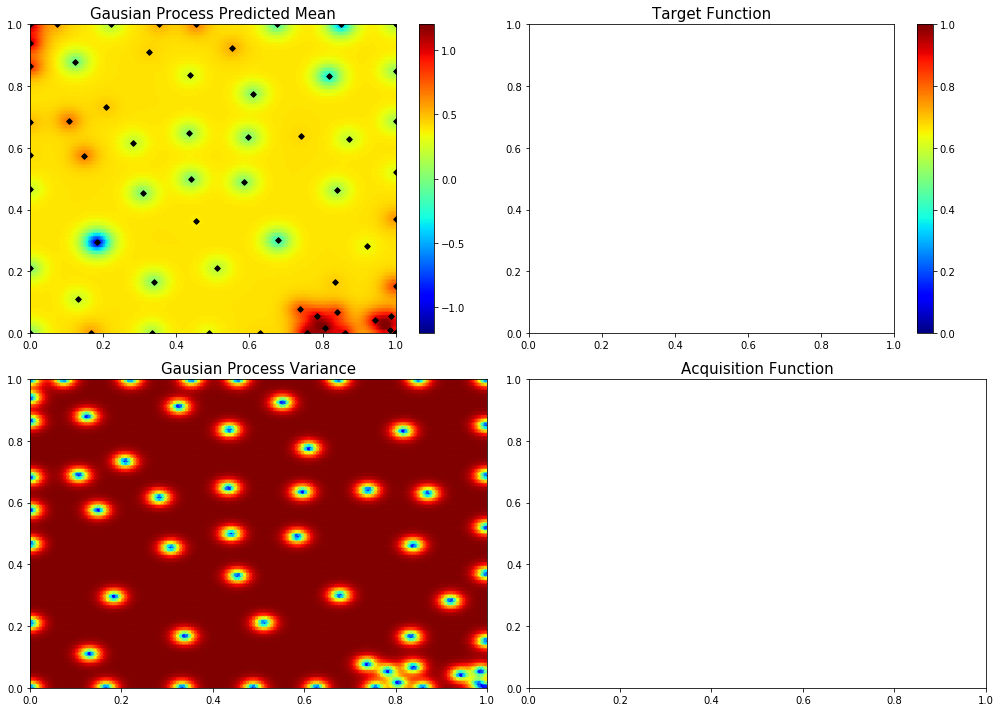

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.9202129097205719]
44  Evaluations Remaining
|  62       |  0.9875   |  0.0      |  0.9202   |
myplot:  062


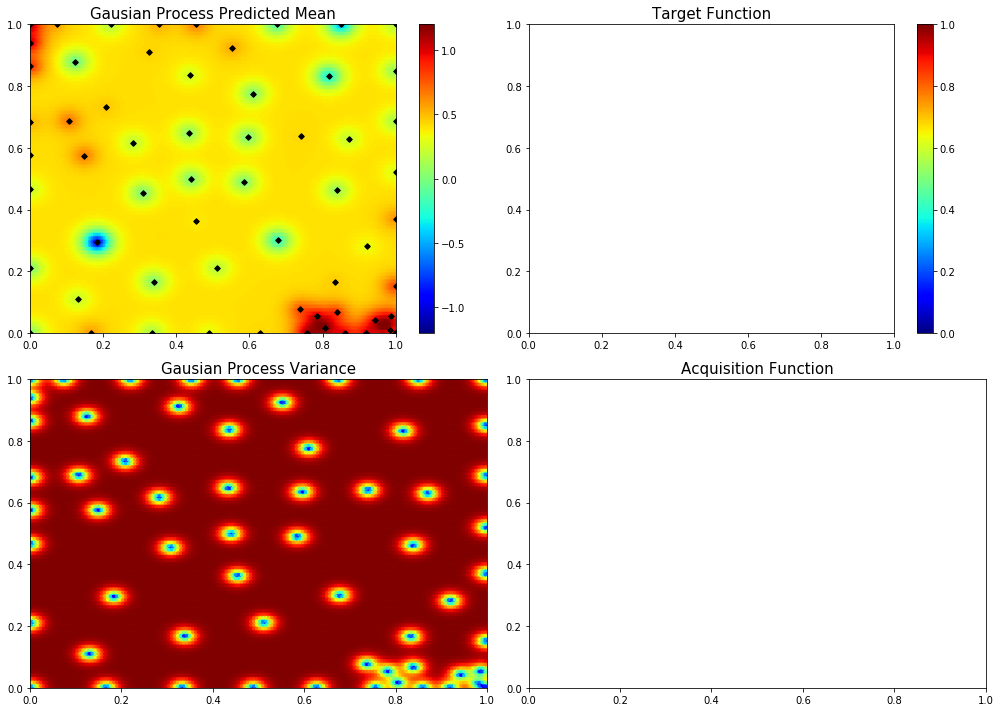

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.022922071308547003, 0.7053347937286767]
43  Evaluations Remaining
|  63       |  0.7022   |  0.02292  |  0.7053   |
myplot:  063


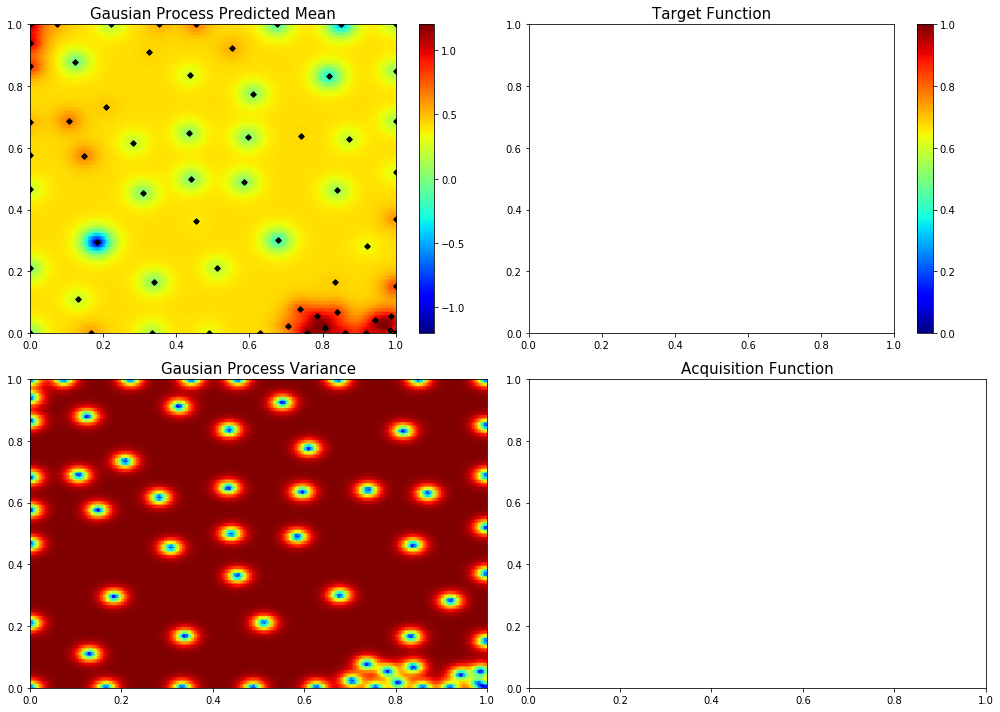

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.10844775963078004, 0.9481868687979738]
42  Evaluations Remaining
|  64       |  0.8216   |  0.1084   |  0.9482   |
myplot:  064


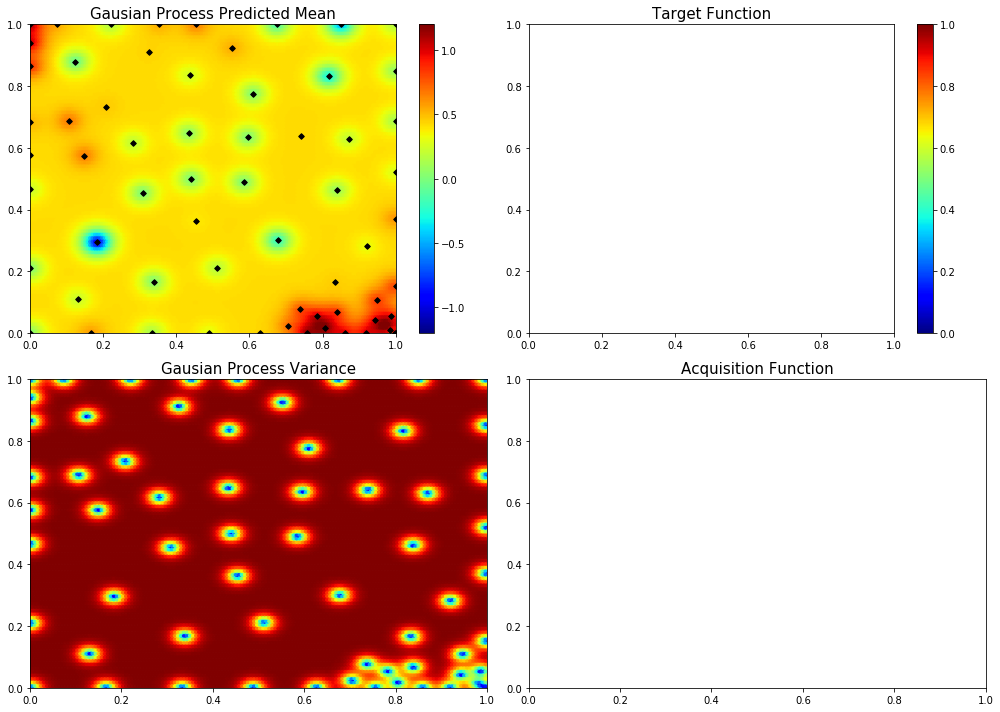

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.05126670300998686, 0.8909816353071792]
41  Evaluations Remaining
|  65       |  0.8714   |  0.05127  |  0.891    |
myplot:  065


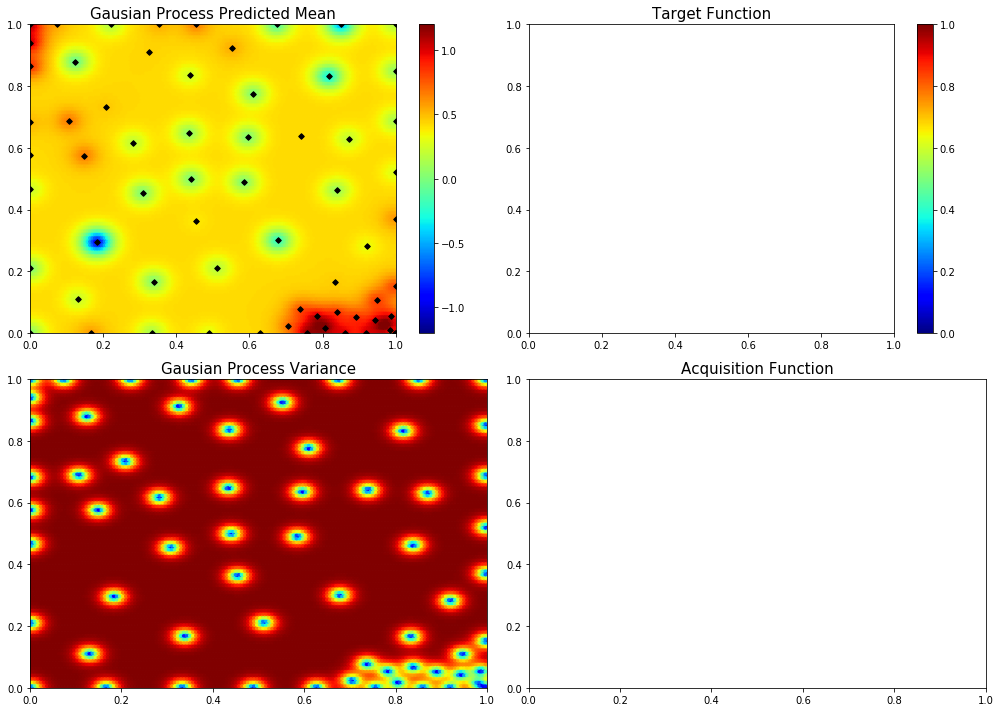

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.9105419366826154, 0.048684087474246046]
40  Evaluations Remaining
|  66       |  0.4691   |  0.9105   |  0.04868  |
myplot:  066


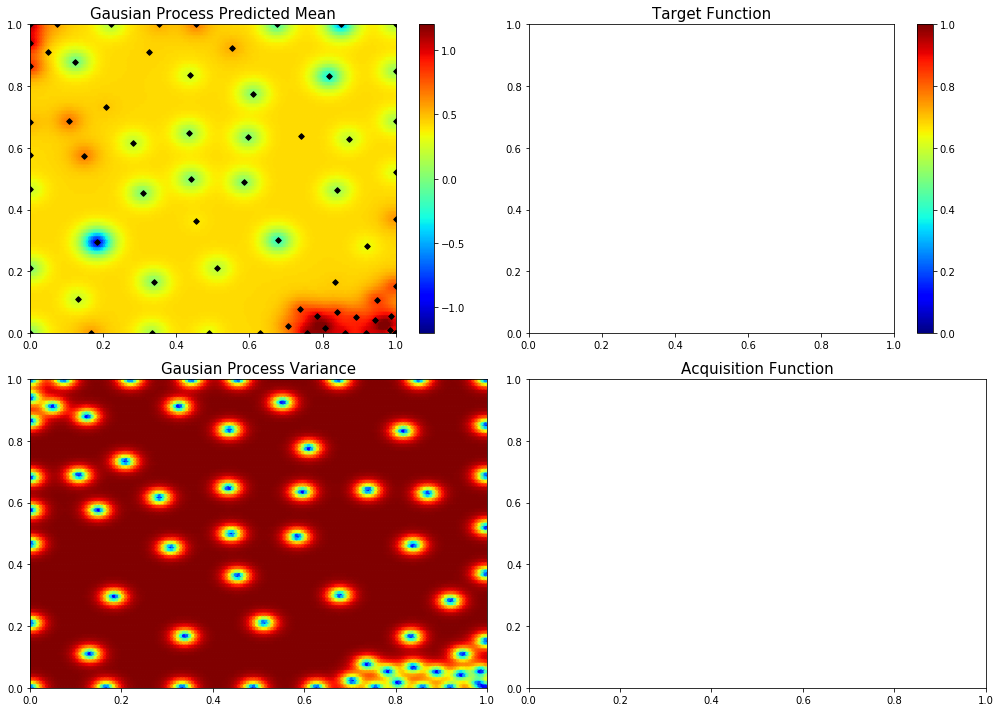

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.17803812180859718, 0.9333013012280021]
39  Evaluations Remaining
|  67       |  0.6094   |  0.178    |  0.9333   |
myplot:  067


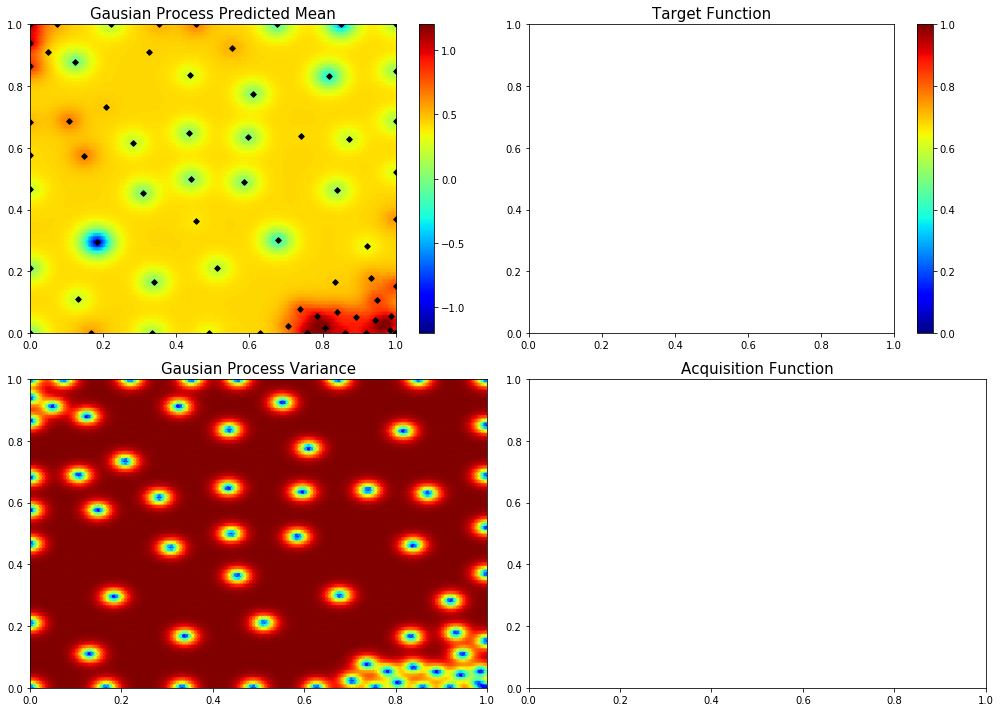

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.79360858746612, 0.0]
38  Evaluations Remaining
|  68       |  0.7142   |  0.7936   |  0.0      |
myplot:  068


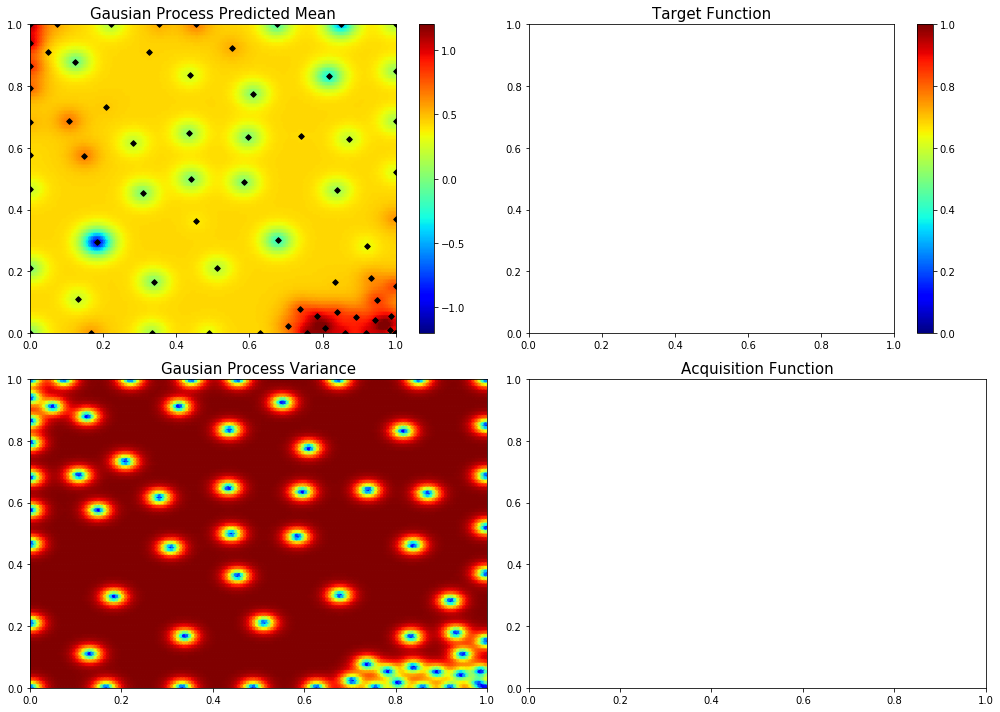

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7582995940107076, 0.06823859484710193]
37  Evaluations Remaining
|  69       |  0.5703   |  0.7583   |  0.06824  |
myplot:  069


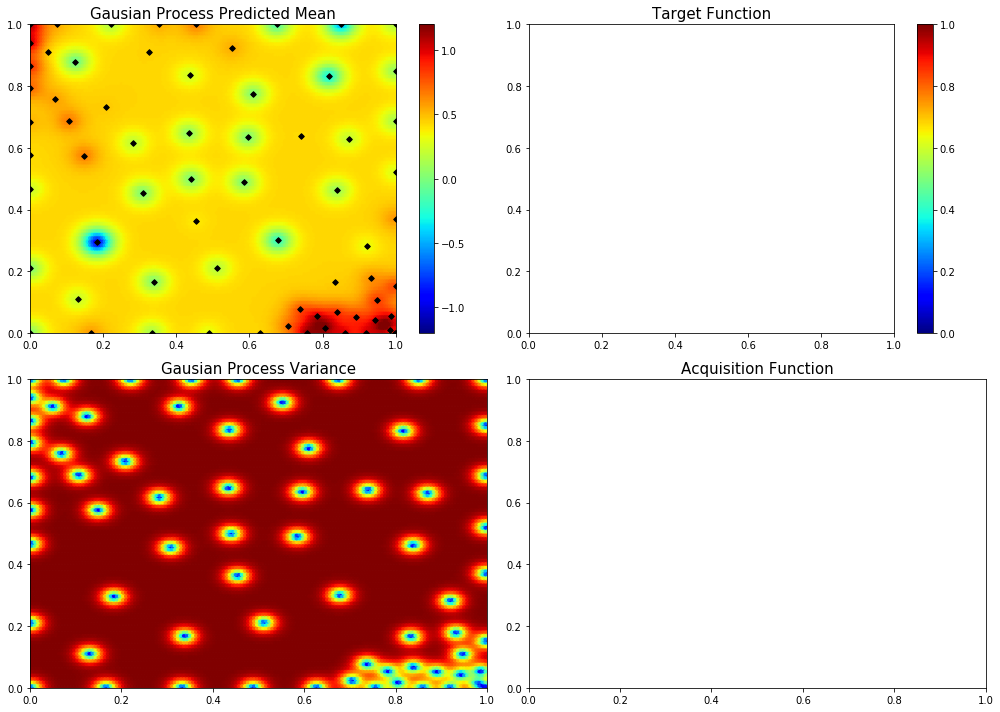

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.22526115588494686, 1.0]
36  Evaluations Remaining
|  70       |  0.7947   |  0.2253   |  1.0      |
myplot:  070


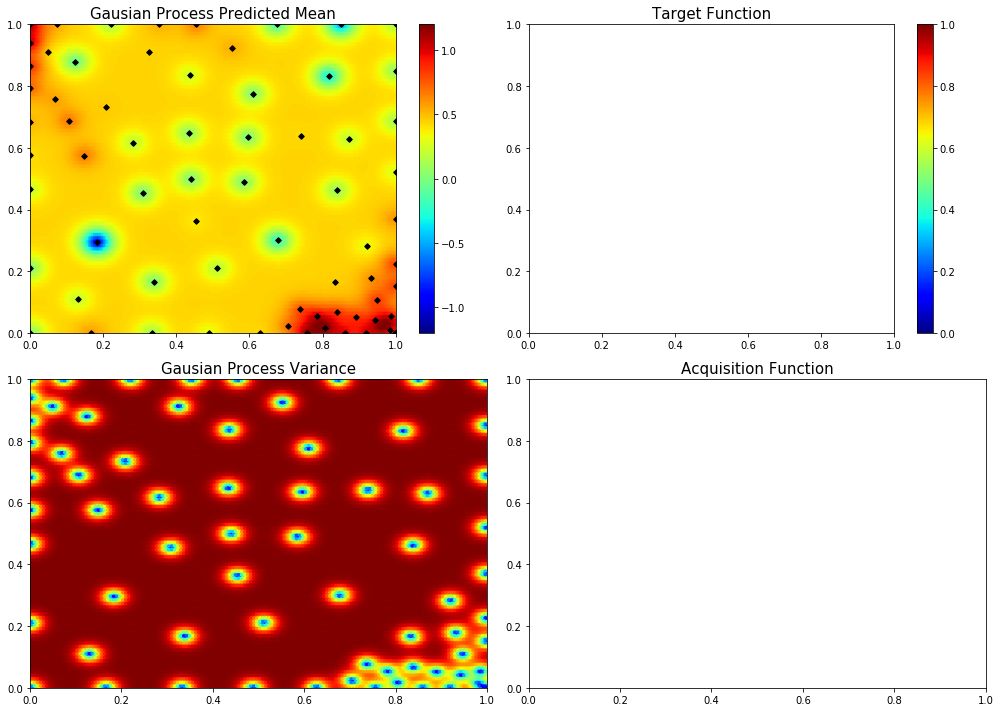

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.10015057472390353, 0.6634596453128314]
35  Evaluations Remaining
|  71       |  0.3464   |  0.1002   |  0.6635   |
myplot:  071


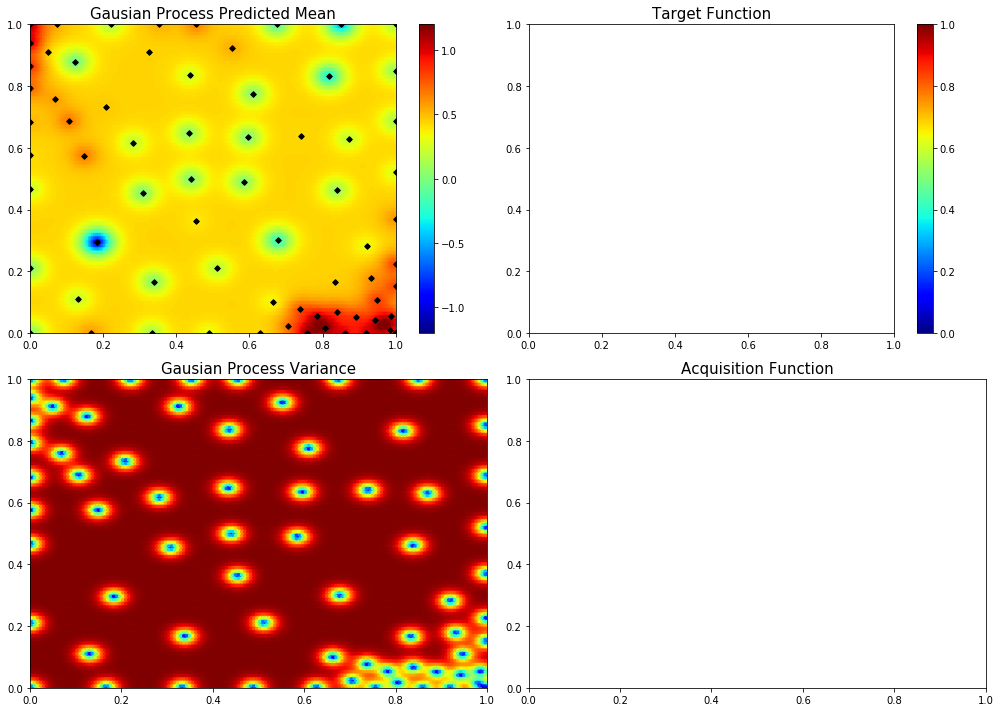

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.615578121756654, 0.08135213391308144]
34  Evaluations Remaining
|  72       |  0.4884   |  0.6156   |  0.08135  |
myplot:  072


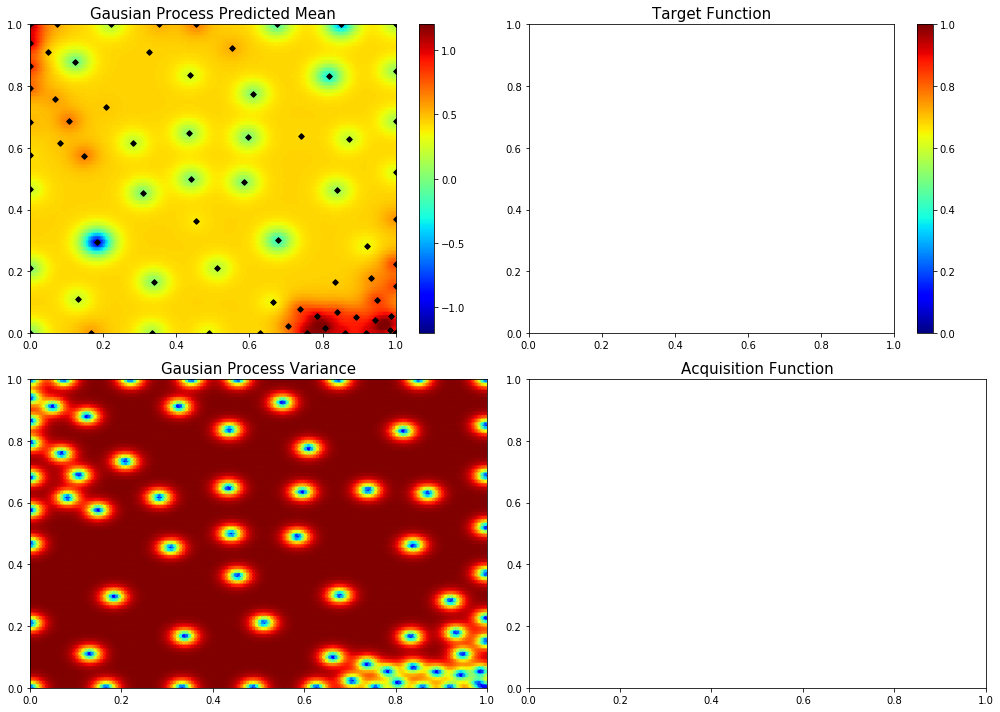

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6489618901109047, 0.17485767756804083]
33  Evaluations Remaining
|  73       |  0.722    |  0.649    |  0.1749   |
myplot:  073


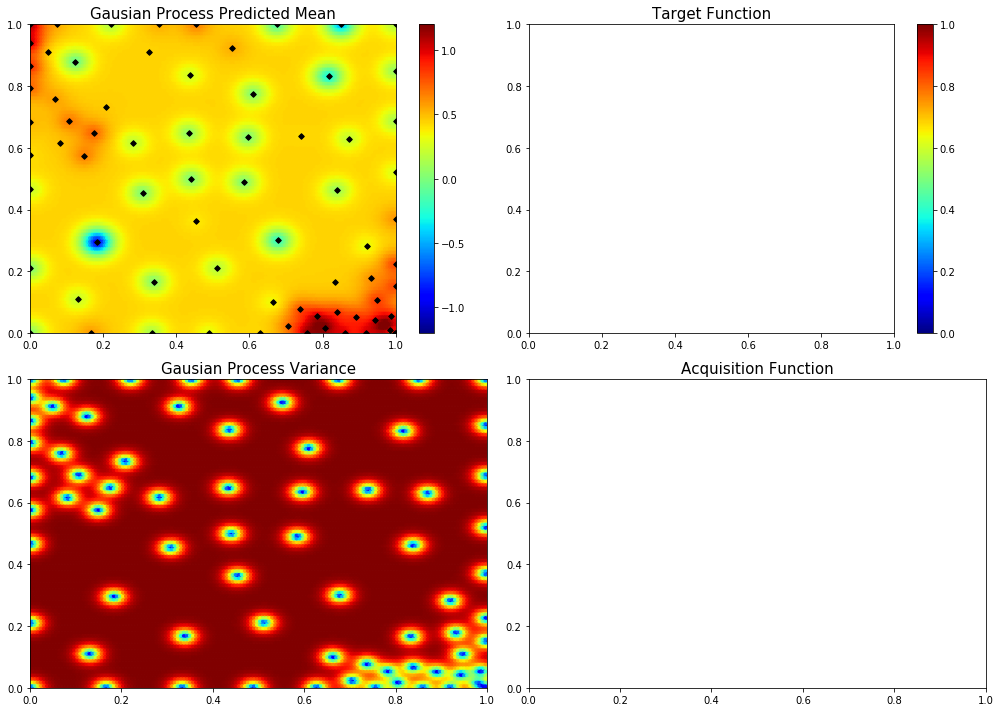

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.1531873567749562, 0.7484606873194459]
32  Evaluations Remaining
|  74       |  0.3631   |  0.1532   |  0.7485   |
myplot:  074


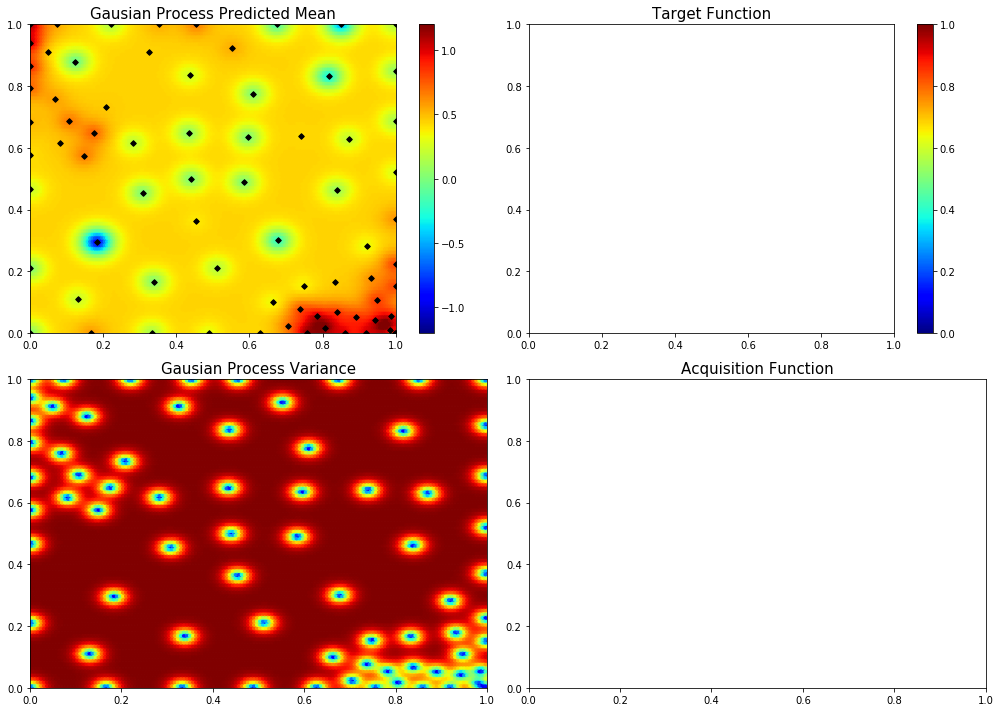

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.4912986115324962, 0.14878475634708324]
31  Evaluations Remaining
|  75       |  0.2067   |  0.4913   |  0.1488   |
myplot:  075


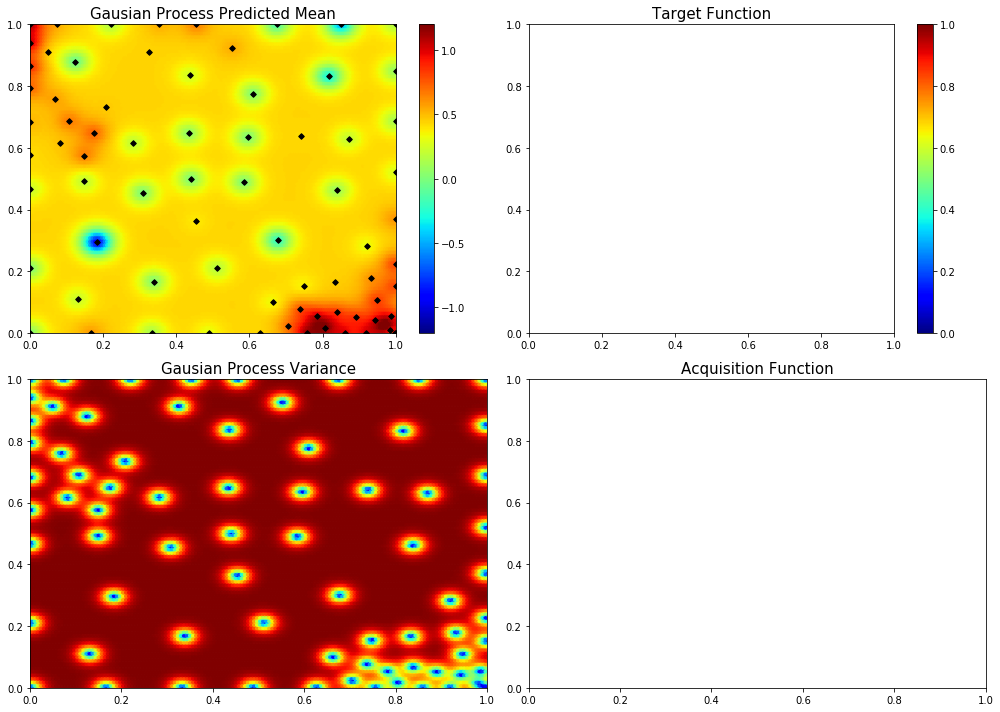

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.5339017527827962]
30  Evaluations Remaining
|  76       |  0.4501   |  1.0      |  0.5339   |
myplot:  076


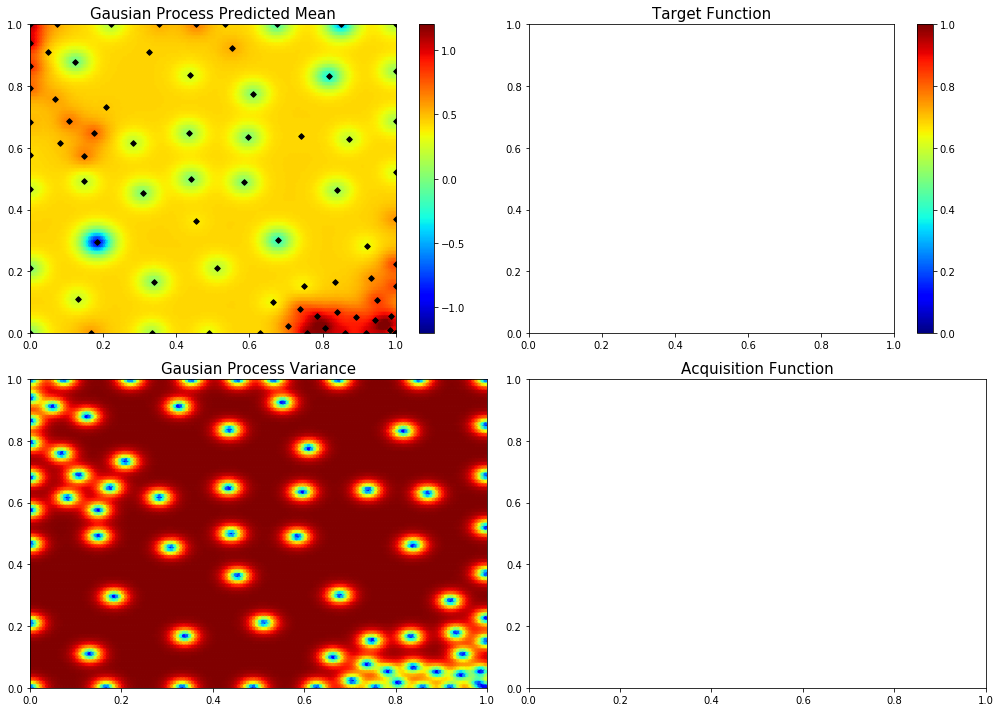

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7926276652659088, 0.30022528859176156]
29  Evaluations Remaining
|  77       |  0.2557   |  0.7926   |  0.3002   |
myplot:  077


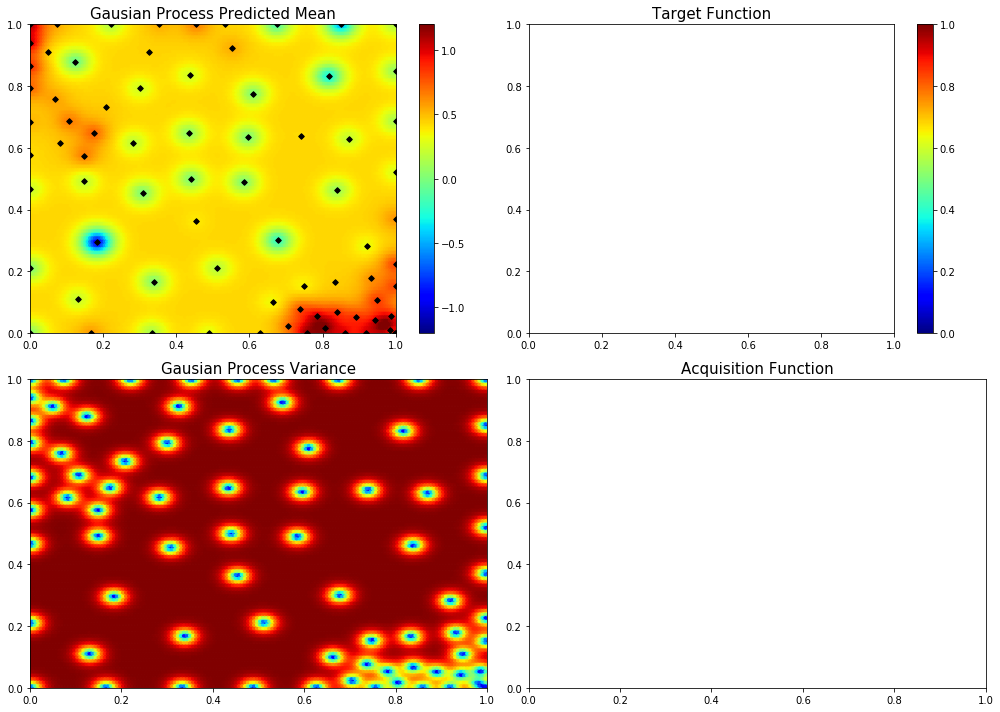

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.9329942203569919, 0.4168470306377425]
28  Evaluations Remaining
|  78       |  0.7193   |  0.933    |  0.4168   |
myplot:  078


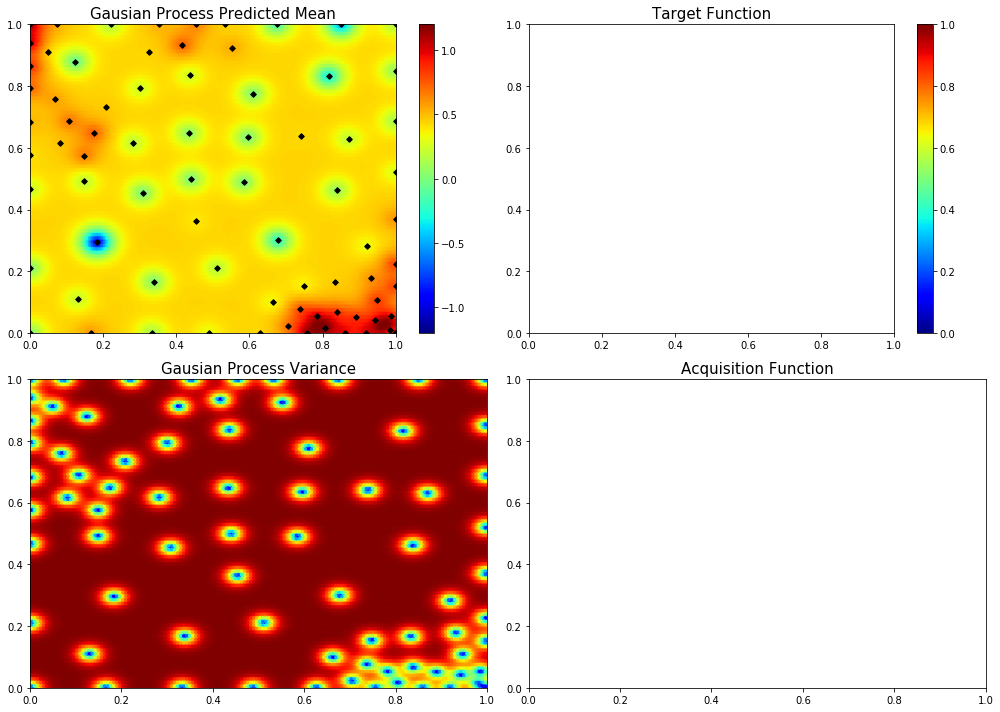

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.3091671101280379, 0.35139765083747354]
27  Evaluations Remaining
|  79       |  0.2133   |  0.3092   |  0.3514   |
myplot:  079


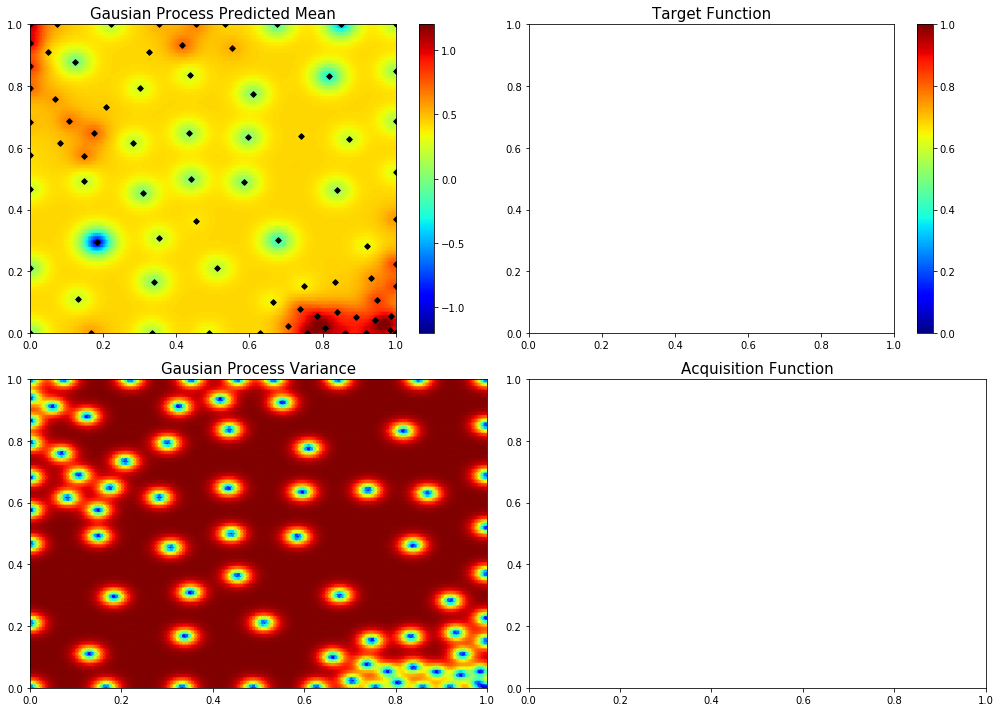

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.529139969070931, 0.7212281344279271]
26  Evaluations Remaining
|  80       |  0.171    |  0.5291   |  0.7212   |
myplot:  080


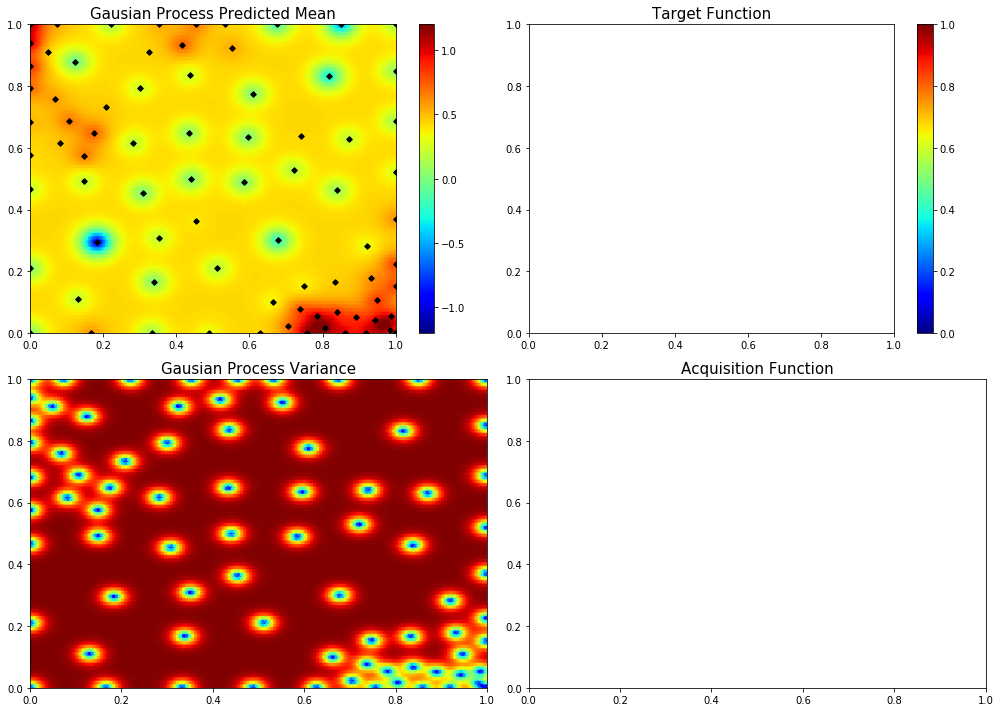

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.34318613557602623, 0.0]
25  Evaluations Remaining
|  81       |  0.09446  |  0.3432   |  0.0      |
myplot:  081


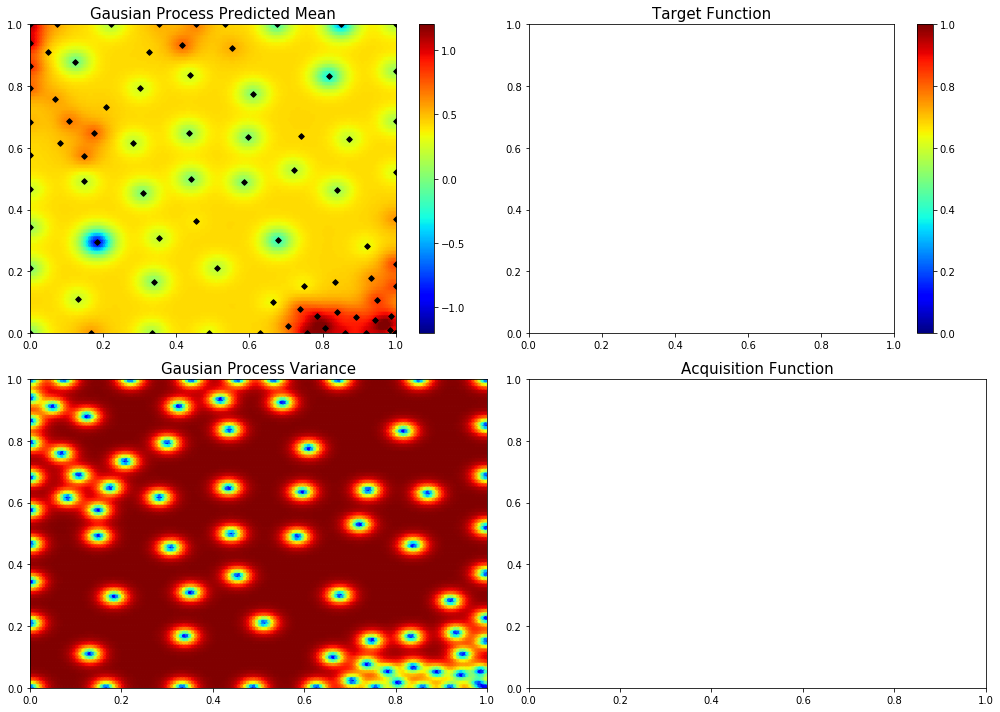

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.061819095572070076, 0.23186630657266685]
24  Evaluations Remaining
|  82       |  0.2014   |  0.06182  |  0.2319   |
myplot:  082


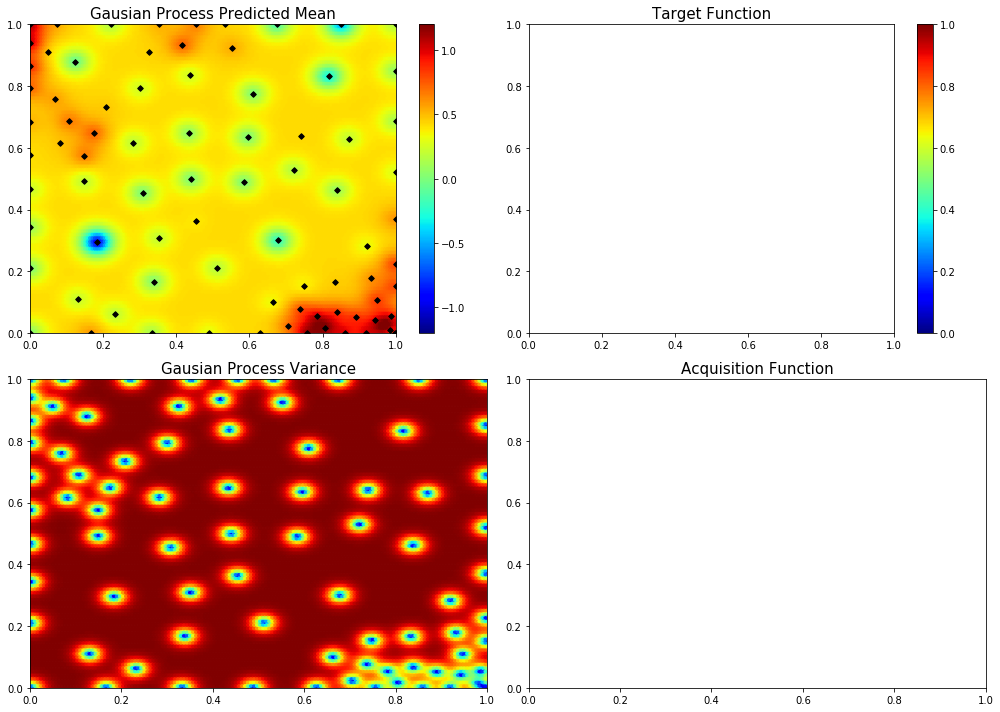

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.32588647581953484, 0.8155459536756418]
23  Evaluations Remaining
|  83       | -0.7933   |  0.3259   |  0.8155   |
myplot:  083


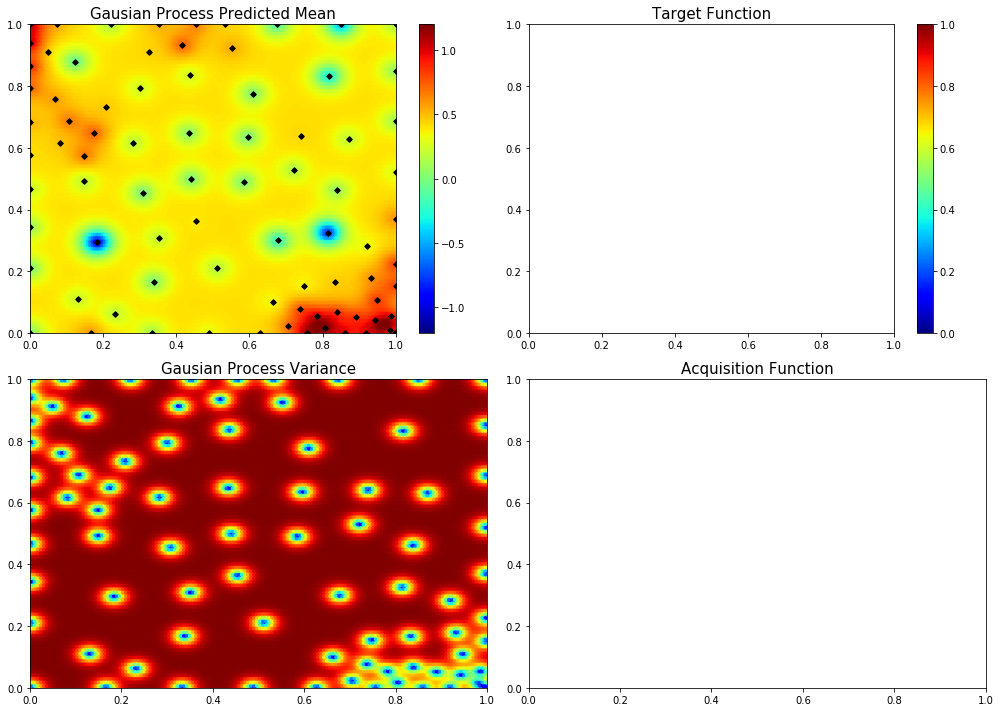

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.2956243511869292, 1.0]
22  Evaluations Remaining
|  84       |  0.8798   |  0.2956   |  1.0      |
myplot:  084


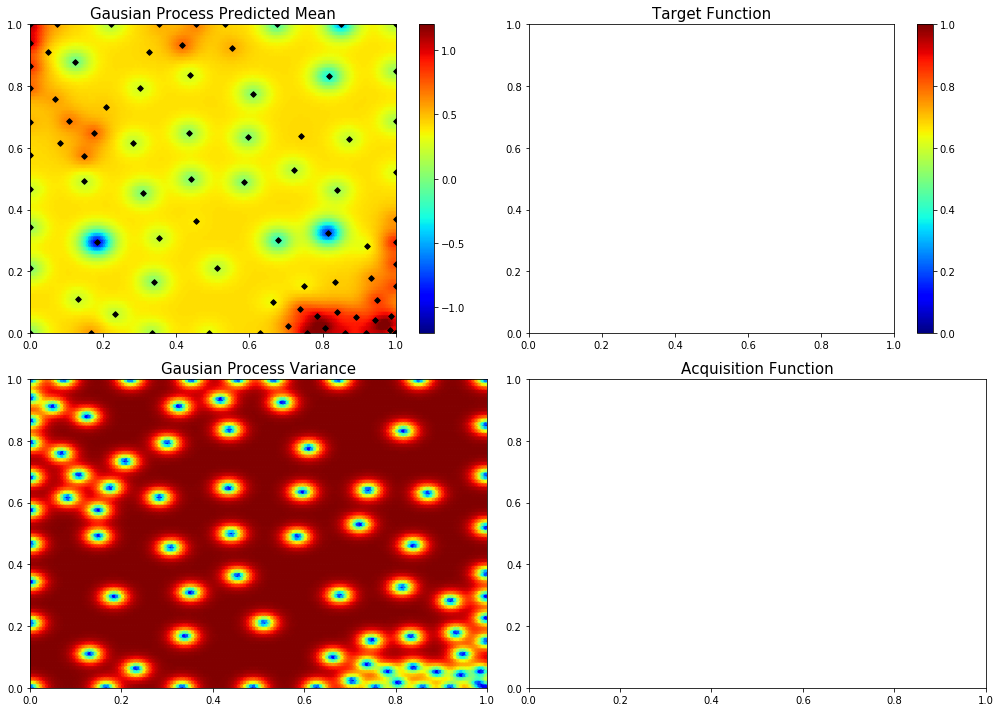

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.09316378606607258, 0.5503340913424682]
21  Evaluations Remaining
|  85       |  0.2264   |  0.09316  |  0.5503   |
myplot:  085


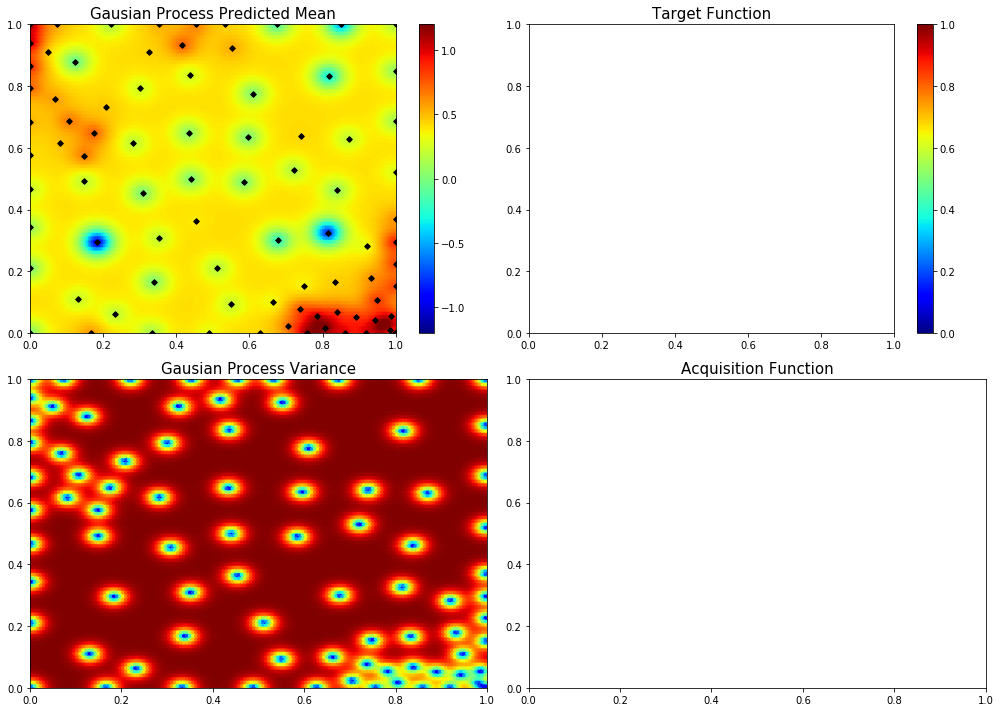

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.35322592911267975, 0.5566259125032313]
20  Evaluations Remaining
|  86       |  0.317    |  0.3532   |  0.5566   |
myplot:  086


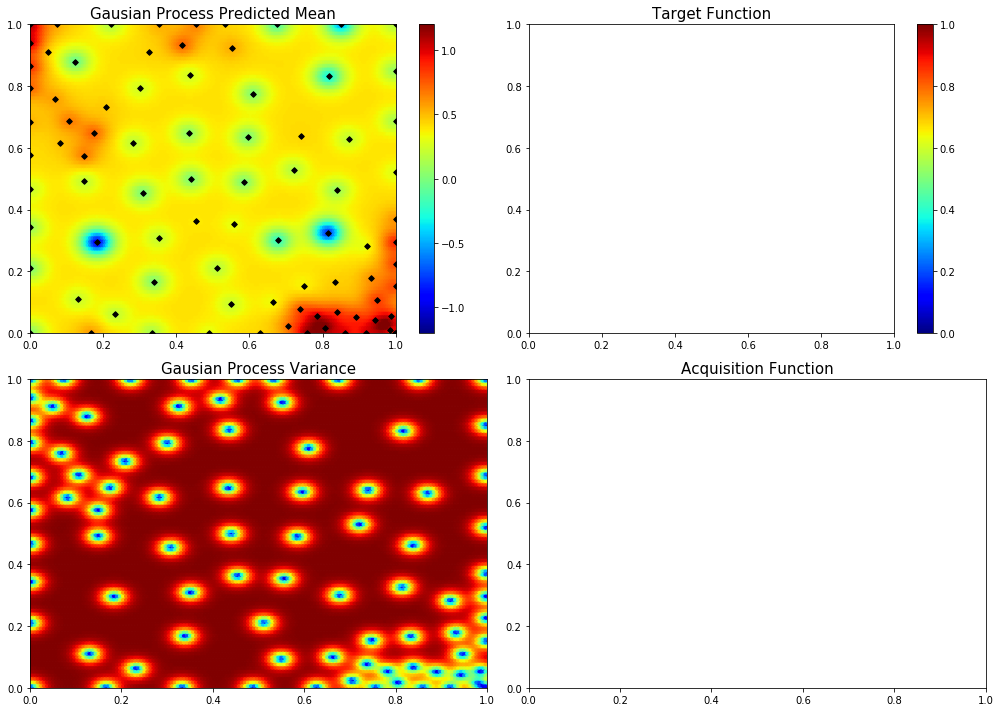

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7361571981645713, 0.7288581736472249]
19  Evaluations Remaining
|  87       |  0.1491   |  0.7362   |  0.7289   |
myplot:  087


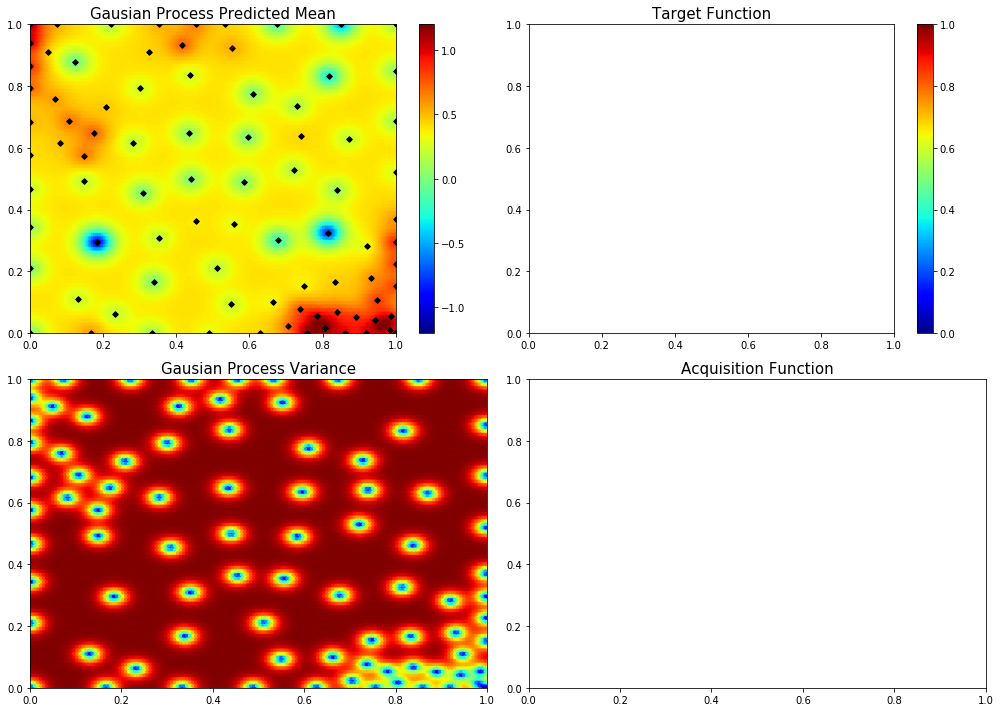

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.43099092255015325, 0.9433155676555878]
18  Evaluations Remaining
|  88       |  0.2725   |  0.431    |  0.9433   |
myplot:  088


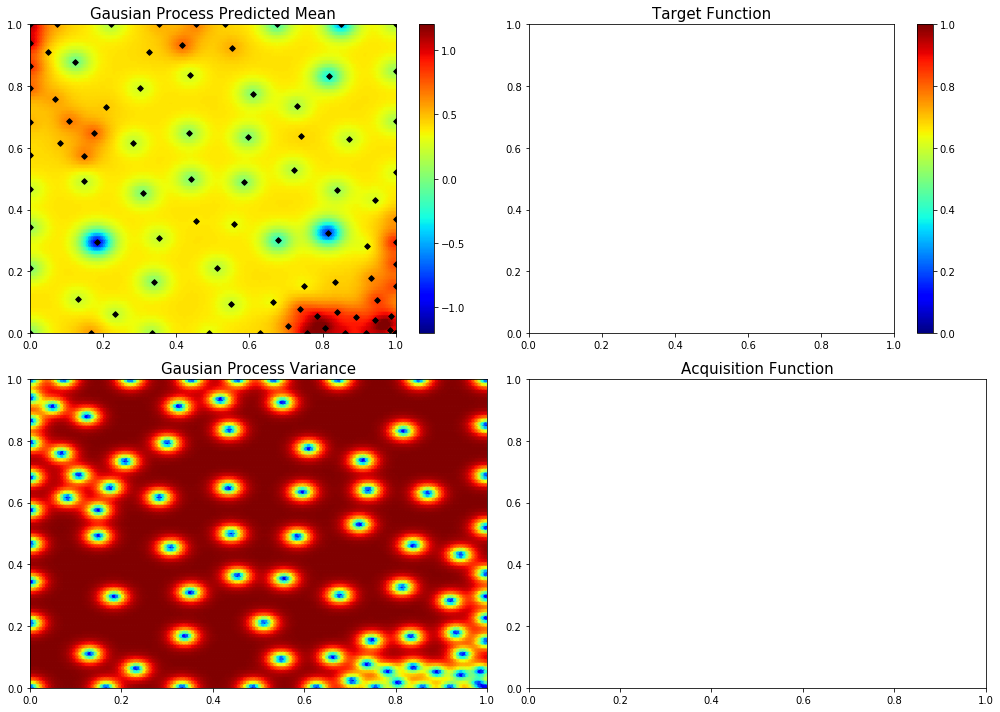

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8862470199235849, 0.6406644822328841]
17  Evaluations Remaining
|  89       | -0.00771  |  0.8862   |  0.6407   |
myplot:  089


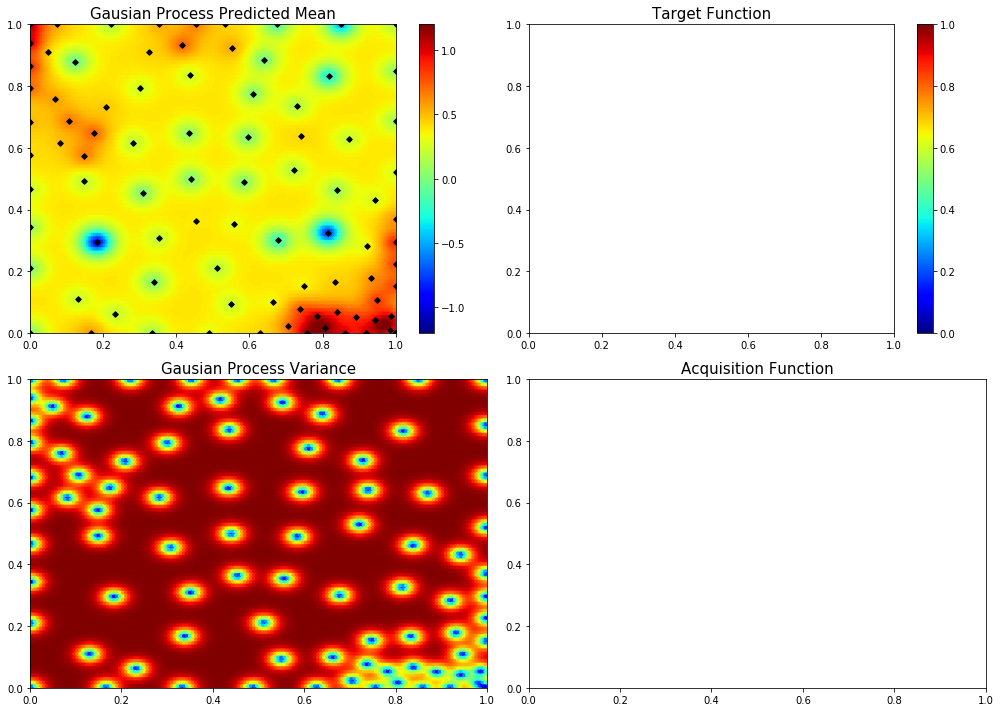

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.09339293777003556, 0.431955298960424]
16  Evaluations Remaining
|  90       |  0.1336   |  0.09339  |  0.432    |
myplot:  090


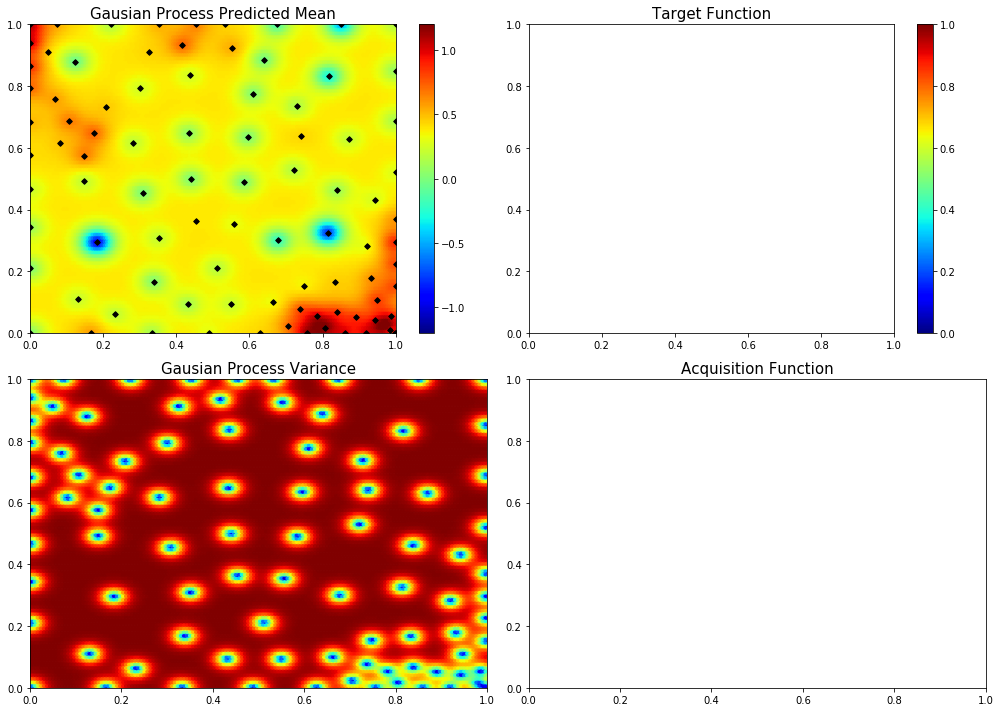

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7458346625303537, 0.49653437605594447]
15  Evaluations Remaining
|  91       |  0.09748  |  0.7458   |  0.4965   |
myplot:  091


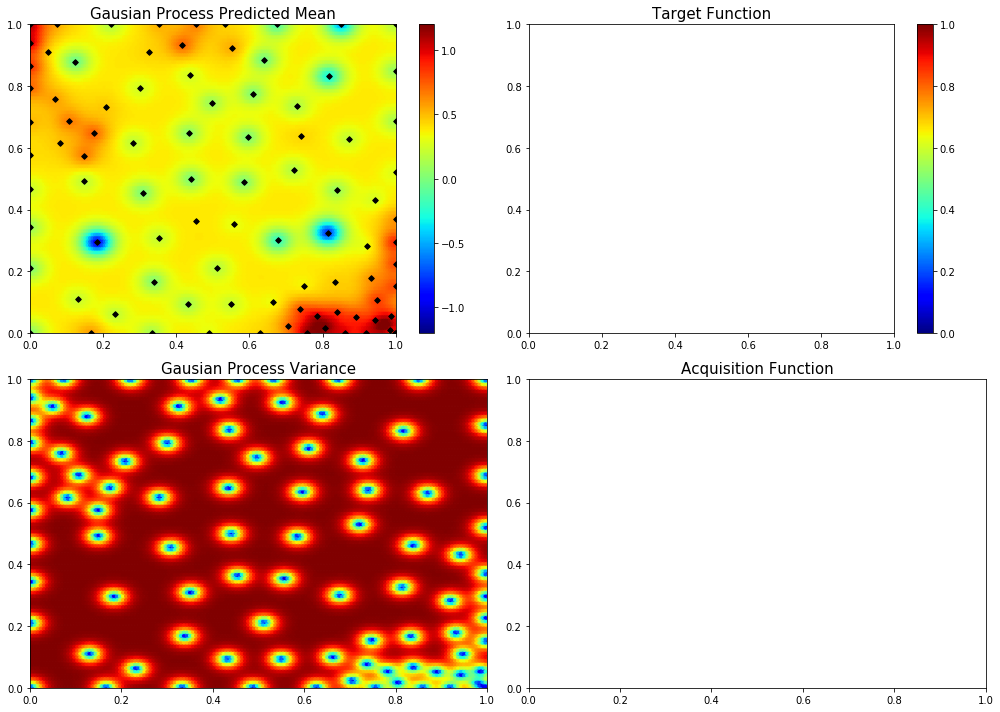

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.9143381337339317, 0.48219363166910034]
14  Evaluations Remaining
|  92       |  0.7779   |  0.9143   |  0.4822   |
myplot:  092


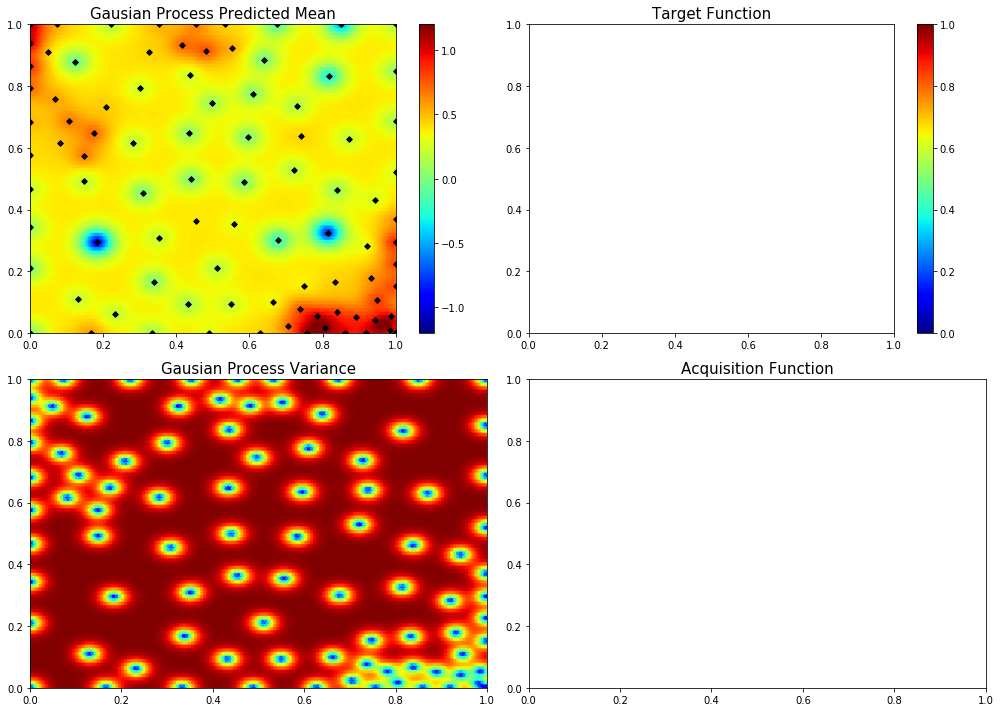

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.743450839145726, 0.9033475667701082]
13  Evaluations Remaining
|  93       |  0.05361  |  0.7435   |  0.9033   |
myplot:  093


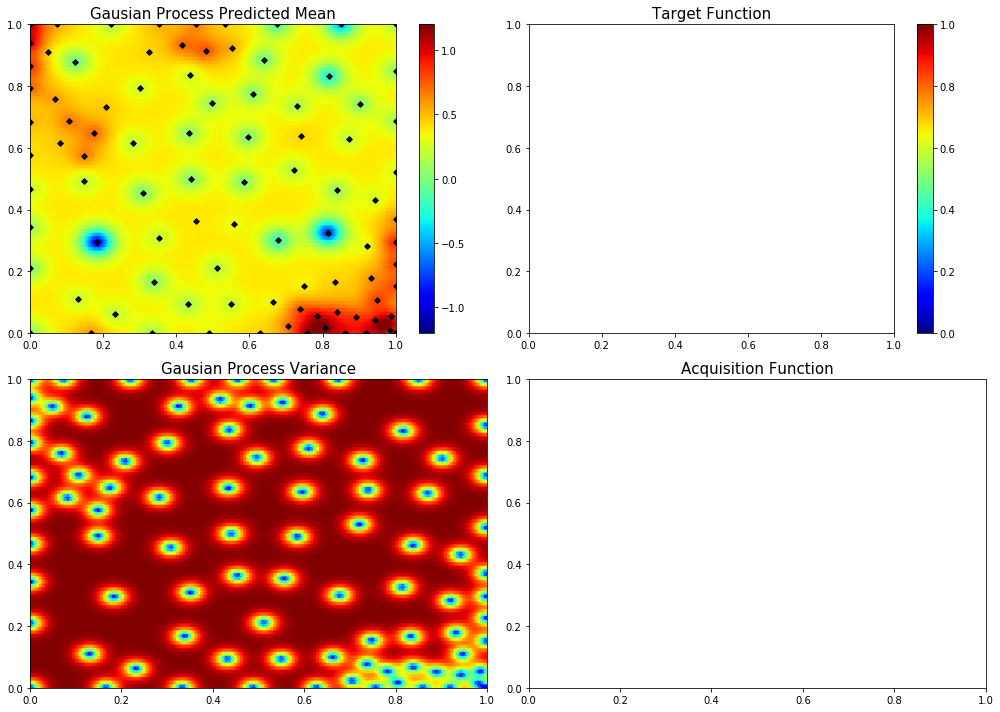

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.4224790917194054, 0.6936034810081056]
12  Evaluations Remaining
|  94       | -0.0495   |  0.4225   |  0.6936   |
myplot:  094


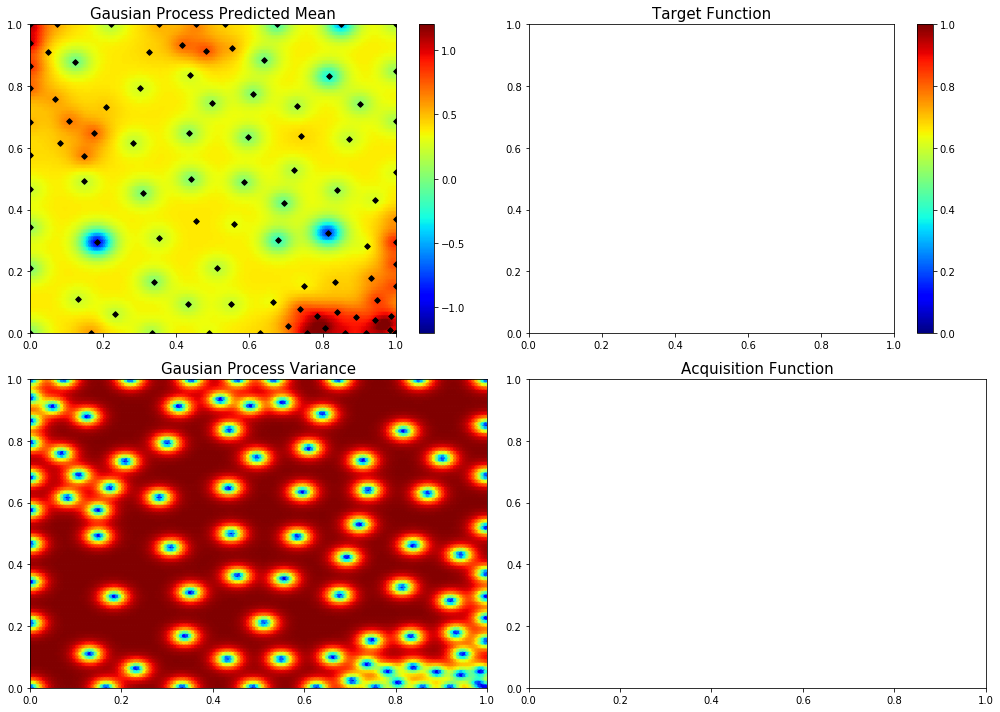

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8774599412276823, 0.2374656917114343]
11  Evaluations Remaining
|  95       |  0.09543  |  0.8775   |  0.2375   |
myplot:  095


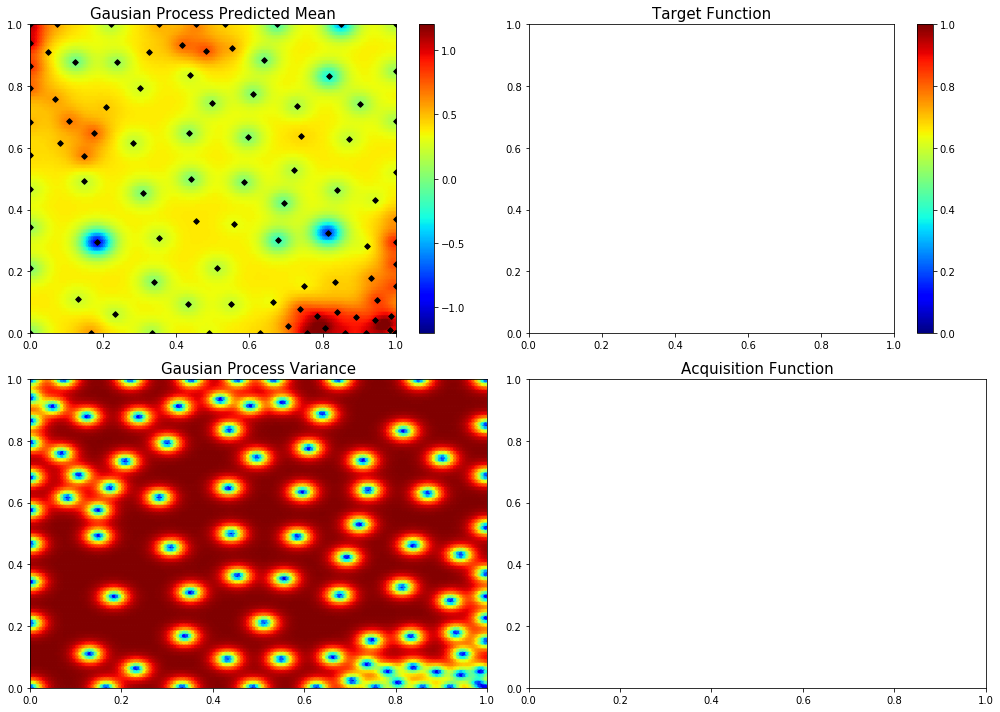

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.19269491325564647, 0.6234169128007689]
10  Evaluations Remaining
|  96       |  0.2112   |  0.1927   |  0.6234   |
myplot:  096


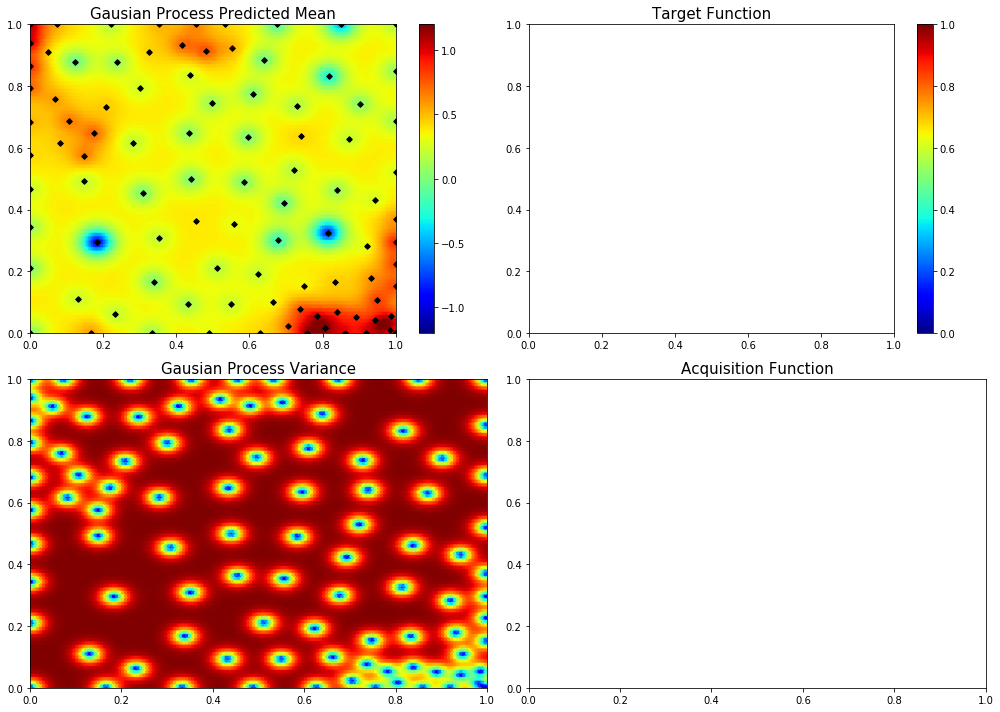

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8484344292764326, 0.5270069679644416]
9  Evaluations Remaining
|  97       |  0.2197   |  0.8484   |  0.527    |
myplot:  097


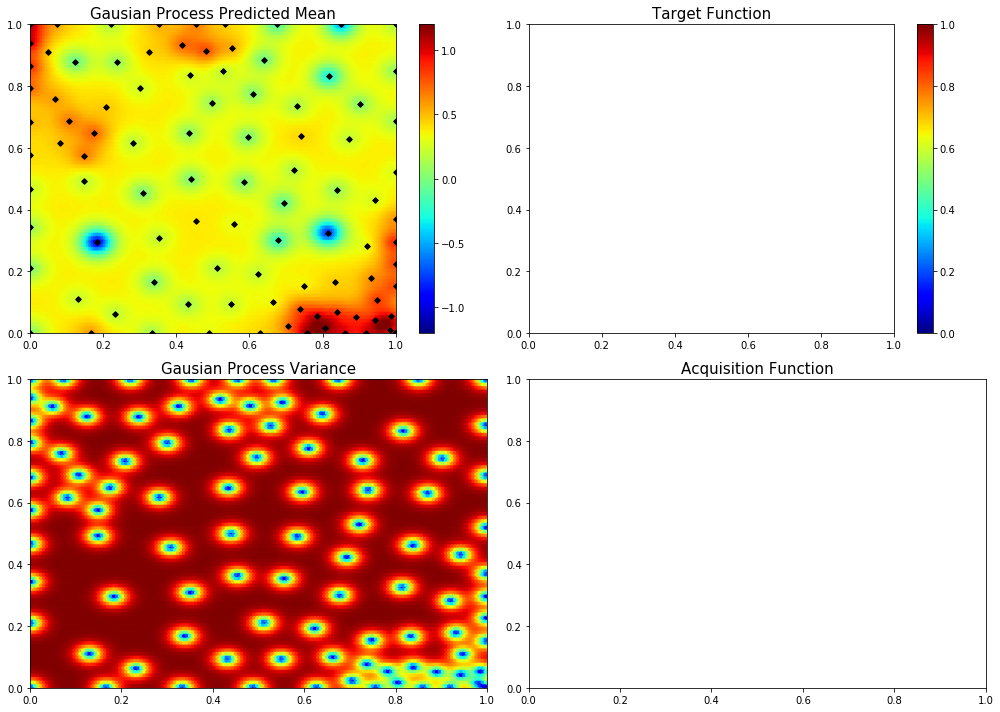

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5442997807431978, 0.2258200652481346]
8  Evaluations Remaining
|  98       |  0.2846   |  0.5443   |  0.2258   |
myplot:  098


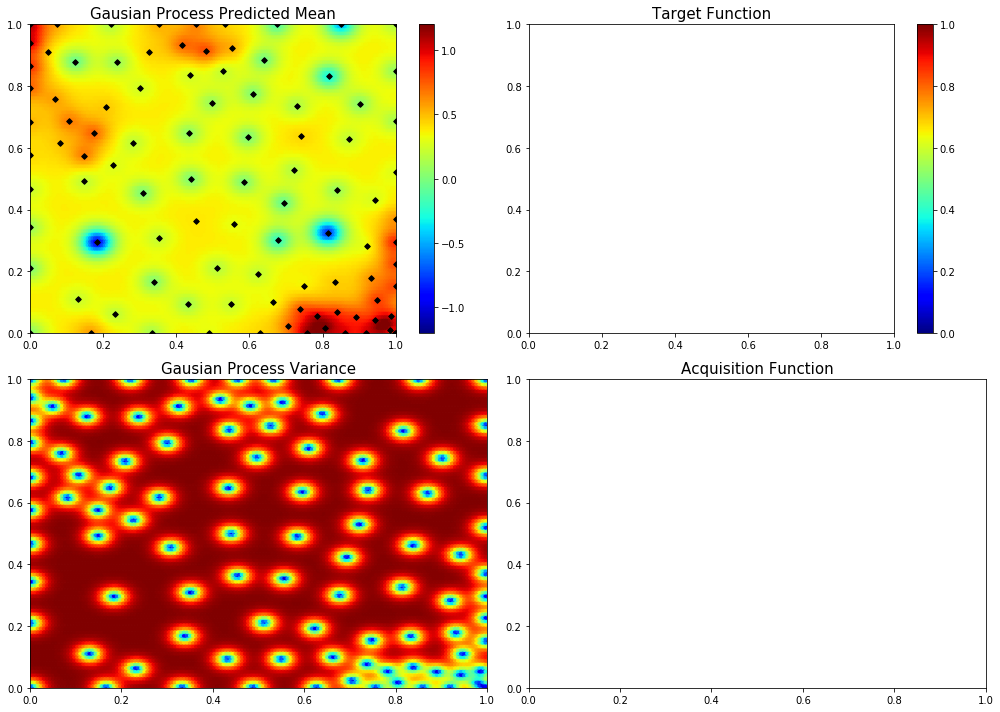

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.40104071674629477, 0.09607126749664087]
7  Evaluations Remaining
|  99       | -0.2289   |  0.401    |  0.09607  |
myplot:  099


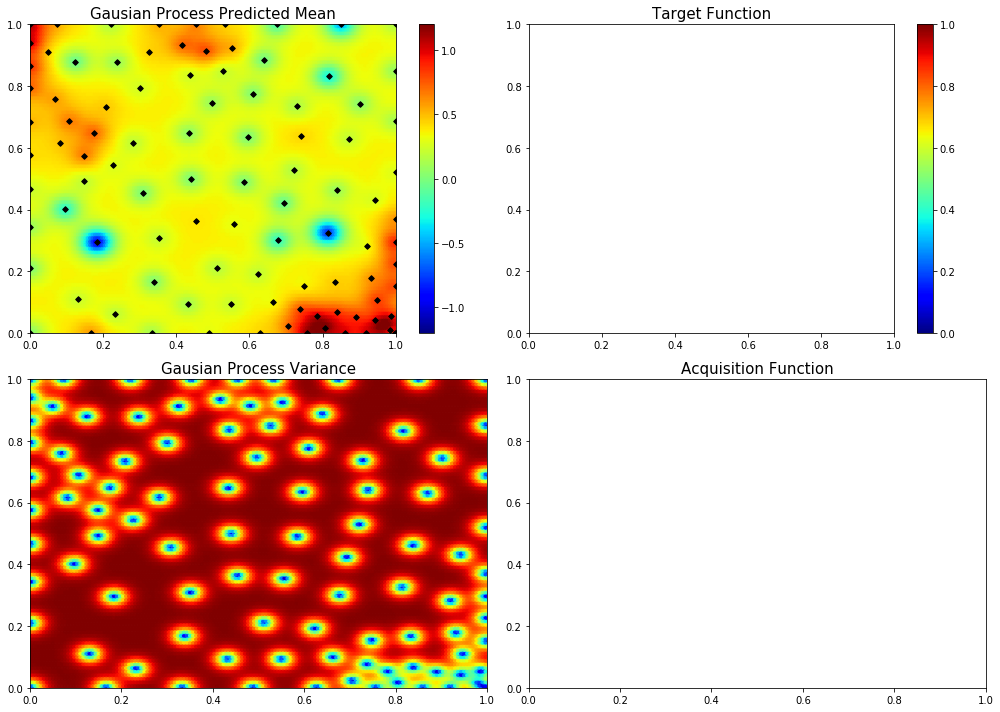

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7055079288227064, 0.3426707464550343]
6  Evaluations Remaining
|  100      |  0.1641   |  0.7055   |  0.3427   |
myplot:  100


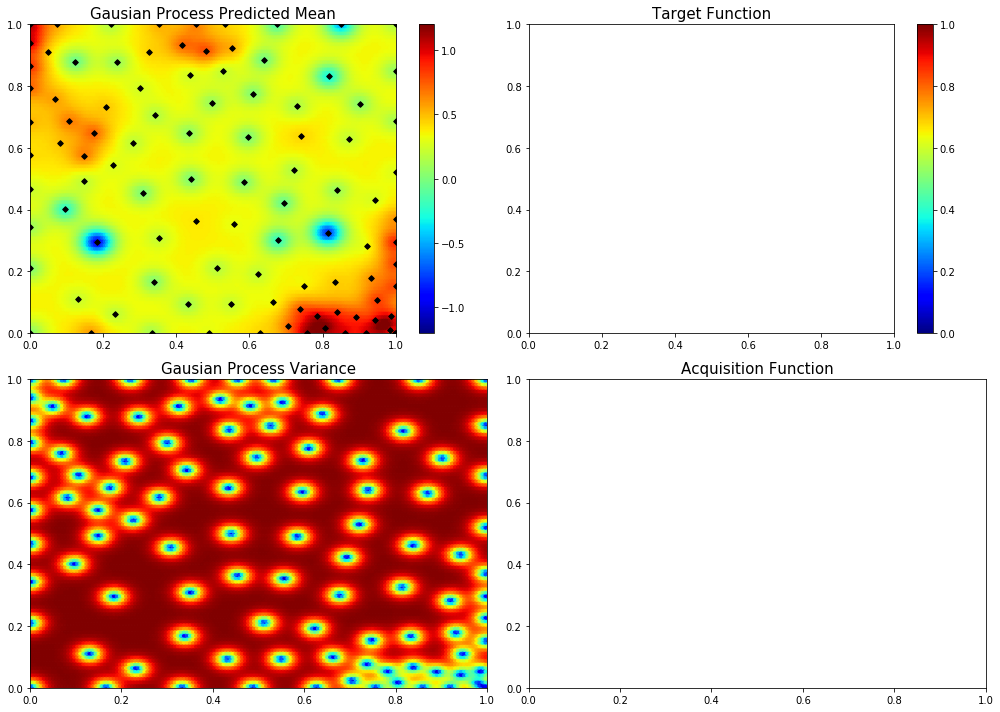

In [14]:
# Turn interactive plotting off
plt.ioff()

for i in range(95):
    bo.maximize(init_points=0, n_iter=1, acq='ucb', kappa=used_kappa)
    print("myplot: ", "{:03}".format(len(bo.space)) )
    plot_2d("{:03}".format(len(bo.space)))